In [1]:
import kastredux
import glob
import os
import numpy
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
import pandas as pd
import copy

import astropy.nddata

import astropy.io.fits as fits
from astropy import units as u
from astropy.visualization import quantity_support

quantity_support()

import specutils
import specutils.fitting

from scipy.interpolate import interp1d
from scipy.integrate import trapz

from splat.utilities import typeToNum

#setting matplotlib parameters
matplotlib.rc('xtick', labelsize=14) 
matplotlib.rc('ytick', labelsize=14) 

In [2]:
import datetime

In [3]:
#set matplotlib global font size
matplotlib.rcParams['font.size']=14

In [4]:
#global strings
line_keyword = 'line'
wave_range_keyword = 'wave_range'
feat_type_keyword = 'feat_type'
name_keyword = 'name'

indices_keyword = 'indices'
continuum_keyword = 'continuum'
feature_keyword = 'feature'
method_keyword = 'method'
sample_keyword = 'sample'
ref_keyword = 'ref'

In [5]:
sp1_path = '/home/ryan/projects/Kast_Reduct/20191208/reduction/kastRED_J0906-0848B_20191208.fits'
sp1 = kastredux.readSpectrum(sp1_path)
sp1.name = fits.getheader(sp1_path)['OBJECT']

sp2_path = '/home/ryan/projects/Kast_Reduct/20191208/reduction/kastRED_J0906-0848A_20191208.fits'
sp2 = kastredux.readSpectrum(sp2_path)
sp2.name = fits.getheader(sp2_path)['OBJECT']

stand1_path = '/home/ryan/code/kastredux/resources/spectral_standards/T50_2MASS0559-1404-burgasser2003.txt'
stand1 = kastredux.readSpectrum(stand1_path)
stand1.name = os.path.basename(os.path.splitext(stand1_path)[0])

stand2_path = '/home/ryan/code/kastredux/resources/spectral_standards/M70_SDSS-bochanski2007.txt'
stand2 = kastredux.readSpectrum(stand2_path)
stand2.name = os.path.basename(os.path.splitext(stand2_path)[0])

stand3_path = '/home/ryan/code/kastredux/resources/spectral_standards/M00_SDSS-bochanski2007.txt'
stand3 = kastredux.readSpectrum(stand3_path)
stand3.name = os.path.basename(os.path.splitext(stand3_path)[0])

In [6]:
#load Kast spectra

file_path = '/home/ryan/projects/KASTr_data/final/'

suffix = '*.fits'

filepaths = glob.glob(file_path + suffix)

SPECTRA = []
for filepath in filepaths:
    
    spectrum = kastredux.readSpectrum(filepath)
    
    spectrum.name = fits.getheader(filepath)['OBJECT']
    
    SPECTRA.append(spectrum)
    
    

In [7]:
#index dict

kastclassify_index_dict = {
'lepine2007':
    
     #leipine (2007)
    
     {'indices': {\
        'CaH3': {'feature': [[6960,6990]],\
                 'continuum': [[7042,7046]],\
                 'method': 'ratio',\
                 'sample': 'average'},\
        'CaH2': {'feature': [[6814, 6846]],\
                 'continuum': [[7042, 7046]],\
                 'method': 'ratio',\
                 'sample': 'average'},\
        'TiO5': {'feature': [[7126,7135]],\
                 'continuum': [[7042,7046]],\
                 'method': 'ratio',\
                 'sample': 'average'}
        }},\
 
 'lepine2003':
    
     #lepine (2003)

    {'indices': {\
        'CaH1': {'feature': [[6380,6390]],\
                 'continuum': [[6410,6420], [6345, 6355]],\
                 'method': 'avdenom',\
                 'sample': 'average'},\
        'CaH2': {'feature': [[6814, 6846]],\
                 'continuum': [[7042, 7046]],\
                 'method': 'ratio',\
                 'sample': 'average'},\
        'CaH3': {'feature': [[6960,6990]],\
                 'continuum': [[7042,7046]],\
                 'method': 'ratio',\
                 'sample': 'average'},\
        'TiO5': {'feature': [[7126,7135]],\
                 'continuum': [[7042,7046]],\
                 'method': 'ratio',\
                 'sample': 'average'},\
        'VO1': {'feature': [[7430, 7470]],\
                 'continuum': [[7550,7570]],\
                 'method': 'ratio',\
                 'sample': 'average'},\
        'TiO6': {'feature': [[7550,7570]],\
                 'continuum': [[7745,7765]],\
                 'method': 'ratio',\
                 'sample': 'average'},\
        'VO2': {'feature': [[7920, 7960]],\
                 'continuum': [[8440, 8470]],\
                 'method': 'ratio',\
                 'sample': 'average'},\
        'TiO7': {'feature': [[8440, 8470]],\
                 'continuum': [[8400, 8420]],\
                 'method': 'ratio',\
                 'sample': 'average'},\
        'Color-M': {'feature': [[8105, 8155]],\
                 'continuum': [[6510, 6560]],\
                 'method': 'ratio',\
                 'sample': 'average'},\
        }},\

 'gizis':
    
    #gizis (1997)

    {'indices': {\
        'TiO5': {'feature': [[7126, 7135]],\
                 'continuum': [[7042, 7046]],\
                 'method': 'ratio',\
                 'sample': 'average'},\
        'CaH1': {'feature': [[6380, 6390]],\
                 'continuum': [[6345, 6355], [6410, 6420]],\
                 'method': 'avdenom',\
                 'sample': 'average'},\
        'CaH2': {'feature': [[6814, 6846]],\
                 'continuum': [[7042, 7046]],\
                 'method': 'ratio',\
                 'sample': 'average'},\
        'CaH3': {'feature': [[6960, 6990]],\
                 'continuum': [[7042, 7046]],\
                 'method': 'ratio',\
                 'sample': 'average'}
        }},\
    
 'reid':
     
    #reid (1995)

    {'indices': {\
        'TiO1': {'feature': [[6718, 6723]],\
                 'continuum': [[6703, 6708]],\
                 'method': 'ratio',\
                 'sample': 'average'},\
        'TiO2': {'feature': [[7058, 7061]],\
                 'continuum': [[7043, 7046]],\
                 'method': 'ratio',\
                 'sample': 'average'},\
        'TiO3': {'feature': [[7092, 7097]],\
                 'continuum': [[7079, 7084]],\
                 'method': 'ratio',\
                 'sample': 'average'},\
        'TiO4': {'feature': [[7130, 7135]],\
                 'continuum': [[7115, 7120]],\
                 'method': 'ratio',
                 'sample': 'average'},\
        'TiO5': {'feature': [[7126, 7135]],\
                 'continuum': [[7042, 7046]],\
                 'method': 'ratio',\
                 'sample': 'average'},\
        'CaH1': {'feature': [[6380, 6390]],\
                 'continuum': [[6345, 6355], [6410, 6420]],\
                 'method': 'avdenom',
                 'sample': 'average'},\
        'CaH2': {'feature': [[6814, 6846]],\
                 'continuum': [[7042, 7046]],\
                 'method': 'ratio',\
                 'sample': 'average'},\
        'CaH3': {'feature': [[6960, 6990]],\
                 'continuum': [[7042, 7046]],\
                 'method': 'ratio',\
                 'sample': 'average'},\
        'CaOH': {'feature': [[6230, 6240]],\
                 'continuum': [[6345, 6354]],\
                 'method': 'ratio',\
                 'sample': 'average'},\
        
        }},\
 
 
 'kirkpatrick':
        
    #kirkpatrick (1999)

    {'indices': {\
        'Rb-a': {'feature': [[7775.2, 7785.2], [7815.2, 7825.2]],\
                 'continuum': [[7795.2, 7805.2]],\
                 'method': 'avnum',\
                 'sample': 'integrate'},\
        'Rb-b': {'feature': [[7922.6, 7932.6], [7962.6, 7972.6]],\
                 'continuum': [[7942.6, 7952.6]],\
                 'method': 'avnum',\
                 'sample': 'integrate'},\
        'Na-a': {'feature': [[8153.3, 8163.3]],\
                 'continuum': [[8178.3, 8188.3]],\
                 'method': 'ratio',\
                 'sample': 'integrate'},\
        'Na-b': {'feature': [[8153.3, 8183.3]],\
                 'continuum': [[8189.8, 8199.8]],\
                 'method': 'ratio',\
                 'sample': 'integrate'},\
        'Cs-a': {'feature': [[8496.1, 8506.1], [8536.1, 8546.1]],\
                 'continuum': [[8516.1, 8526.1]],\
                 'method': 'avnum',\
                 'sample': 'integrate'},\
        'Cs-b': {'feature': [[8918.5, 8928.5], [8958.3, 8968.3]],\
                 'continuum': [[8938.5, 8948.3]],\
                 'method': 'avnum',\
                 'sample': 'integrate'},\
        'TiO-a': {'feature': [[7033.0, 7048.0]],\
                 'continuum': [[7958.0, 7973.0]],\
                 'method': 'ratio',\
                 'sample': 'integrate'},\
        'TiO-b': {'feature': [[8400.0, 8415.0]],\
                 'continuum': [[8435.0, 8470.0]],\
                 'method': 'ratio',\
                 'sample': 'integrate'},\
        'VO-a': {'feature': [[7350.0, 7370.0], [7550.0, 7570.0]],\
                 'continuum': [[7430.0, 7470.0]],\
                 'method': 'sumnum',\
                 'sample': 'integrate'},\
        'VO-b': {'feature': [[7860.0, 7880.0], [8080.0, 8100.0]],\
                 'continuum': [[7960.0, 8000.0]],\
                 'method': 'sumnum',\
                 'sample': 'integrate'},\
        'CrH-a': {'feature': [[8580.0, 8600.0]],\
                 'continuum': [[8621.0, 8641.0]],\
                 'method': 'ratio',\
                 'sample': 'integrate'},\
        'CrH-b': {'feature': [[9940.0, 9960.0]],\
                 'continuum': [[9970.0, 9990.0]],\
                 'method': 'ratio',\
                 'sample': 'integrate'},\
        'FeH-a': {'feature': [[8660.0, 8680.0]],\
                 'continuum': [[8700.0, 8720.0]],\
                 'method': 'ratio',\
                 'sample': 'integrate'},\
        'FeH-b': {'feature': [[9863.0, 9883.0]],\
                 'continuum': [[9908.0, 9928.0]],\
                 'method': 'ratio',\
                 'sample': 'integrate'},\
        'Color-a': {'feature': [[9800.0, 9850.0]],\
                 'continuum': [[7300.0, 7350.0]],\
                 'method': 'ratio',\
                 'sample': 'integrate'},\
        'Color-b': {'feature': [[9800.0, 9850.0]],\
                 'continuum': [[7000.0, 7050.0]],\
                 'method': 'ratio',\
                 'sample': 'integrate'},\
        'Color-c': {'feature': [[9800.0, 9850.0]],\
                 'continuum': [[8100.0, 8150.0]],\
                 'method': 'ratio',\
                 'sample': 'integrate'},\
        'Color-d': {'feature': [[9675.0, 9875.0]],\
                 'continuum': [[7350.0, 7550.0]],\
                 'method': 'ratio',\
                 'sample': 'integrate'},\
        
        }},\
 
 'burgasser':
        
    #burgasser (2003)

    {'indices': {\
        'CsI(A)': {'feature': [[8496.1, 8506.1], [8536.1, 8546.1]],\
                 'continuum': [[8516.1, 8626.1]],\
                 'method': 'sumnum_twicedenom',\
                 'sample': 'average'},\
        'CsI(B)': {'feature': [[8918.5, 8928.5], [8958.3, 8968.3]],\
                 'continuum': [[8938.5, 8948.3]],\
                 'method': 'sumnum_twicedenom',\
                 'sample': 'average'},\
        'H2O': {'feature': [[9220, 9240]],\
                 'continuum': [[9280, 9300]],\
                 'method': 'ratio',\
                 'sample': 'integrate'},\
        'CrH(A)': {'feature': [[8560, 8600]],\
                 'continuum': [[8610, 8650]],\
                 'method': 'ratio',\
                 'sample': 'integrate'},\
        'CrH(B)': {'feature': [[9855, 9885]],\
                 'continuum': [[9970, 10000]],\
                 'method': 'ratio',\
                 'sample': 'integrate'},\
        'FeH(A)': {'feature': [[8560, 8600]],\
                 'continuum': [[8685, 8725]],\
                 'method': 'ratio',\
                 'sample': 'integrate'},\
        'FeH(B)': {'feature': [[9855, 9885]],\
                 'continuum': [[9905, 9935]],\
                 'method': 'ratio',\
                 'sample': 'integrate'},\
        'Color-e': {'feature': [[9140, 9240]],\
                 'continuum': [[8400, 8500]],\
                 'method': 'ratio',\
                 'sample': 'average'},\
        }},\
 
 'martin':
        
    #martin (1999)

    {'indices': {\
        'PC3': {'feature': [[8230, 8270]],\
                 'continuum': [[7540, 7580]],\
                 'method': 'ratio',\
                 'sample': 'integrate'},\
        'PC6': {'feature': [[9090, 9130]],\
                 'continuum': [[6500, 6540]],\
                 'method': 'ratio',\
                 'sample': 'integrate'},\
        'CrH1': {'feature': [[8560, 8600]],\
                 'continuum': [[8610, 8650]],\
                 'method': 'ratio',\
                 'sample': 'integrate'},\
        'CrH2': {'feature': [[9840, 9880]],\
                 'continuum': [[9970, 10010]],\
                 'method': 'ratio',\
                 'sample': 'integrate'},\
        'FeH1': {'feature': [[8560, 8600]],\
                 'continuum': [[8685, 8725]],\
                 'method': 'ratio',\
                 'sample': 'integrate'},\
        'FeH2': {'feature': [[9840, 9880]],\
                 'continuum': [[9900, 9940]],\
                 'method': 'ratio',\
                 'sample': 'integrate'},\
        'H2O1': {'feature': [[9190, 9230]],\
                 'continuum': [[9280, 9320]],\
                 'method': 'ratio',\
                 'sample': 'integrate'},\
        'TiO1': {'feature': [[7000, 7040]],\
                 'continuum': [[7060, 7100]],\
                 'method': 'ratio',\
                 'sample': 'integrate'},\
        'TiO2': {'feature': [[8380, 8420]],\
                 'continuum': [[8440, 8480]],\
                 'method': 'ratio',\
                 'sample': 'integrate'},\
        'VO1': {'feature': [[7540, 7580]],\
                 'continuum': [[7420, 7460]],\
                 'method': 'ratio',\
                 'sample': 'integrate'},\
        'VO2': {'feature': [[7990, 8030]],\
                 'continuum': [[7900, 7940]],\
                 'method': 'ratio',\
                 'sample': 'integrate'},\
        }}
 
 
}
        


In [8]:
#EW info dict
kastclassify_EW_dict = {
    
    'RbIa': {
        'name': 'RbIa',\
        'line': 7800,\
        'wave_range': [7770, 7830],\
        'feat_type': 'absorption'},\
        
    'RbIb': {
        'name': 'RbIb',\
        'line': 7948,\
        'wave_range': [7918, 7978],\
        'feat_type': 'absorption'},\
        
    'NaIa': {
        'name': 'NaIa',\
        'line': 8183,\
        'wave_range': [8153, 8213],\
        'feat_type': 'absorption'},\
        
    'NaIb': {
        'name': 'NaIb',\
        'line': 8195,\
        'wave_range': [8165, 8225],\
        'feat_type': 'absorption'},\
    
    'CsIa': {
        'name': 'CsIa',\
        'line': 8521,\
        'wave_range': [8491, 8551],\
        'feat_type': 'absorption'},\
        
    'CsIb': {
        'name': 'CsIb',\
        'line': 8943,\
        'wave_range': [8913, 8973],\
        'feat_type': 'absorption'},\
    
    'Halpha': {
        'name': 'Halpha',\
        'line': 6563,\
        'wave_range': [6533, 6593],\
        'feat_type': 'emission'},\
        
    'LiI': {
        'name': 'LiI',\
        'line': 6708,\
        'wave_range': [6678, 6738],\
        'feat_type': 'absorption'},\
        
    'KIa': {
        'name': 'KIa',\
        'line': 7665,\
        'wave_range': [7635, 7695],\
        'feat_type': 'absorption'},\
        
    'KIb': {
        'name': 'KIb',\
        'line': 7699,\
        'wave_range': [7669, 7729],\
        'feat_type': 'absorption'},\
        
    'TiIa': {
        'name': 'TiIa',\
        'line': 6573,\
        'wave_range': [6543, 6603],\
        'feat_type': 'absorption'},\
        
    'TiIb': {
        'name': 'TiIb',\
        'line': 8542,\
        'wave_range': [8512, 8572],\
        'feat_type': 'absorption'},\
        
    'CaII': {
        'name': 'CaII',\
        'line': 8436,\
        'wave_range': [8406, 8466],\
        'feat_type': 'absorption'},\
        
    'CaIa': {
        'name': 'CaIa',\
        'line': 7209,\
        'wave_range': [7179, 7239],\
        'feat_type': 'absorption'},\
        
    'CaIb': {
        'name': 'CaIb',\
        'line': 7213,\
        'wave_range': [7183, 7243],\
        'feat_type': 'absorption'},\
        
    'CaIc': {
        'name': 'CaIc',\
        'line': 7326,\
        'wave_range': [7296, 7356],\
        'feat_type': 'absorption'},\
    
}

In [9]:
#chi factor dict

#calibrated chi values from Douglas, 2014 2014ApJ...795..161D for M dwarfs
# from Schmidt, 2014 2014PASP..126..642S for L dwarfs

kastclassify_chi_factor_dict = {
    'M0': {'chi': 6.6453e-5,\
           'chi_err': 0.6207e-5},\
    'M1': {'chi': 6.0334e-5,\
           'chi_err': 0.5326e-5},\
    'M2': {'chi': 5.2658e-5,\
           'chi_err': 0.5963e-5},\
    'M3': {'chi': 4.4872e-5,\
           'chi_err': 0.4967e-5},\
    'M4': {'chi': 3.5926e-5,\
           'chi_err': 0.5297e-5},\
    'M5': {'chi': 2.4768e-5,\
           'chi_err': 0.4860e-5},\
    'M6': {'chi': 1.7365e-5,\
           'chi_err': 0.3475e-5},\
    'M7': {'chi': 1.2057e-5,\
           'chi_err': 0.3267e-5},\
    'M8': {'chi': 0.6122e-5,\
           'chi_err': 0.2053e-5},\
    'M9': {'chi': 0.3522e-5,\
           'chi_err': 0.1432e-5},\
    'L0': {'chi': 1.98e-6,\
           'chi_err': 0.27e-6},\
    'L1': {'chi': 2.25e-6,\
           'chi_err': 0.11e-6},\
    'L2': {'chi': 2.11e-6,\
           'chi_err': 0.36e-6},\
    'L3': {'chi': 1.67e-6,\
           'chi_err': 0.22e-6},\
    'L4': {'chi': 1.16e-6,\
           'chi_err': np.nan},\
    'L5': {'chi': 1.46e-6,\
           'chi_err': 0.28e-6},\
    'L6': {'chi': 1.23e-6,\
           'chi_err': np.nan},\
    'L7': {'chi': 0.73e-6,\
           'chi_err': np.nan},\
}

In [10]:
def spt_from_name(name):
    
    spt = name.split('_')[0]
    
    spt = spt[:-1] + '.' + spt[-1:]
    
    return spt

def classify_by_standard(spec, ref='lepine', plot=False):
    
    lepine_str = 'lepine'
    kirkpatrick_str = 'kirkpatrick'
    burgasser_str = 'burgasser'
    sdss_str = 'SDSS'
    all_str = 'all'
    
    STANDARD_SPECTRA = []
    LEPINE_STANDARDS = []
    KIRKPATRICK_STANDARDS = []
    BURGASSER_STANDARDS = []
    SDSS_STANDARDS = []
    
    STANDARD_PATHS = glob.glob(kastredux.SPTSTDFOLDER + '*.txt')

    
    for path in STANDARD_PATHS:
        name = os.path.basename(os.path.splitext(path)[0])
        stand_spec = kastredux.readSpectrum(path)
        stand_spec.name = name
        
        STANDARD_SPECTRA.append(stand_spec)
        
        if (lepine_str in name):
            LEPINE_STANDARDS.append(stand_spec)
        elif (kirkpatrick_str in name):
            KIRKPATRICK_STANDARDS.append(stand_spec)
        elif (burgasser_str in name):
            BURGASSER_STANDARDS.append(stand_spec)
        elif sdss_str in name:
            SDSS_STANDARDS.append(stand_spec)
            


    
    minimal = 1e90
    minimal_scale = None
    minimal_standard = None
    minimal_standard_name = None
    
    COMPARISON = []
    
    if (ref in lepine_str):
        COMPARISON = LEPINE_STANDARDS
    elif (ref in kirkpatrick_str):
        COMPARISON = KIRKPATRICK_STANDARDS
    elif (ref in burgasser_str):
        COMPARISON = BURGASSER_STANDARDS
    elif ref in sdss_str:
        COMPARISON = SDSS_STANDARDS
    else:
        COMPARISON = STANDARD_SPECTRA
        
    for stand in COMPARISON:
        
        chi2, scalefactor = kastredux.compareSpectra_simple(spec, stand)

        
        if chi2 < minimal:
            minimal = chi2
            minimal_scale = scalefactor
            minimal_standard = stand
            minimal_standard_name = stand.name
            
    if plot:
        placeholder = kastredux.compareSpectra_simple(spec, minimal_standard, plot=True)
     
    spt = spt_from_name(minimal_standard_name)

    return spt, minimal_standard_name, minimal, minimal_scale

def classify_by_template(spec, ref='SDSS', plot=False):
    
    return classify_by_standard(spec, ref=ref, plot=plot)

In [22]:
#functions relating to indices


#measure a single index
def measure_index(waves, fluxes, uncs, continuum_ranges, feature_ranges, method='ratio', sample='integrate', plot=False, name=None):
    
    #number of samples in interpolation
    no_samples = 10000
    
    #creating flux interpolation
    fluxinterp = interp1d(waves, fluxes, bounds_error=False, fill_value=0.)
    uinterp = interp1d(waves, uncs, bounds_error=False, fill_value=0.)
    
    continuum_waves = []
    continuum_fluxes = []
    continuum_uncs = []
    
    #getting the continuum flux
    for continuum_range in continuum_ranges:
            
        min_wavelength = continuum_range[0]
        max_wavelength = continuum_range[1]
            
        #no_divisions = (max_wavelength - min_wavelength) * no_samples
            
        w = numpy.linspace(min_wavelength, max_wavelength, no_samples)
        
        continuum_waves.append(w)
        
        f = fluxinterp(w)
        
        u = uinterp(w)
            
        continuum_flux = f[ (w >= min_wavelength) & (w <= max_wavelength) ]
        
        continuum_unc = u[ (w >= min_wavelength) & (w <= max_wavelength) ]
            
        continuum_fluxes.append(continuum_flux)
        
        continuum_uncs.append(continuum_unc)
    
    #check if there is any flux in the continuum regions
    for continuum_flux, continuum_unc in zip(continuum_fluxes, continuum_uncs):
        
        if np.all(np.abs(continuum_flux) < continuum_unc):
            print('Warning! No flux in continuum region for {}!'.format(name))
            return 'No Flux in Continuum'
    
    feature_waves = []
    feature_fluxes = []
    feature_uncs = []
    
    #getting the feature flux
    for feature_range in feature_ranges:
            
        min_wavelength = feature_range[0]
        max_wavelength = feature_range[1]
            
        #no_divisions = (max_wavelength - min_wavelength) * no_samples
            
        w = numpy.linspace(min_wavelength, max_wavelength, no_samples)
        
        feature_waves.append(w)
        
        f = fluxinterp(w)
        u = uinterp(w)
            
        feature_flux = f[ (w >= min_wavelength) & (w <= max_wavelength) ]
        feature_unc = u[ (w >= min_wavelength) & (w <= max_wavelength) ]
            
        feature_fluxes.append(feature_flux)
        feature_uncs.append(feature_unc)
     
    #check if there is no flux in the feature regions
    for feature_flux, feature_unc in zip(feature_fluxes, feature_uncs):
        
        if np.all( np.abs(feature_flux) < feature_unc):
            print('Warning! No flux in feature region for {}!'.format(name))
            return 'No Flux in Feature'

    #plot the regions
    if plot:
        
        for waves, fluxes in zip(continuum_waves, continuum_fluxes):
            plt.figure(figsize=[12,7])
            plt.plot(waves, fluxes)
            plt.xlabel('Wavelength (Angstrom)')
            plt.ylabel('Flux (erg/(Angstrom cm2 s))')
            plt.title('{} Continuum'.format(name))
            plt.show()
            
        for waves, fluxes in zip(feature_waves, feature_fluxes):
            plt.figure(figsize=[12,7])
            plt.plot(waves, fluxes)
            plt.xlabel('Wavelength (Angstrom)')
            plt.ylabel('Flux (erg/(Angstrom cm2 s))')
            plt.title('{} Feature'.format(name))
            plt.show()
    
    #calculate samples
    continuum_values = []
    feature_values = []
    
    #only average and integrate are implemented
    if 'average' in sample:
        
        for waves, fluxes in zip(continuum_waves, continuum_fluxes):
            
            continuum_value = np.mean(fluxes)
            continuum_values.append(continuum_value)
            
        for waves, fluxes in zip(feature_waves, feature_fluxes):
            
            feature_value = np.mean(fluxes)
            feature_values.append(feature_value)
            
    elif 'integrate' in sample:
        
        for waves, fluxes in zip(continuum_waves, continuum_fluxes):
            
            continuum_value = trapz(fluxes, waves)
            continuum_values.append(continuum_value)
            
        for waves, fluxes in zip(feature_waves, feature_fluxes):
            
            feature_value = trapz(fluxes, waves)
            feature_values.append(feature_value)
    
    elif 'sum' in sample:
        
        for waves, fluxes in zip(continuum_waves, continuum_fluxes):
            
            continuum_value = np.sum(fluxes)
            continuum_values.append(continuum_value)
            
        for waves, fluxes in zip(feature_waves, feature_fluxes):
            
            feature_value = np.sum(fluxes)
            feature_values.append(feature_value)
        
            
    
    #calculate the index
    if 'ratio' in method:
        
        index = feature_values[0] / continuum_values[0]
        
        return index
        
    elif 'sumnum' in method:
        
        numerator = np.sum(feature_values)
        index = numerator / continuum_values[0]
        
        return index
        
    elif 'sumdenom' in method:
        
        denominator = np.sum(continuum_values)
        index = feature_values[0] / denominator
        
        return index
    
    elif 'avnum' in method:
        
        numerator = np.mean(feature_values)
        index = numerator / continuum_values[0]
        
        return index
    
    elif 'avdenom' in method:
        
        denominator = np.mean(continuum_values)
        index = feature_values[0] / denominator
        
        return index
    
    elif 'sumnum_twicedenom' in method:
        
        denominator = 2 * continuum_values[0]
        
        numerator = np.sum(feature_values)
        
        index = numerator / denominator
        
        return index
    
    else:
        return np.nan
            
            

#measure a set of indices from a  reference
def measure_index_set(spec, ref='lepine2007', index_info=None, plot=False, no_trials=1000):
    
    index_info = None
    
    for reference in list(kastclassify_index_dict):
        
        if ref in reference:
            index_info = kastclassify_index_dict[reference]
            
    
    names = list(index_info[indices_keyword])
    
    result = {}
    
    waves = spec.wave.value
    flx = spec.flux.value
    unc = spec.unc.value
    
    for n in names:

        
        #measuring the value here
        
        index = measure_index(waves, flx, unc,\
         index_info[indices_keyword][n][continuum_keyword],\
         index_info[indices_keyword][n][feature_keyword],\
         index_info[indices_keyword][n][method_keyword],\
         index_info[indices_keyword][n][sample_keyword], plot, name=n)
        
        #doing MC here for error
        
        #if we get the no flux string, pass that back as the result
        #and don't do MC
        if isinstance(index, str):
            result[n] = (index, index)
            continue
        
        index_samples = []
        
        
        for i in range(no_trials):
            flxdist = np.random.normal(flx, unc)
            
            index_sample = measure_index(waves, flxdist, unc,\
             index_info[indices_keyword][n][continuum_keyword],\
             index_info[indices_keyword][n][feature_keyword],\
             index_info[indices_keyword][n][method_keyword],\
             index_info[indices_keyword][n][sample_keyword], name=n)
            
            if isinstance(index_sample, str):
                print('Warning! Flux may not be sufficiently above noise level!')
                continue
            
            index_samples.append(index_sample)
            

        err = np.std(index_samples)
        
        result[n] = (index, err)
        
        
    return result


#calculations using indices

#lepine solar TiO5 (Lepine 2007)
def measure_solar_TiO5(index_dict):
    
    
    indices = index_dict
    #unpacking values
    
    CaH3 = indices['CaH3'][0]
    CaH3_err = indices['CaH3'][1]
    
    CaH2 = indices['CaH2'][0]
    CaH2_err = indices['CaH2'][1]
    
    #getting the measurement here
    solar_TiO5_measurement = solar_TiO5(CaH2, CaH3)
    
    #doing MC here
    no_trials = 1000
    
    CaH3_samps = np.random.normal(CaH3, CaH3_err, no_trials)
    
    CaH2_samps = np.random.normal(CaH2, CaH2_err, no_trials)
    
    solar_TiO5_samps = solar_TiO5(CaH2_samps, CaH3_samps)
    

    
    solar_TiO5_err = np.std(solar_TiO5_samps)
    
    return solar_TiO5_measurement, solar_TiO5_err


def measure_lepine_zeta(index_dict):
    
    indices = index_dict
    
    
    #unpacking values
    
    
    TiO5 = indices['TiO5'][0]
    TiO5_err = indices['TiO5'][1]
    
    solar_TiO5, solar_TiO5_err = measure_solar_TiO5(indices)
    
    #getting the measurement
    lepine_zeta_measurement = lepine_zeta(TiO5, solar_TiO5)
    
    #doing MC for error here
    no_trials = 1000
    
    TiO5_samps = np.random.normal(TiO5, TiO5_err, no_trials)
    
    solar_TiO5_samps = np.random.normal(solar_TiO5, solar_TiO5_err, no_trials)
    
    lepine_zeta_samps = lepine_zeta(TiO5_samps, solar_TiO5_samps)
    
    
    lepine_zeta_err = np.std(lepine_zeta_samps)
    
    return lepine_zeta_measurement, lepine_zeta_err
    

def solar_TiO5(CaH2, CaH3):
    
    CaH = CaH2 + CaH3
    
    solar_TiO5 = -0.164 * CaH**3 + 0.670 * CaH**2 - 0.118 * CaH - 0.050
    
    return solar_TiO5

def lepine_zeta(TiO5, solar_TiO5):
    
    zeta = (1 - TiO5)/(1 - solar_TiO5)
    
    return zeta

    
def determine_metallicity_class(zeta):
    
    
    metallicity_class = ''
    
    
    if zeta > 0.825:
        
        metallicity_class = 'Dwarf'
        
    elif ((zeta > 0.500) and (zeta < 0.825)):
        
        metallicity_class = 'sd'
        
    elif ((zeta > 0.200) and (zeta < 0.500)):
        
        metallicity_class = 'esd'
        
    elif zeta < 0.200:
        
        metallicity_class = 'usd'
        
    else:
        metallicity_class = 'Unknown'
          
    return metallicity_class


def classify_by_index(spec, no_trials=100, plot=False):
    
    lepine_indices = measure_index_set(spec, ref='lepine2007', no_trials=no_trials, plot=plot)
    
    gizis_indices = measure_index_set(spec, ref='gizis', no_trials=no_trials, plot=plot)
    
    zeta, zeta_err = measure_lepine_zeta(lepine_indices)
    
    metallicity_class = determine_metallicity_class(zeta)
    
    #gizis typing good for dwarfs
    if metallicity_class == 'Dwarf':
        
        indices = gizis_indices
        
        TiO5_index = indices['TiO5'][0]
        TiO5_err = indices['TiO5'][1]

        CaH2_index = indices['CaH2'][0]
        CaH2_err = indices['CaH2'][1]

        CaH3_index = indices['CaH3'][0]
        CaH3_err = indices['CaH3'][1]

        TiO5_spt, CaH2_spt, CaH3_spt = gizis_spt(TiO5_index, CaH2_index, CaH3_index)

        #doing MC

        TiO5_samps = np.random.normal(TiO5_index, TiO5_err, no_trials)
        CaH2_samps = np.random.normal(CaH2_index, CaH2_err, no_trials)
        CaH3_samps = np.random.normal(CaH3_index, CaH3_err, no_trials)

        TiO5_spt_samps, CaH2_spt_samps, CaH3_spt_samps = gizis_spt(TiO5_samps, CaH2_samps, CaH3_samps)

        TiO5_spt_err = np.std(TiO5_spt_samps)
        CaH2_spt_err = np.std(CaH2_spt_samps)
        CaH3_spt_err = np.std(CaH3_spt_samps)
        
        result = {}
        
        result['gizis_TiO5_spt'] = TiO5_spt
        result['gizis_TiO5_spt_err'] = TiO5_spt_err
        result['gizis_CaH2_spt'] = CaH2_spt
        result['gizis_CaH2_spt_err'] = CaH2_spt_err
        result['gizis_CaH3_spt'] = CaH3_spt
        result['gizis_CaH3_spt_err'] = CaH3_spt_err

        return result, (zeta, zeta_err), metallicity_class
    
    #lepine typing good for all other subdwarfs
    else:
        
        indices = measure_index_set(spec, ref='lepine2007')

        #unpacking values

        CaH3 = indices['CaH3'][0]
        CaH3_err = indices['CaH3'][1]

        CaH2 = indices['CaH2'][0]
        CaH2_err = indices['CaH2'][1]

        #getting the value here
        lepine_spt_measurement = lepine_spt(CaH2, CaH3)

        #doing MC here
        no_trials = 1000

        CaH3_samps = np.random.normal(CaH3, CaH3_err, no_trials)

        CaH2_samps = np.random.normal(CaH2, CaH2_err, no_trials)

        lepine_spt_samps = lepine_spt(CaH2_samps, CaH3_samps)


        lepine_spt_err = np.std(lepine_spt_samps)
        
        result = {}
        
        result['lepine_spt'] = lepine_spt_measurement
        result['lepine_spt_err'] = lepine_spt_err
        
        return result, (zeta, zeta_err), metallicity_class
    
    

def lepine_spt(CaH2, CaH3):
    CaH = CaH2 + CaH3
    
    spt = 1.4 * CaH**2 - 10. * CaH + 12.4
    
    return spt

def gizis_spt(TiO5, CaH2, CaH3):
    
    TiO5_spt = -9.64 * TiO5 + 7.76
    CaH2_spt = 7.91 * CaH2**2 - 20.63 * CaH2 + 10.71
    CaH3_spt = -18. * CaH3 + 15.8
    
    return TiO5_spt, CaH2_spt, CaH3_spt




In [20]:
def measure_EW_simple(waves, fluxes, unc, line, wave_range, feat_type, line_width=[0.,0.], plot=False, file=None, verbose=False, name='Unknown Line'):


    feat_type = feat_type.lower()
    
    #check to see if there's flux
    if np.all(np.abs(fluxes) <= 2 * unc):
            print('Warning! No flux in region for {}!'.format(name))
            
            res = 'No Flux'
            
            return res, res
    
    feature_waves = waves * u.AA
    
    feature_flux = fluxes * u.erg / (u.AA * u.s * (u.cm)**2)
    
    uncertainties = unc
    
    feature_unc = astropy.nddata.StdDevUncertainty( unc * u.erg / (u.AA * u.s * (u.cm)**2))
    
    feature_spec = specutils.Spectrum1D(spectral_axis=feature_waves, flux=feature_flux, uncertainty=feature_unc)
    
    continuum_fit = specutils.fitting.fit_generic_continuum(feature_spec)(feature_spec.spectral_axis)
    

    #looping to refine the continuum fit
    
    #initial mask around the feature
    mask = np.ones(len(feature_flux), dtype='bool')
    mask[ (feature_waves.value > line_width[0]) & (feature_waves.value < line_width[1])] = False
    
    subtr_spec = feature_spec - continuum_fit

    
    for i in range(5):
        
        masked_spec = specutils.Spectrum1D(spectral_axis=feature_waves[mask], flux=feature_flux[mask], uncertainty=feature_unc[mask])
        
        continuum_model = specutils.fitting.fit_generic_continuum(masked_spec)
        continuum_fit = continuum_model(feature_spec.spectral_axis)
        
        subtr_spec = feature_spec - continuum_fit
        
        
        mask = np.abs(subtr_spec.flux.value) < 3 * uncertainties
        
        if verbose:
            plt.plot(feature_waves, continuum_fit)
            plt.plot(feature_waves, feature_spec.flux)
            plt.title('refine {}'.format(i))
            plt.show()
            
     
    continuum_fit = continuum_model(feature_spec.spectral_axis)
    
    subtr_spec = feature_spec - continuum_fit
        
    if plot:
        
        plt.figure(figsize=[12,7])
        
        plt.plot(feature_spec.wavelength, feature_spec.flux)
        plt.plot(feature_spec.wavelength, continuum_fit)
        
        #plt.xlabel('Wavelength')
        #plt.ylabel('Flux Density')
        
        plt.title('Continuum fit of {}'.format(name))
        
        if isinstance(file, str):
            
            plt.savefig('kastclassify_EW_continuum_' + file)
        
        plt.show()
    
    
    #finding line center
    
    near_line_waves = feature_waves[(feature_waves.value >= (line - 10)) & (feature_waves.value <= (line + 10))]
    near_line_fluxes = subtr_spec.flux.value[(feature_waves.value >= (line - 10)) & (feature_waves.value <= (line + 10))]
    

    if feat_type == 'absorption':
        
        line = near_line_waves.value[near_line_fluxes == np.amin(near_line_fluxes)]
        
    elif feat_type == 'emission':
        
        line == near_line_waves.value[near_line_fluxes == np.amax(near_line_fluxes)]
        
    else:
        print('WARNING! Feature type {} is unknown'.format(feat_type))
        
        res = 'Unknown Feature Type'
        
        return res, res
    
    
    
    #create continuum normalized spectrum and continuum subtracted spectrum
    norm_spec = feature_spec / continuum_fit
    
    #re-centering using subtracted spectrum

    
    #find all features in this spectrum
    line_info = specutils.fitting.find_lines_threshold(subtr_spec)

    
    if len(line_info) == 0:
        print('Warning! No features detected for {}!'.format(name))
        
        res = 'No Feature Detected'
        
        return res, res
    
    try:
        #the actual line center is the closest feature to our expected center
        nearest = np.argmin(np.abs(line_info[ line_info['line_type'] == feat_type]['line_center'].value - line))

    except:
        print('Warning! No features detected for {}!'.format(name))

        res = 'No Feature Detected'

        return res, res
        
    line_center = line_info[ line_info['line_type'] == feat_type][nearest]['line_center'].value

    
    
    #if the line width is not defined, calculate it
    #calculated as 1.5 * FWHM
    if line_width[0] == 0.:
        
        
        near_line_waves = feature_waves[(feature_waves.value >= (line - 15)) & (feature_waves.value <= (line + 15))].value
        near_line_fluxes = subtr_spec.flux.value[(feature_waves.value >= (line - 15)) & (feature_waves.value <= (line + 15))]
        
        if feat_type == 'absorption':
            
            near_line_fluxes = np.abs(near_line_fluxes) 
        
        elif feat_type == 'emission':
            
            pass
            
        else:
            print('WARNING! Feature type {} is unknown'.format(feat_type))

            res = 'Unknown Feature Type'

            return res, res
        
        max_flx = np.amax(near_line_fluxes)
        
        half_max = max_flx / 2
        
        outside = near_line_fluxes < half_max
        
        try:
            lower_bound = max( near_line_waves[(near_line_waves < line_center) & outside])
            upper_bound = min( near_line_waves[(near_line_waves > line_center) & outside])
        except:
            print('Warning! No features detected for {}!'.format(name))
        
            res = 'No Feature Detected'

            return res, res
        
        FWHM = upper_bound - lower_bound
        
        line_width[0] = 1.5 * FWHM
        line_width[1] = 1.5 * FWHM
        
    
    
    #pick out the region containing the feature
    region = specutils.SpectralRegion( (line_center - line_width[0]) * u.AA, (line_center + line_width[1]) * u.AA )

    
    #calculate the width
    EW = specutils.analysis.equivalent_width(norm_spec, regions=region)

    
    if plot:
        
        fig, ax = plt.subplots(1, figsize=[12,7])
        
        ax.plot(norm_spec.wavelength, norm_spec.flux, label=EW)
        
        ax.axvline(line_center - line_width[0])
        ax.axvline(line_center + line_width[1])
        
        rect = matplotlib.patches.Rectangle( (line_center - EW.value/2, 0), EW.value, 1, hatch='x', fill=False)
        
        ax.add_patch(rect)
        
        ax.set_xlabel('Wavelength ({})'.format(u.AA))
        ax.set_ylabel('Normalized Flux Density')
        
        ax.set_title('Equivalent Width of {}'.format(name))

        fig.legend()
        
        if isinstance(file, str):
            
            fig.savefig('kastclassify_EW_width_' + file)
            
        fig.show()
        
    return EW, line_center

def measure_EW_element(spec, ref, no_trials=100, plot=False, file=None, verbose=False):
    
    line_info = None
    
    for el in list(kastclassify_EW_dict):
        
        if ref == el:
            
            line_info = kastclassify_EW_dict[el]
            
    
    result = {}
    
    wave = spec.wave.value
    flux = spec.flux.value
    uncs = spec.unc.value
    
    
    no_samples = 10000
    
    finterp = interp1d(wave, flux, bounds_error=False, fill_value=0.)
    uinterp = interp1d(wave, uncs, bounds_error=False, fill_value=0.)
    
    waves = np.linspace(line_info[wave_range_keyword][0], line_info[wave_range_keyword][1], no_samples)
    
    fluxes = finterp(waves)
    unc = uinterp(waves)
    
    
    
    EW_info = measure_EW_simple(waves, fluxes, unc,\
                           line_info[line_keyword], line_info[wave_range_keyword],\
                           line_info[feat_type_keyword], plot=plot, verbose=verbose,\
                           name=line_info[name_keyword], file=file)
    
    if plot:
        plt.pause(1)
    
    EW = EW_info[0]
    line_center = EW_info[1]

    #if we get any error string, pass that back as the result
    #and don't do MC
    if isinstance(EW, str):
        result['EW'] = EW
        result['EW_err'] = EW
        result['line_center'] = EW
        result['line_center_err'] = EW
        return result
    
    #otherwise, break out the value
    else:
        EW = EW.value
    
    #doing MC here
    EW_samples = []
    line_center_samples = []
    for i in range(no_trials):
        
        
        flxdist = np.random.normal(fluxes, unc)
        
        EW_trial = measure_EW_simple(waves, flxdist, unc,\
                           line_info[line_keyword], line_info[wave_range_keyword],\
                           line_info[feat_type_keyword], plot=False, name=line_info[name_keyword])
        
        EW_sample = EW_trial[0].value
        line_center_sample = EW_trial[1]
        
        EW_samples.append(EW_sample)
        line_center_samples.append(line_center_sample)

        
    err_EW = np.std(EW_samples)
    err_line_center = np.std(line_center_samples)
    
    result['EW'] = EW
    result['EW_err'] = err_EW
    result['line_center'] = line_center
    result['line_center_err'] = err_line_center
    
    return result

In [40]:
def calculate_L_Lbol(Halpha_EW, Halpha_EW_err, spt):
    
    chi = 0.
    chi_err = 0.
    
    stype = typeToNum(spt)
    
    #only have to closest type, not closest half type
    #so round down
    stype = int(stype)
    
    for ref in list(kastclassify_chi_factor_dict):

        if typeToNum(ref) == stype:
            chi = kastclassify_chi_factor_dict[ref]['chi']
            chi_err = kastclassify_chi_factor_dict[ref]['chi_err']

    Lratio = chi * Halpha_EW
    Lratio_err = chi_err
    
    return Lratio, Lratio_err

In [41]:
def get_spec_info(filepath, plot=False, no_index_trials=100, no_EW_trials=30):
    
    t1 = datetime.datetime.now()
    
    #collecting header info
    print('Reading in {}'.format(filepath))
    
    spec = kastredux.readSpectrum(filepath)
    spec.name = fits.getheader(filepath)['OBJECT']
    
    ra = fits.getheader(filepath)['RA']
    
    dec = fits.getheader(filepath)['DEC']
    
    date = fits.getheader(filepath)['DATE']
    
    filename = os.path.basename(filepath)
    
    if plot:
        spec.plot()
        plt.show()
    
    print('Classifying by standard comparison...')
    spt, stand_name, spt_chi2, spt_scale = classify_by_standard(spec, ref='all', plot=plot)
    
    print('Done!')
    
    print('Measuring indices...')
    indices = {}
    
    for ref in list(kastclassify_index_dict):
        
        print('Mesuring index set {}...'.format(ref))
        
        indices[ref] = measure_index_set(spec, ref=ref, no_trials = no_index_trials)
        
        print('Done!')
    
    print('Done!')
    
    print('Measuring Equivalent Widths...')
    EWs = {}
    
    for ref in list(kastclassify_EW_dict):
        
        print('Measuring EW for {}...'.format(ref))
        
        EWs[ref] = measure_EW_element(spec, ref=ref, plot=plot, no_trials=no_EW_trials)
        
        print('Done!')
     
    
    print('Done!')
    #calculating with the measurements
    
    print('Calculating spectral types by index...')
    index_spt, zeta_info, metallicity_class = classify_by_index(spec)
    
    print('Done!')
    
    print('Calculating L_Halpha/L_bol...')
    
    Lratio, Lratio_err = calculate_L_Lbol(EWs['Halpha']['EW'], EWs['Halpha']['EW_err'], spt)
    
    print('Done!')
    
    #unpacking results
    
    print('Packaging results...')
    
    results = {}
    
    results['name'] = spec.name
    results['filename'] = filename
    results['RA'] = ra
    results['DEC'] = dec
    results['OBSDATE'] = date
    
    results['spt'] = spt
    results['subtype'] = typeToNum(spt) - 10
    results['spt_chi2'] = spt_chi2
    results['spt_scale'] = spt_scale
    
    
    for ref in list(indices):
        
        for name in list(indices[ref]):
            
            results[ref + '_' + name] = indices[ref][name][0]
            results[ref + '_' + name + '_err'] = indices[ref][name][1]
            
    for ref in list(EWs):
        
        for name in list(EWs[ref]):
            
            results[ref + '_' + name + '_(Angstrom)'] = EWs[ref][name]
            
    for ref in list(index_spt):
        
        results[ref] = index_spt[ref]
        
    results['zeta'] = zeta_info[0]
    
    results['zeta_err'] = zeta_info[1]
    
    results['metallicity_class'] = metallicity_class
    
    results['L_Halpha/L_bol'] = Lratio
    
    results['L_Halpha/L_bol_err'] = Lratio_err
    
    print('Done!')
    
    t2 = datetime.datetime.now()
    dt = t2 - t1
    
    print('All done in {}! All done at {}'.format(dt, t2))
    
    return results

In [14]:
def classify(file_list, outfile, infile=None, no_index_trials=100, no_EW_trials=30, plot=False):
    
    filepaths = copy.deepcopy(file_list)
    
    final_results = pd.DataFrame()
    
    if infile is not None:
        
        final_results = pd.read_csv(infile)
        
        known_filenames = final_results['filename'].values
        
        known_removed = [path for path in filepaths if not any(name in path for name in known_filenames)]
        
        filepaths = known_removed
    
    for filepath in filepaths:
        
        spec_info = get_spec_info(filepath, plot=plot, no_index_trials=no_index_trials, no_EW_trials=no_EW_trials)
        
        s = pd.Series(spec_info)
        
        s = s.fillna('Invalid Data!')
        
        df = s.to_frame().transpose()
        
        final_results = final_results.append(df)
        
        final_results.to_csv(outfile, index=False)
    

In [41]:
classify(filepaths, 'Kastclassify_spectra_calculations_20200602-2.csv', infile='Kastclassify_spectra_calculations_20200602-1.csv')

Reading in /home/ryan/projects/KASTr_data/final/kastRED_J0248-1651_20200110.fits
Classifying by standard comparison...
Done!
Measuring indices...
Mesuring index set lepine2007...
Done!
Mesuring index set lepine2003...
Done!
Mesuring index set gizis...
Done!
Mesuring index set reid...
Done!
Mesuring index set kirkpatrick...
Done!
Mesuring index set burgasser...
Done!
Mesuring index set martin...
Done!
Done!
Measuring Equivalent Widths...
Measuring EW for RbIa...
Done!
Measuring EW for RbIb...
Done!
Measuring EW for NaIa...
Done!
Measuring EW for NaIb...
Done!
Measuring EW for CsIa...
Done!
Measuring EW for CsIb...
Done!
Measuring EW for Halpha...
Done!
Measuring EW for LiI...
Done!
Measuring EW for KIa...
Done!
Measuring EW for KIb...
Done!
Measuring EW for TiIa...
Done!
Measuring EW for TiIb...
Done!
Measuring EW for CaII...
Done!
Measuring EW for CaIa...
Done!
Measuring EW for CaIb...
Done!
Measuring EW for CaIc...
Done!
Done!
Calculating spectral types by index...
Done!
Packaging res

Done!
Measuring EW for LiI...
Done!
Measuring EW for KIa...
Done!
Measuring EW for KIb...
Done!
Measuring EW for TiIa...
Done!
Measuring EW for TiIb...
Done!
Measuring EW for CaII...
Done!
Measuring EW for CaIa...
Done!
Measuring EW for CaIb...
Done!
Measuring EW for CaIc...
Done!
Done!
Calculating spectral types by index...
Done!
Packaging results...
Done!
All done in 0:11:39.289951! All done at 2020-06-02 22:50:18.933217
Reading in /home/ryan/projects/KASTr_data/final/kastRED_J1122+3755_20180121.fits
Classifying by standard comparison...
Done!
Measuring indices...
Mesuring index set lepine2007...
Done!
Mesuring index set lepine2003...
Done!
Mesuring index set gizis...
Done!
Mesuring index set reid...
Done!
Mesuring index set kirkpatrick...
Done!
Mesuring index set burgasser...
Done!
Mesuring index set martin...
Done!
Done!
Measuring Equivalent Widths...
Measuring EW for RbIa...
Done!
Measuring EW for RbIb...
Done!
Measuring EW for NaIa...
Done!
Measuring EW for NaIb...
Done!
Measurin

Done!
Mesuring index set gizis...
Done!
Mesuring index set reid...
Done!
Mesuring index set kirkpatrick...
Done!
Mesuring index set burgasser...
Done!
Mesuring index set martin...
Done!
Done!
Measuring Equivalent Widths...
Measuring EW for RbIa...
Done!
Measuring EW for RbIb...
Done!
Measuring EW for NaIa...
Done!
Measuring EW for NaIb...
Done!
Measuring EW for CsIa...
Done!
Measuring EW for CsIb...
Done!
Measuring EW for Halpha...
Done!
Measuring EW for LiI...
Done!
Measuring EW for KIa...
Done!
Measuring EW for KIb...
Done!
Measuring EW for TiIa...
Done!
Measuring EW for TiIb...
Done!
Measuring EW for CaII...
Done!
Measuring EW for CaIa...
Done!
Measuring EW for CaIb...
Done!
Measuring EW for CaIc...
Done!
Done!
Calculating spectral types by index...
Done!
Packaging results...
Done!
All done in 0:12:05.616989! All done at 2020-06-03 00:24:28.803917
Reading in /home/ryan/projects/KASTr_data/final/kastRED_J0721+3714_20180307.fits
Classifying by standard comparison...
Done!
Measuring in

Done!
Measuring EW for CaII...
Done!
Measuring EW for CaIa...
Done!
Measuring EW for CaIb...
Done!
Measuring EW for CaIc...
Done!
Done!
Calculating spectral types by index...
Done!
Packaging results...
Done!
All done in 0:12:12.519341! All done at 2020-06-03 01:47:55.925145
Reading in /home/ryan/projects/KASTr_data/final/kastRED_J0300-0746_20170823.fits
Classifying by standard comparison...
Done!
Measuring indices...
Mesuring index set lepine2007...
Done!
Mesuring index set lepine2003...
Done!
Mesuring index set gizis...
Done!
Mesuring index set reid...
Done!
Mesuring index set kirkpatrick...
Done!
Mesuring index set burgasser...
Done!
Mesuring index set martin...
Done!
Done!
Measuring Equivalent Widths...
Measuring EW for RbIa...
Done!
Measuring EW for RbIb...
Done!
Measuring EW for NaIa...
Done!
Measuring EW for NaIb...
Done!
Measuring EW for CsIa...
Done!
Measuring EW for CsIb...
Done!
Measuring EW for Halpha...
Done!
Measuring EW for LiI...
Done!
Measuring EW for KIa...
Done!
Measu

Done!
Mesuring index set martin...
Done!
Done!
Measuring Equivalent Widths...
Measuring EW for RbIa...
Done!
Measuring EW for RbIb...
Done!
Measuring EW for NaIa...
Done!
Measuring EW for NaIb...
Done!
Measuring EW for CsIa...
Done!
Measuring EW for CsIb...
Done!
Measuring EW for Halpha...
Done!
Measuring EW for LiI...
Done!
Measuring EW for KIa...
Done!
Measuring EW for KIb...
Done!
Measuring EW for TiIa...
Done!
Measuring EW for TiIb...
Done!
Measuring EW for CaII...
Done!
Measuring EW for CaIa...
Done!
Measuring EW for CaIb...
Done!
Measuring EW for CaIc...
Done!
Done!
Calculating spectral types by index...
Done!
Packaging results...
Done!
All done in 0:11:10.249250! All done at 2020-06-03 03:20:40.990023


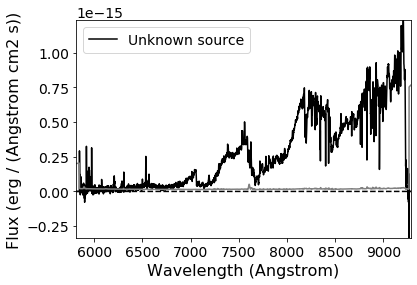

In [38]:
sp.plot()

In [40]:
sp_path = '/home/ryan/projects/KASTr_data/final/kastRED_J0248-1651_20200110.fits'

sp = kastredux.readSpectrum(sp_path)

measure_index_set(sp, ref='reid')

Warning! No flux in feature region for TiO1!
Warning! No flux in feature region for CaOH!
Warning! No flux in feature region for CaOH!
Warning! No flux in feature region for CaOH!
Warning! No flux in feature region for CaOH!


{'TiO1': (0.8429821746281622, 0.3166654162895865),
 'TiO2': (0.6759542522303349, 0.07068954160820122),
 'TiO3': (0.6915506260237708, 0.1410950795926354),
 'TiO4': (0.7615984323137811, 0.16487921765365549),
 'TiO5': (0.3414857107032997, 0.039251832467290186),
 'CaH1': (0.9249090245580267, 0.21528468765730557),
 'CaH2': (0.2963228222374685, 0.025325747292786815),
 'CaH3': (0.6315768488913462, 0.03947370929976793),
 'CaOH': (0.39782948245115324, 0.2651665110132311)}

In [29]:
upper = 50
lower = 7

try:
    result = upper - lower
    
except:
    print('teh')
    
result * 3

129

In [73]:
test_filepaths

['/home/ryan/projects/KASTr_data/final/kastRED_J0225+6229_20200203.fits',
 '/home/ryan/projects/KASTr_data/final/kastRED_J1300+3038_20200305.fits',
 '/home/ryan/projects/KASTr_data/final/kastRED_J1733+1655_20180717.fits',
 '/home/ryan/projects/KASTr_data/final/kastRED_J0813-1522_20200204.fits',
 '/home/ryan/projects/KASTr_data/final/kastRED_J1102-1624_20200311.fits',
 '/home/ryan/projects/KASTr_data/final/kastRED_SN2018GV_20180121.fits',
 '/home/ryan/projects/KASTr_data/final/kastRED_J1546+3749_20180716.fits',
 '/home/ryan/projects/KASTr_data/final/kastRED_J0347+0417_20180308.fits',
 '/home/ryan/projects/KASTr_data/final/kastRED_J1705-0226B_20180622.fits',
 '/home/ryan/projects/KASTr_data/final/kastRED_J0129-0823_20170813.fits',
 '/home/ryan/projects/KASTr_data/final/kastRED_J1054+1214_20200303.fits',
 '/home/ryan/projects/KASTr_data/final/kastRED_J1430+0858_20200206.fits',
 '/home/ryan/projects/KASTr_data/final/kastRED_J1615+0546_20200304.fits',
 '/home/ryan/projects/KASTr_data/final/

In [ ]:
        known_filenames = final_results['filename'].values
        
        for filename in known_filenames:
            
            filepaths = filepaths[ filepaths != filename ]

In [89]:
test_filepaths = copy.deepcopy(filepaths)

len(test_filepaths)

176

In [93]:
filtered = [path for path in test_filepaths if not any(name in path for name in known_filenames)]

filtered

['/home/ryan/projects/KASTr_data/final/kastRED_J0225+6229_20200203.fits',
 '/home/ryan/projects/KASTr_data/final/kastRED_J1300+3038_20200305.fits',
 '/home/ryan/projects/KASTr_data/final/kastRED_J0539+4352_20200110.fits',
 '/home/ryan/projects/KASTr_data/final/kastRED_J0522+5724_20200206.fits',
 '/home/ryan/projects/KASTr_data/final/kastRED_J1637+3535_20170817.fits',
 '/home/ryan/projects/KASTr_data/final/kastRED_J0848-2019_20200203.fits',
 '/home/ryan/projects/KASTr_data/final/kastRED_J1705+1801_20170824.fits',
 '/home/ryan/projects/KASTr_data/final/kastRED_J1448+1554_20180717.fits',
 '/home/ryan/projects/KASTr_data/final/kastRED_J1444+3002_20180622.fits',
 '/home/ryan/projects/KASTr_data/final/kastRED_J1741+0940_20200305.fits',
 '/home/ryan/projects/KASTr_data/final/kastRED_J1726+7331_20180716.fits',
 '/home/ryan/projects/KASTr_data/final/kastRED_J0540+6417_20200304.fits',
 '/home/ryan/projects/KASTr_data/final/kastRED_J1314+6622_20200205.fits',
 '/home/ryan/projects/KASTr_data/final

In [94]:
known_filenames

array(['kastRED_J1733+1655_20180717.fits',
       'kastRED_J0813-1522_20200204.fits',
       'kastRED_J1102-1624_20200311.fits',
       'kastRED_SN2018GV_20180121.fits',
       'kastRED_J1546+3749_20180716.fits',
       'kastRED_J0347+0417_20180308.fits',
       'kastRED_J1705-0226B_20180622.fits',
       'kastRED_J0129-0823_20170813.fits',
       'kastRED_J1054+1214_20200303.fits',
       'kastRED_J1430+0858_20200206.fits',
       'kastRED_J1615+0546_20200304.fits',
       'kastRED_J1128+0141_20200304.fits',
       'kastRED_J2126-0431SE_20170823.fits',
       'kastRED_J1718+6802_20180622.fits',
       'kastRED_J0720-0846_20200311.fits',
       'kastRED_J0602-1001_20200303.fits',
       'kastRED_HD95868_20180121.fits',
       'kastRED_J1755+3958B_20170813.fits',
       'kastRED_J0428+0728_20180307.fits',
       'kastRED_J0929+2558_20180121.fits',
       'kastRED_J1757+2452_20170822.fits',
       'kastRED_J1953+4424B_20180717.fits',
       'kastRED_J1735+2634_20170813.fits',
       'kas

In [75]:
df = pd.read_csv('Kastclassify_spectra_calculations_20200531.csv')

known_filenames = df['filename'].values

test_filepaths = copy.deepcopy(filepaths)

len(test_filepaths)

for filename in known_filenames:
    
    test_filepaths = test_filepaths[ test_filepaths != filename ]
    known_filenames = known_filenames[ known_filenames != filename ]

IndexError: string index out of range

In [20]:
sp_path = '/home/ryan/projects/KASTr_data/final/kastRED_J0539+4352_20200110.fits'
sp = kastredux.readSpectrum(sp_path)

sp.unc.value[ (sp.wave.value > 8910) & (sp.wave.value < 8970)]

array([3.04769762e-17, 3.03725674e-17, 3.07665290e-17, 3.24389501e-17,
       3.44059779e-17, 3.52227732e-17, 3.52805068e-17, 3.37006292e-17,
       3.17523589e-17, 3.09600587e-17, 3.05791074e-17, 3.02601792e-17,
       2.99697694e-17, 2.99084860e-17, 2.98758685e-17, 3.00819070e-17,
       3.02620379e-17, 3.03049822e-17, 3.05278589e-17, 3.06011500e-17,
       3.05226511e-17, 3.05899613e-17, 3.09783153e-17, 3.15389219e-17,
       3.17609376e-17, 3.15765581e-17, 3.08425704e-17, 3.00706448e-17,
       2.97535580e-17, 2.98916266e-17, 2.96151185e-17, 2.95406693e-17,
       2.91828279e-17, 2.97618466e-17, 3.15885289e-17, 3.29431282e-17,
       3.38449477e-17, 3.33131817e-17, 3.14855798e-17, 2.98276434e-17,
       2.86394913e-17, 2.81068421e-17, 2.83176646e-17, 2.88130363e-17,
       2.91411319e-17, 2.90285953e-17, 2.87011207e-17, 2.83773899e-17])

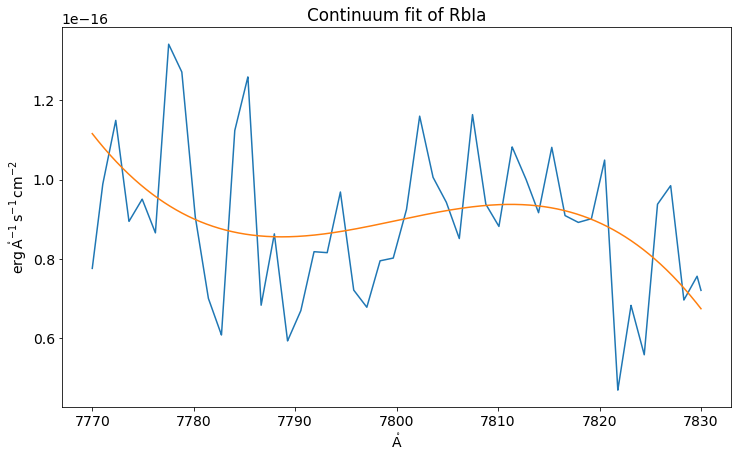

ValueError: max() arg is an empty sequence

In [23]:
measure_EW_element(sp, 'RbIa', plot=True)

In [65]:
[os.path.basename(filepath) for filepath in filepaths]

['kastRED_J0225+6229_20200203.fits',
 'kastRED_J1300+3038_20200305.fits',
 'kastRED_J1733+1655_20180717.fits',
 'kastRED_J0813-1522_20200204.fits',
 'kastRED_J1102-1624_20200311.fits',
 'kastRED_SN2018GV_20180121.fits',
 'kastRED_J1546+3749_20180716.fits',
 'kastRED_J0347+0417_20180308.fits',
 'kastRED_J1705-0226B_20180622.fits',
 'kastRED_J0129-0823_20170813.fits',
 'kastRED_J1054+1214_20200303.fits',
 'kastRED_J1430+0858_20200206.fits',
 'kastRED_J1615+0546_20200304.fits',
 'kastRED_J1128+0141_20200304.fits',
 'kastRED_J2126-0431SE_20170823.fits',
 'kastRED_J1718+6802_20180622.fits',
 'kastRED_J0720-0846_20200311.fits',
 'kastRED_J0602-1001_20200303.fits',
 'kastRED_HD95868_20180121.fits',
 'kastRED_J1755+3958B_20170813.fits',
 'kastRED_J0428+0728_20180307.fits',
 'kastRED_J0929+2558_20180121.fits',
 'kastRED_J1757+2452_20170822.fits',
 'kastRED_J1953+4424B_20180717.fits',
 'kastRED_J1735+2634_20170813.fits',
 'kastRED_J2350+0806_20180717.fits',
 'kastRED_J1715-1515_20200311.fits',
 

In [15]:
filepaths[:10]

['/home/ryan/projects/KASTr_data/final/kastRED_J0225+6229_20200203.fits',
 '/home/ryan/projects/KASTr_data/final/kastRED_J1300+3038_20200305.fits',
 '/home/ryan/projects/KASTr_data/final/kastRED_J0813-1522_20200204.fits',
 '/home/ryan/projects/KASTr_data/final/kastRED_J1102-1624_20200311.fits',
 '/home/ryan/projects/KASTr_data/final/kastRED_J1054+1214_20200303.fits',
 '/home/ryan/projects/KASTr_data/final/kastRED_J1430+0858_20200206.fits',
 '/home/ryan/projects/KASTr_data/final/kastRED_J1615+0546_20200304.fits',
 '/home/ryan/projects/KASTr_data/final/kastRED_J1128+0141_20200304.fits',
 '/home/ryan/projects/KASTr_data/final/kastRED_J0720-0846_20200311.fits',
 '/home/ryan/projects/KASTr_data/final/kastRED_J0602-1001_20200303.fits']

In [30]:
final_results = pd.DataFrame()

for filepath in filepaths:
    
    spec_info = get_spec_info(filepath, plot=False)
    
    s = pd.Series(spec_info)
    df = s.to_frame().transpose()
    
    final_results = final_results.append(df)
    
    final_results.to_csv('Kast_spectrum_data.csv', index=False)

Reading in /home/ryan/projects/KASTr_data/final/kastRED_J0225+6229_20200203.fits
Classifying by standard comparison...
Done!
Measuring indices...
Mesuring index set lepine2007...
Done!
Mesuring index set lepine2003...
Warning! No flux in continuum region for CaH1!
Done!
Mesuring index set gizis...
Warning! No flux in continuum region for CaH1!
Done!
Mesuring index set reid...
Warning! No flux in continuum region for CaH1!
Warning! No flux in continuum region for CaOH!
Done!
Mesuring index set kirkpatrick...
Warning! No flux in continuum region for CrH-b!
Done!
Mesuring index set burgasser...
Warning! No flux in continuum region for CrH(B)!
Done!
Mesuring index set martin...
Warning! No flux in continuum region for CrH2!
Done!
Done!
Measuring Equivalent Widths...
Measuring EW for RbI...
Done!
Measuring EW for Halpha...
Done!
Done!
Calculating spectral types by index...
Warning! No flux in continuum region for CaH1!
Done!
Packaging results...
Done!
All done in 0:05:24.913692! All done at

Done!
Done!
Calculating spectral types by index...
Done!
Packaging results...
Done!
All done in 0:08:12.687288! All done at 2020-05-28 11:11:41.794328
Reading in /home/ryan/projects/KASTr_data/final/kastRED_J1128+0141_20200304.fits
Classifying by standard comparison...
Done!
Measuring indices...
Mesuring index set lepine2007...
Done!
Mesuring index set lepine2003...
Done!
Mesuring index set gizis...
Done!
Mesuring index set reid...
Done!
Mesuring index set kirkpatrick...
Warning! No flux in continuum region for CrH-b!
Warning! No flux in continuum region for FeH-b!
Warning! No flux in feature region for Color-a!
Warning! No flux in feature region for Color-b!
Warning! No flux in feature region for Color-c!
Warning! No flux in feature region for Color-d!
Done!
Mesuring index set burgasser...
Warning! No flux in continuum region for H2O!
Warning! No flux in continuum region for CrH(B)!
Warning! No flux in continuum region for FeH(B)!
Done!
Mesuring index set martin...
Warning! No flux in

Done!
Done!
Measuring Equivalent Widths...
Measuring EW for RbI...
Done!
Measuring EW for Halpha...
Done!
Done!
Calculating spectral types by index...
Done!
Packaging results...
Done!
All done in 0:04:37.654029! All done at 2020-05-28 12:00:46.209669
Reading in /home/ryan/projects/KASTr_data/final/kastRED_J0420-1458_20200206.fits
Classifying by standard comparison...
Done!
Measuring indices...
Mesuring index set lepine2007...
Done!
Mesuring index set lepine2003...
Done!
Mesuring index set gizis...
Done!
Mesuring index set reid...
Done!
Mesuring index set kirkpatrick...
Warning! No flux in continuum region for CrH-b!
Warning! No flux in continuum region for FeH-b!
Warning! No flux in feature region for Color-a!
Warning! No flux in feature region for Color-b!
Warning! No flux in feature region for Color-c!
Warning! No flux in feature region for Color-d!
Done!
Mesuring index set burgasser...
Warning! No flux in continuum region for H2O!
Warning! No flux in continuum region for CrH(B)!
War

Warning! No flux in continuum region for H2O!
Warning! No flux in continuum region for CrH(B)!
Warning! No flux in continuum region for FeH(B)!
Done!
Mesuring index set martin...
Warning! No flux in continuum region for CrH2!
Warning! No flux in continuum region for FeH2!
Warning! No flux in continuum region for H2O1!
Done!
Done!
Measuring Equivalent Widths...
Measuring EW for RbI...
Done!
Measuring EW for Halpha...
Done!
Done!
Calculating spectral types by index...
Done!
Packaging results...
Done!
All done in 0:06:18.460492! All done at 2020-05-28 12:37:36.228940
Reading in /home/ryan/projects/KASTr_data/final/kastRED_J0833+3706_20200205.fits
Classifying by standard comparison...
Done!
Measuring indices...
Mesuring index set lepine2007...
Done!
Mesuring index set lepine2003...
Done!
Mesuring index set gizis...
Done!
Mesuring index set reid...
Done!
Mesuring index set kirkpatrick...
Warning! No flux in continuum region for CrH-b!
Warning! No flux in continuum region for FeH-b!
Warning!

Done!
Mesuring index set reid...
Warning! No flux in continuum region for CaH1!
Warning! No flux in continuum region for CaOH!
Done!
Mesuring index set kirkpatrick...
Warning! No flux in continuum region for CrH-b!
Done!
Mesuring index set burgasser...
Warning! No flux in continuum region for CrH(B)!
Done!
Mesuring index set martin...
Warning! No flux in continuum region for CrH2!
Done!
Done!
Measuring Equivalent Widths...
Measuring EW for RbI...
Done!
Measuring EW for Halpha...
Done!
Done!
Calculating spectral types by index...
Warning! No flux in continuum region for CaH1!
Done!
Packaging results...
Done!
All done in 0:07:18.863064! All done at 2020-05-28 13:27:53.610366
Reading in /home/ryan/projects/KASTr_data/final/kastRED_J1341+0805_20200204.fits
Classifying by standard comparison...
Done!
Measuring indices...
Mesuring index set lepine2007...
Done!
Mesuring index set lepine2003...
Done!
Mesuring index set gizis...
Done!
Mesuring index set reid...
Done!
Mesuring index set kirkpatr

Warning! No flux in continuum region for H2O!
Warning! No flux in continuum region for CrH(B)!
Warning! No flux in continuum region for FeH(B)!
Done!
Mesuring index set martin...
Warning! No flux in continuum region for CrH2!
Warning! No flux in continuum region for FeH2!
Warning! No flux in continuum region for H2O1!
Done!
Done!
Measuring Equivalent Widths...
Measuring EW for RbI...
Done!
Measuring EW for Halpha...
Done!
Done!
Calculating spectral types by index...
Done!
Packaging results...
Done!
All done in 0:05:04.676676! All done at 2020-05-28 14:09:42.284444
Reading in /home/ryan/projects/KASTr_data/final/kastRED_J0539+4712_20200206.fits
Classifying by standard comparison...
Done!
Measuring indices...
Mesuring index set lepine2007...
Done!
Mesuring index set lepine2003...
Done!
Mesuring index set gizis...
Done!
Mesuring index set reid...
Done!
Mesuring index set kirkpatrick...
Warning! No flux in continuum region for CrH-b!
Warning! No flux in continuum region for FeH-b!
Warning!

Warning! No flux in continuum region for CrH-b!
Warning! No flux in continuum region for FeH-b!
Warning! No flux in feature region for Color-a!
Warning! No flux in feature region for Color-b!
Warning! No flux in feature region for Color-c!
Warning! No flux in feature region for Color-d!
Done!
Mesuring index set burgasser...
Warning! No flux in continuum region for H2O!
Warning! No flux in continuum region for CrH(B)!
Warning! No flux in continuum region for FeH(B)!
Done!
Mesuring index set martin...
Warning! No flux in continuum region for CrH2!
Warning! No flux in continuum region for FeH2!
Warning! No flux in continuum region for H2O1!
Done!
Done!
Measuring Equivalent Widths...
Measuring EW for RbI...
Done!
Measuring EW for Halpha...
Done!
Done!
Calculating spectral types by index...
Done!
Packaging results...
Done!
All done in 0:05:16.728173! All done at 2020-05-28 14:45:54.579949
Reading in /home/ryan/projects/KASTr_data/final/kastRED_J0551+5511_20200205.fits
Classifying by standar

Done!
Measuring indices...
Mesuring index set lepine2007...
Done!
Mesuring index set lepine2003...
Done!
Mesuring index set gizis...
Done!
Mesuring index set reid...
Done!
Mesuring index set kirkpatrick...
Warning! No flux in continuum region for CrH-b!
Warning! No flux in continuum region for FeH-b!
Warning! No flux in feature region for Color-a!
Warning! No flux in feature region for Color-b!
Warning! No flux in feature region for Color-c!
Warning! No flux in feature region for Color-d!
Done!
Mesuring index set burgasser...
Warning! No flux in continuum region for H2O!
Warning! No flux in continuum region for CrH(B)!
Warning! No flux in continuum region for FeH(B)!
Done!
Mesuring index set martin...
Warning! No flux in continuum region for CrH2!
Warning! No flux in continuum region for FeH2!
Warning! No flux in continuum region for H2O1!
Done!
Done!
Measuring Equivalent Widths...
Measuring EW for RbI...
Done!
Measuring EW for Halpha...
Done!
Done!
Calculating spectral types by index.

Done!
Mesuring index set lepine2003...
Done!
Mesuring index set gizis...
Done!
Mesuring index set reid...
Done!
Mesuring index set kirkpatrick...
Warning! No flux in continuum region for CrH-b!
Warning! No flux in continuum region for FeH-b!
Warning! No flux in feature region for Color-a!
Warning! No flux in feature region for Color-b!
Warning! No flux in feature region for Color-c!
Warning! No flux in feature region for Color-d!
Done!
Mesuring index set burgasser...
Warning! No flux in continuum region for H2O!
Warning! No flux in continuum region for CrH(B)!
Warning! No flux in continuum region for FeH(B)!
Done!
Mesuring index set martin...
Warning! No flux in continuum region for CrH2!
Warning! No flux in continuum region for FeH2!
Warning! No flux in continuum region for H2O1!
Done!
Done!
Measuring Equivalent Widths...
Measuring EW for RbI...
Done!
Measuring EW for Halpha...
Done!
Done!
Calculating spectral types by index...
Done!
Packaging results...
Done!
All done in 0:05:07.7728

Done!
Measuring indices...
Mesuring index set lepine2007...
Done!
Mesuring index set lepine2003...
Done!
Mesuring index set gizis...
Done!
Mesuring index set reid...
Done!
Mesuring index set kirkpatrick...
Warning! No flux in continuum region for CrH-b!
Warning! No flux in continuum region for FeH-b!
Warning! No flux in feature region for Color-a!
Warning! No flux in feature region for Color-b!
Warning! No flux in feature region for Color-c!
Warning! No flux in feature region for Color-d!
Done!
Mesuring index set burgasser...
Warning! No flux in continuum region for H2O!
Warning! No flux in continuum region for CrH(B)!
Warning! No flux in continuum region for FeH(B)!
Done!
Mesuring index set martin...
Warning! No flux in continuum region for CrH2!
Warning! No flux in continuum region for FeH2!
Warning! No flux in continuum region for H2O1!
Done!
Done!
Measuring Equivalent Widths...
Measuring EW for RbI...
Done!
Measuring EW for Halpha...
Done!
Done!
Calculating spectral types by index.

Done!
Measuring EW for Halpha...
Done!
Done!
Calculating spectral types by index...
Done!
Packaging results...
Done!
All done in 0:04:34.402918! All done at 2020-05-28 17:04:43.615667
Reading in /home/ryan/projects/KASTr_data/final/kastRED_J0248-1651_20200110.fits
Classifying by standard comparison...
Done!
Measuring indices...
Mesuring index set lepine2007...
Done!
Mesuring index set lepine2003...
Done!
Mesuring index set gizis...
Done!
Mesuring index set reid...
Done!
Mesuring index set kirkpatrick...
Warning! No flux in continuum region for CrH-b!
Warning! No flux in continuum region for FeH-b!
Warning! No flux in feature region for Color-a!
Warning! No flux in feature region for Color-b!
Warning! No flux in feature region for Color-c!
Warning! No flux in feature region for Color-d!
Done!
Mesuring index set burgasser...
Warning! No flux in continuum region for H2O!
Warning! No flux in continuum region for CrH(B)!
Warning! No flux in continuum region for FeH(B)!
Done!
Mesuring index 

Done!
Done!
Measuring Equivalent Widths...
Measuring EW for RbI...
Done!
Measuring EW for Halpha...
Done!
Done!
Calculating spectral types by index...
Done!
Packaging results...
Done!
All done in 0:05:29.087915! All done at 2020-05-28 17:40:52.727276
Reading in /home/ryan/projects/KASTr_data/final/kastRED_J1428+3310_20200303.fits
Classifying by standard comparison...
Done!
Measuring indices...
Mesuring index set lepine2007...
Done!
Mesuring index set lepine2003...
Done!
Mesuring index set gizis...
Done!
Mesuring index set reid...
Done!
Mesuring index set kirkpatrick...
Warning! No flux in continuum region for CrH-b!
Warning! No flux in continuum region for FeH-b!
Warning! No flux in feature region for Color-a!
Warning! No flux in feature region for Color-b!
Warning! No flux in feature region for Color-c!
Warning! No flux in feature region for Color-d!
Done!
Mesuring index set burgasser...
Warning! No flux in continuum region for H2O!
Warning! No flux in continuum region for CrH(B)!
War

In [57]:
spec = sp

ref='CsIb'

for el in list(kastclassify_EW_dict):
        
    if ref == el:

        line_info = kastclassify_EW_dict[el]


result = {}

wave = spec.wave.value
flux = spec.flux.value
uncs = spec.unc.value


no_samples = 10000

finterp = interp1d(wave, flux, bounds_error=False, fill_value=0.)
uinterp = interp1d(wave, uncs, bounds_error=False, fill_value=0.)

waves = np.linspace(line_info[wave_range_keyword][0], line_info[wave_range_keyword][1], no_samples)

fluxes = finterp(waves)
unc = uinterp(waves)


feature_waves = waves * u.AA
    
feature_flux = fluxes * u.erg / (u.AA * u.s * (u.cm)**2)

uncertainties = unc

feature_unc = astropy.nddata.StdDevUncertainty( unc * u.erg / (u.AA * u.s * (u.cm)**2))

feature_spec = specutils.Spectrum1D(spectral_axis=feature_waves, flux=feature_flux, uncertainty=feature_unc)

continuum_fit = specutils.fitting.fit_generic_continuum(feature_spec)(feature_spec.spectral_axis)

subtr_spec = feature_spec - continuum_fit
line_info = specutils.fitting.find_lines_threshold(subtr_spec)

len(line_info)

0

In [9]:
list(kastclassify_EW_dict)

['RbIa',
 'RbIb',
 'NaIa',
 'NaIb',
 'CsIa',
 'CsIb',
 'Halpha',
 'LiI',
 'KIa',
 'KIb',
 'TiIa',
 'TiIb',
 'CaII',
 'CaIa',
 'CaIb',
 'CaIc']

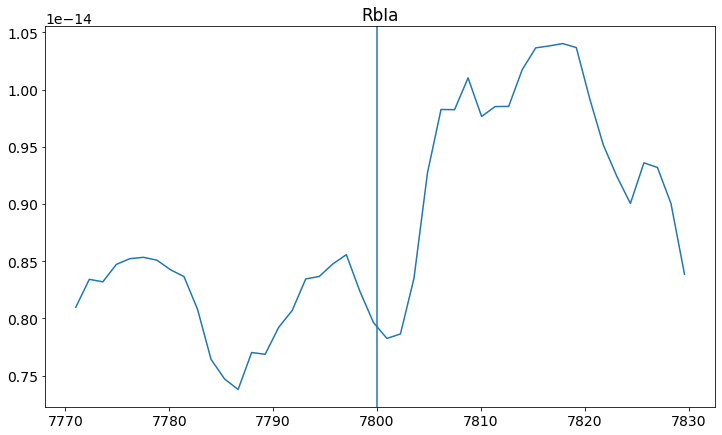

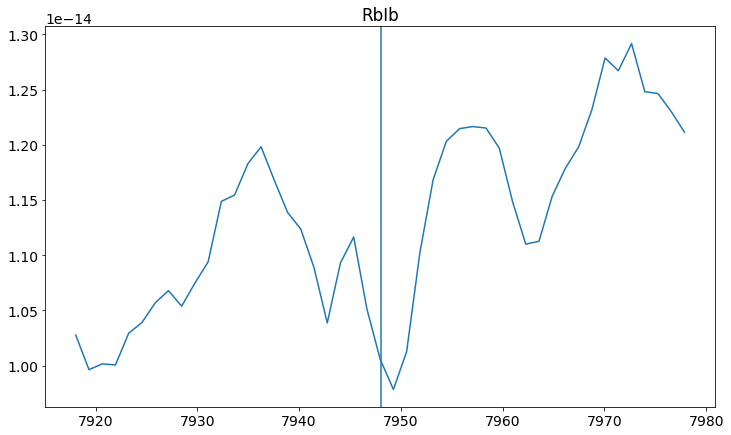

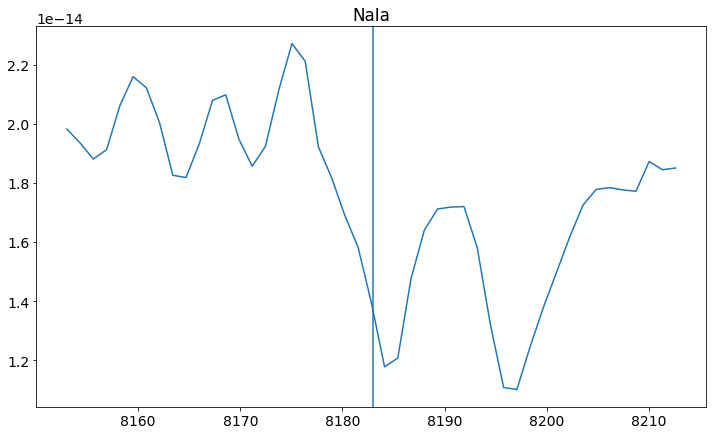

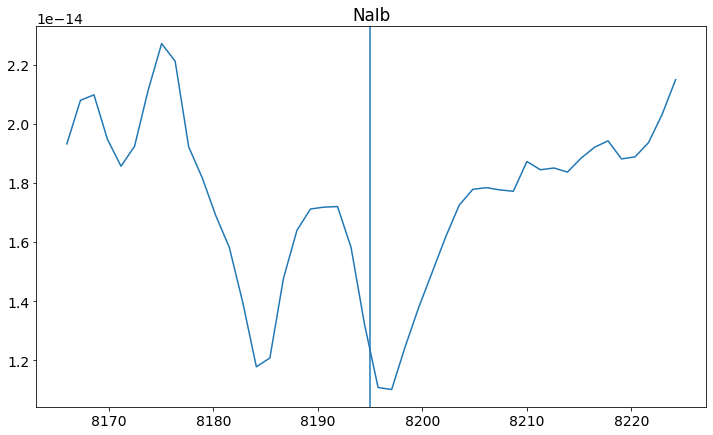

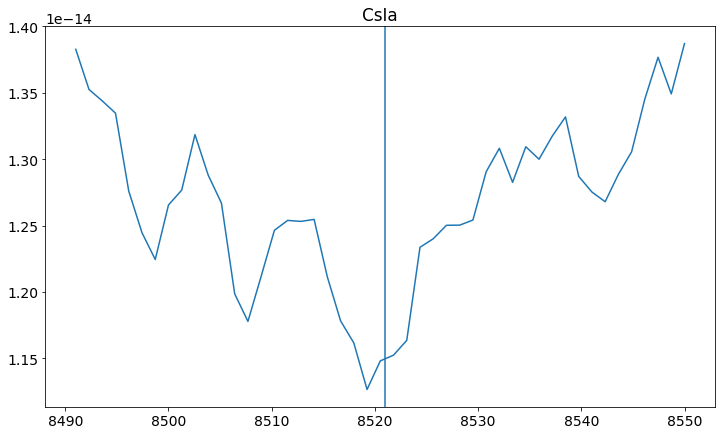

...

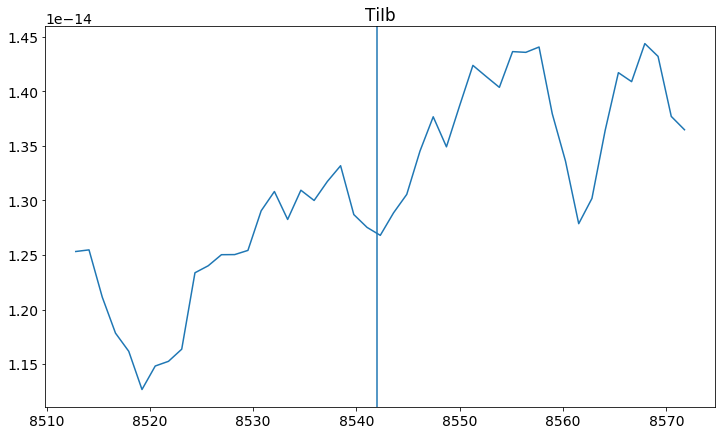

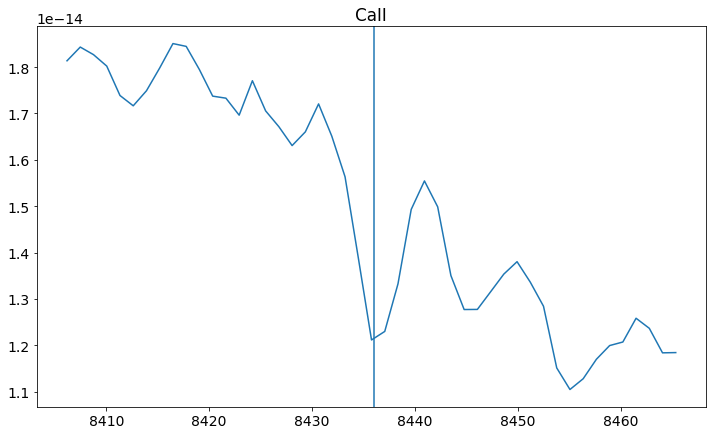

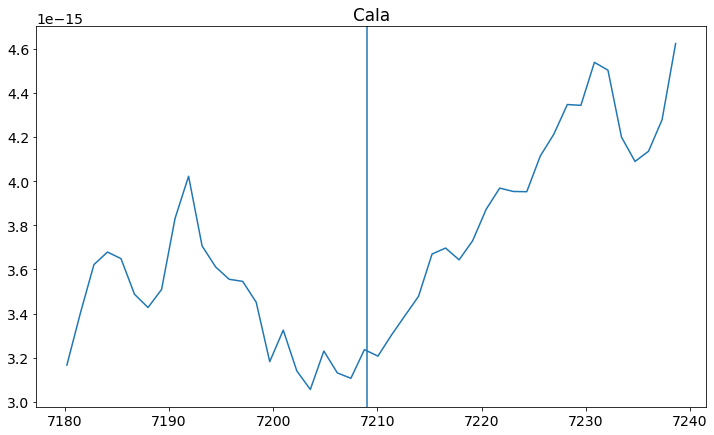

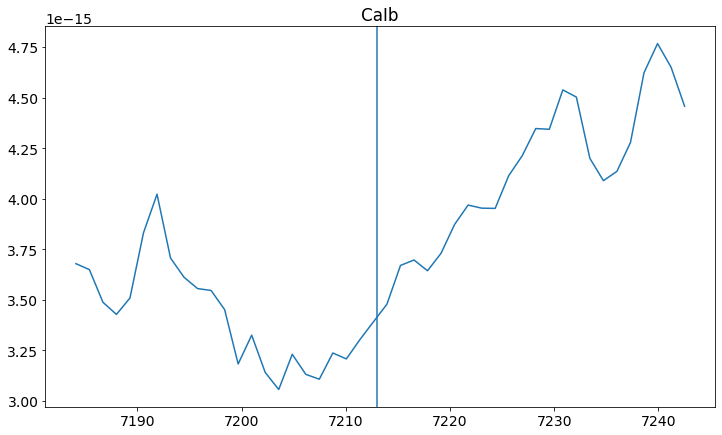

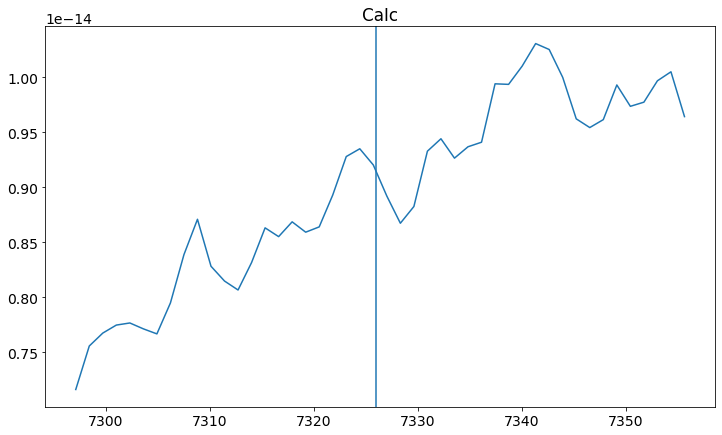

In [13]:
for ref in list(kastclassify_EW_dict):
    plt.figure(figsize=[12,7])
    
    waves = sp1.wave.value
    fluxes = sp1.flux.value
    
    wave_range = kastclassify_EW_dict[ref][wave_range_keyword]
    
    w = waves[ (waves >= wave_range[0]) & (waves <= wave_range[1]) ]
    f = fluxes[ (waves >= wave_range[0]) & (waves <= wave_range[1]) ]
    
    plt.plot(w,f)
    
    plt.axvline(kastclassify_EW_dict[ref][line_keyword])
    
    plt.title('{}'.format(ref))
    
    plt.show()

In [35]:
fits.getheader(sp1_path)['DATE']

'2019-12-09T12:18:19.88'

In [37]:
string = 'esdM50'

string[:-1] + '.' + string[-1:]

'esdM5.0'

In [21]:
measure_index_set(sp1)

{'CaH3': (0.6481971316929335, 0.02536900329175826),
 'CaH2': (0.3316944223427535, 0.015177473837058746),
 'TiO5': (0.2915535183459956, 0.017787552307938582)}

Calculating index TiO1


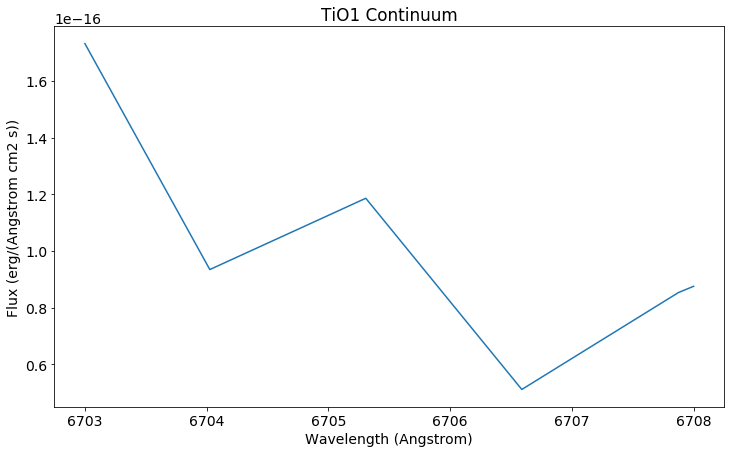

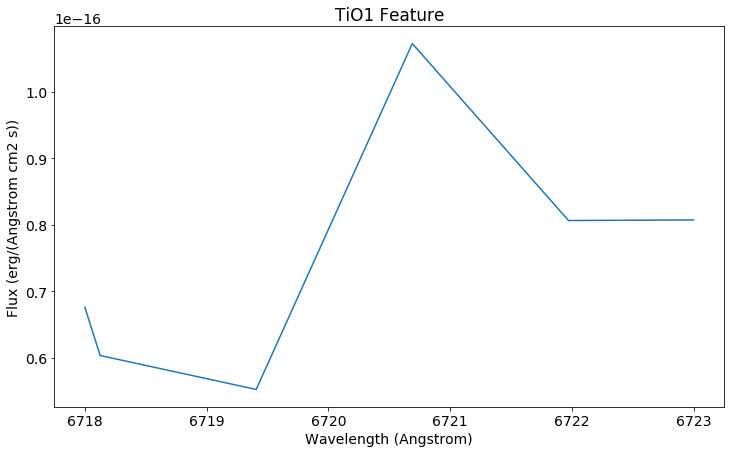

Calculating index TiO2


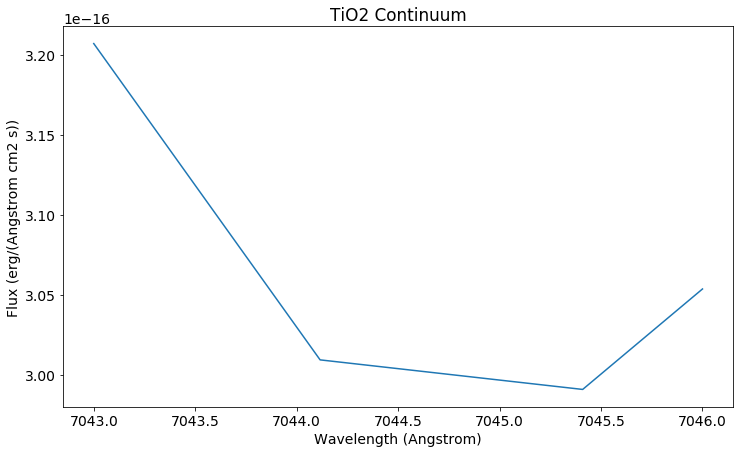

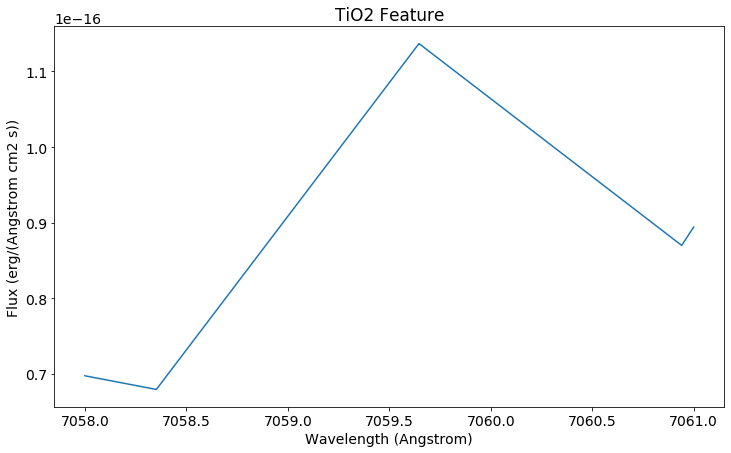

Calculating index TiO3


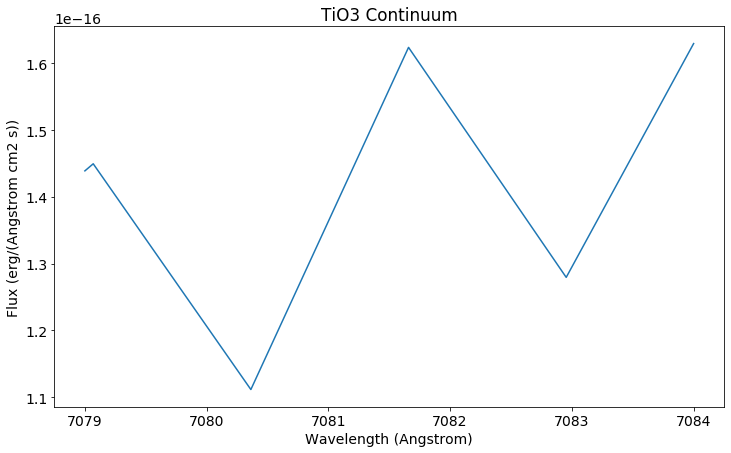

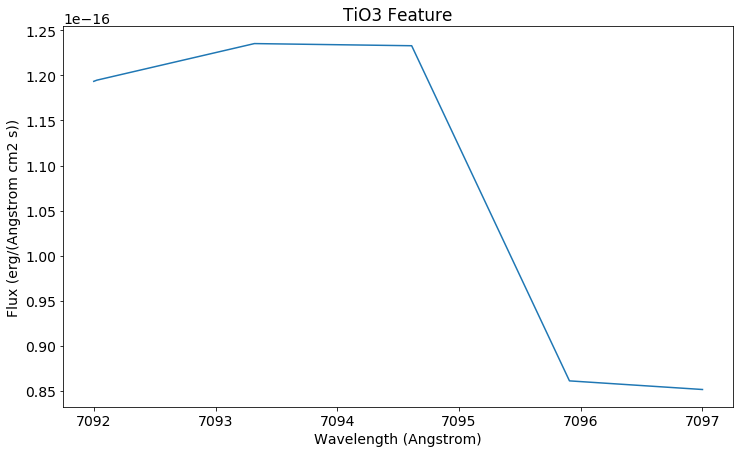

Calculating index TiO4


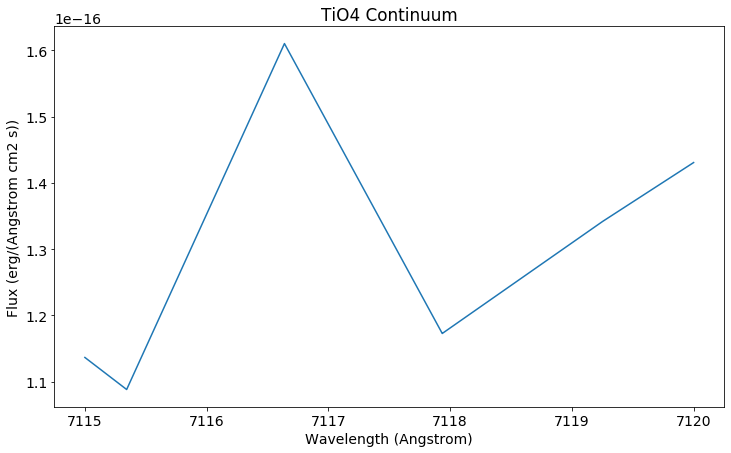

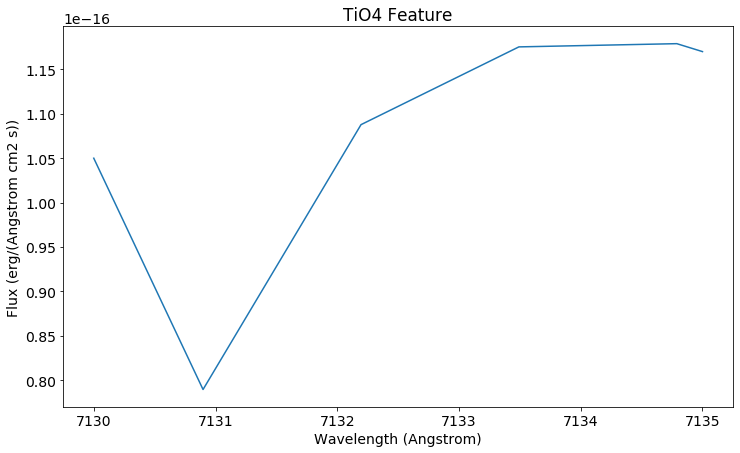

Calculating index TiO5


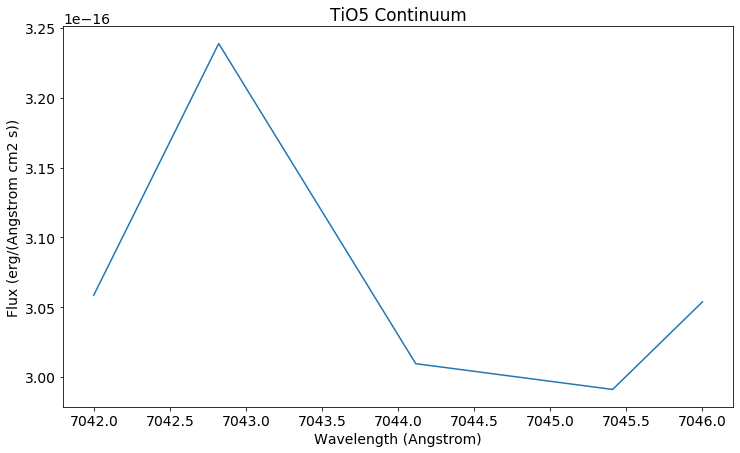

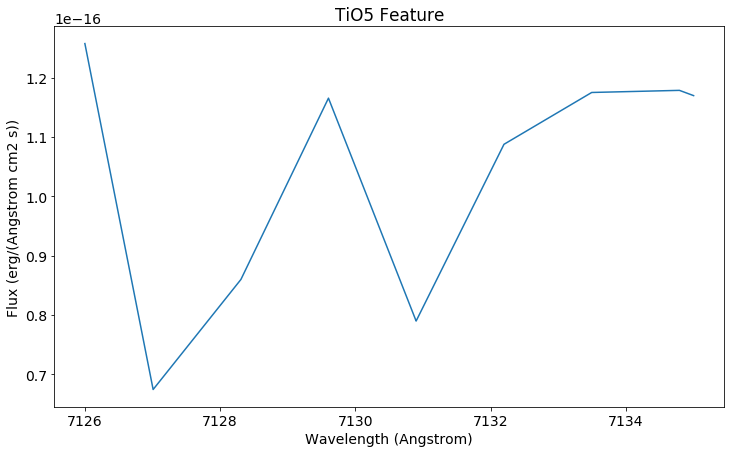

Calculating index CaH1


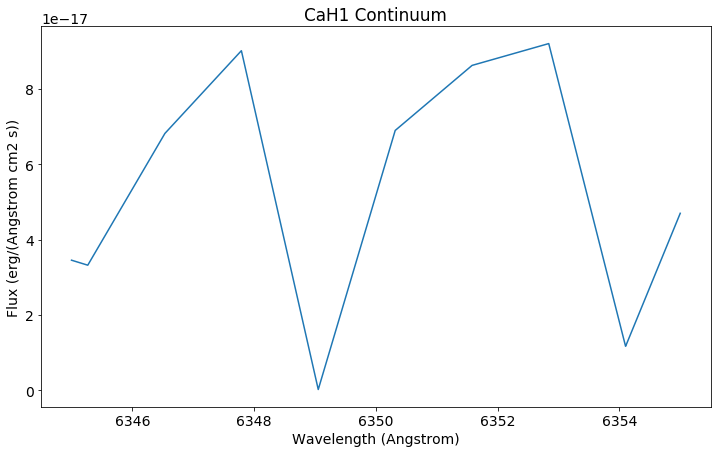

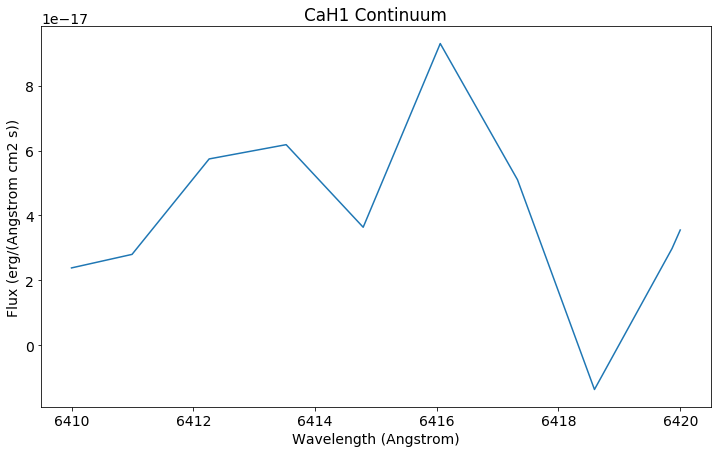

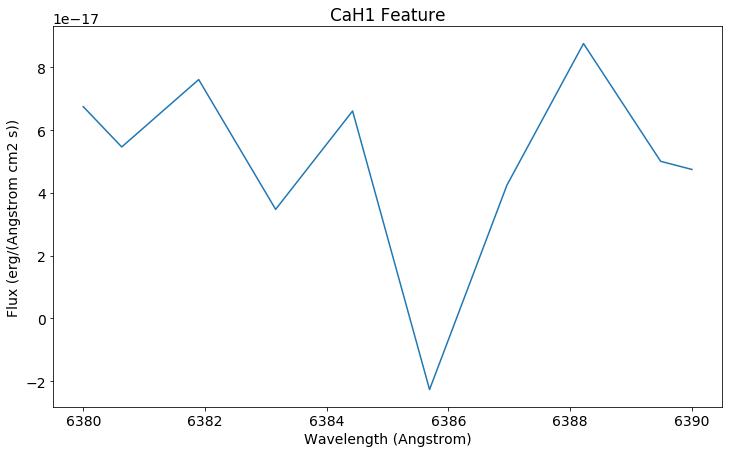

Calculating index CaH2


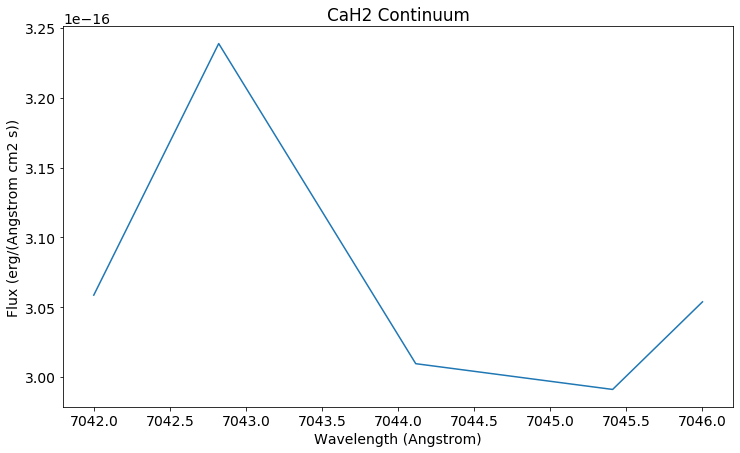

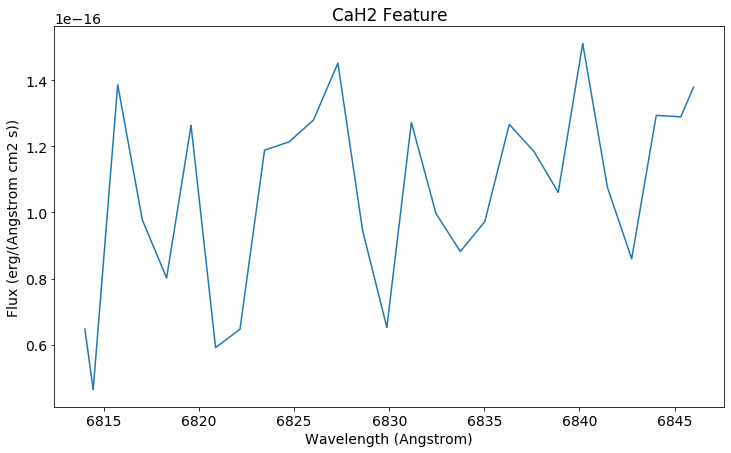

Calculating index CaH3


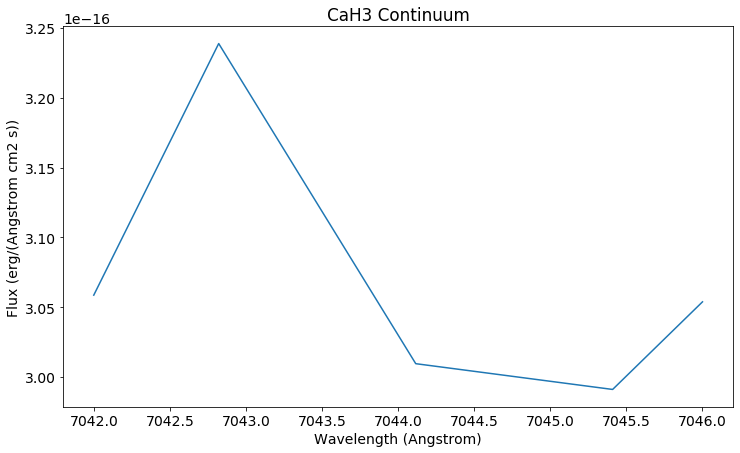

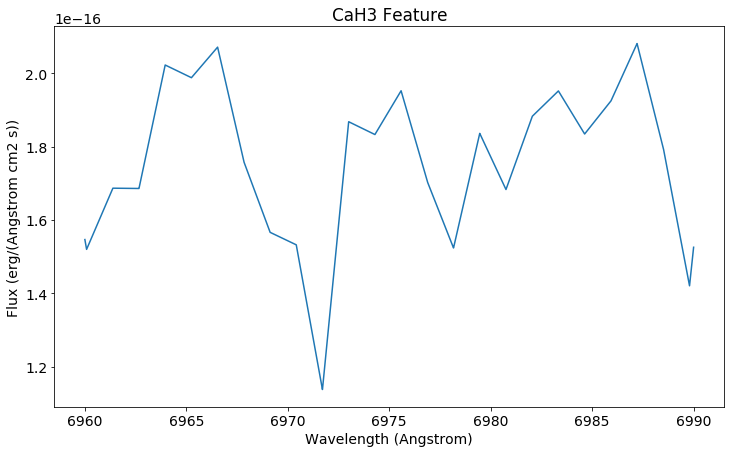

Calculating index CaOH


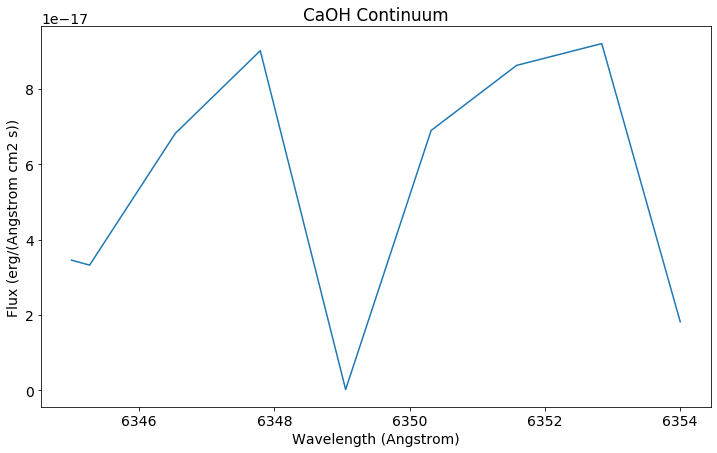

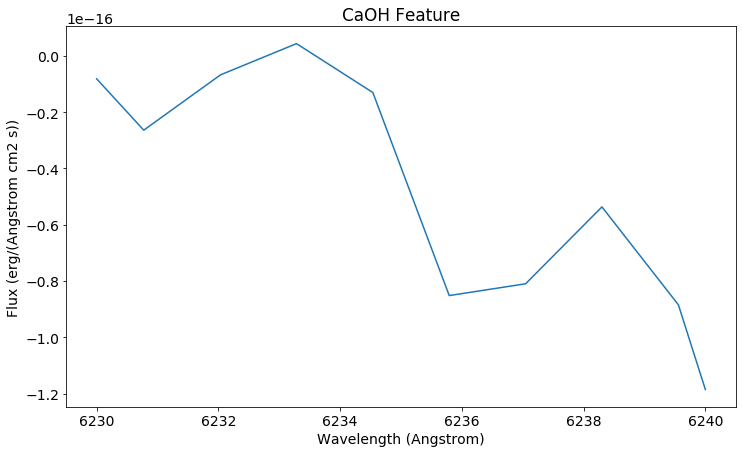

{'TiO1': (0.8116765574003266, 0.35669000404894663),
 'TiO2': (0.3031376320061863, 0.10116327401558124),
 'TiO3': (0.7920583298615334, 0.2322846515715009),
 'TiO4': (0.7976091820924323, 0.23390267663888822),
 'TiO5': (0.32557980452143137, 0.06311344194009036),
 'CaH1': (0.9740835604483371, 0.5339473918848165),
 'CaH2': (0.34735772735041825, 0.04342909031048386),
 'CaH3': (0.5760070860710802, 0.05967559274461921),
 'CaOH': (-0.7011255301652137, 0.4912791197886644)}

In [25]:
sp3_path = '/home/ryan/projects/KASTr_data/final/kastRED_J0525+2102_20200205.fits'
sp3 = kastredux.readSpectrum(sp3_path)
measure_index_set(sp3, ref='reid', plot=True)

In [45]:
get_spec_info(sp1_path)

Reading in /home/ryan/projects/Kast_Reduct/20191208/reduction/kastRED_J0906-0848B_20191208.fits
Classifying by standard comparison...
Done!
Measuring indices...
Mesuring index set lepine2007...
Done!
Mesuring index set lepine2003...
Done!
Mesuring index set gizis...
Done!
Mesuring index set reid...
Done!
Mesuring index set kirkpatrick...
Warning! No flux in continuum region for CrH-b!
Warning! No flux in continuum region for FeH-b!
Warning! No flux in feature region for Color-a!
Warning! No flux in feature region for Color-b!
Warning! No flux in feature region for Color-c!
Warning! No flux in feature region for Color-d!
Done!
Mesuring index set burgasser...
Warning! No flux in continuum region for H2O!
Warning! No flux in continuum region for CrH(B)!
Warning! No flux in continuum region for FeH(B)!
Done!
Mesuring index set martin...
Warning! No flux in continuum region for CrH2!
Warning! No flux in continuum region for FeH2!
Warning! No flux in continuum region for H2O1!
Done!
Done!
Me

{'name': 'J0906-0848',
 'filename': 'kastRED_J0906-0848B_20191208.fits',
 'spt': 'M6.0',
 'subtype': 16.0,
 'spt_chi2': 17841.467052288048,
 'spt_scale': 1.7404180373645285e-14,
 'lepine2007_CaH3': 0.6481971316929335,
 'lepine2007_CaH3_err': 0.02102136577328988,
 'lepine2007_CaH2': 0.3316944223427535,
 'lepine2007_CaH2_err': 0.015253796814460006,
 'lepine2007_TiO5': 0.2915535183459956,
 'lepine2007_TiO5_err': 0.017258373914247054,
 'lepine2003_CaH1': 0.7941940672439514,
 'lepine2003_CaH1_err': 0.06757780486098833,
 'lepine2003_CaH2': 0.3316944223427535,
 'lepine2003_CaH2_err': 0.014228621976953824,
 'lepine2003_CaH3': 0.6481971316929335,
 'lepine2003_CaH3_err': 0.02589350730088342,
 'lepine2003_TiO5': 0.2915535183459956,
 'lepine2003_TiO5_err': 0.019032940360379887,
 'lepine2003_VO1': 0.8237547330457948,
 'lepine2003_VO1_err': 0.011385707348678706,
 'lepine2003_TiO6': 2.0321094056856994,
 'lepine2003_TiO6_err': 0.04012472214113619,
 'lepine2003_VO2': 0.8773591077991193,
 'lepine2003_VO

In [43]:
typeToNum('M7.5')

17.5

In [40]:
classify_by_standard(sp1, ref='all')

('M6.0', 'M60_SDSS-bochanski2007', 17841.467052288048, 1.7404180373645285e-14)

In [19]:
np.all(sp1.flux.value < 1e-22)

False

Reading in /home/ryan/projects/Kast_Reduct/20191208/reduction/kastRED_J0906-0848B_20191208.fits


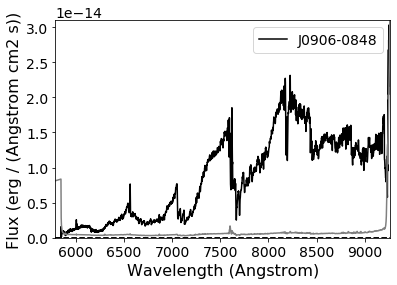

Classifying by standard comparison...
Done!
Measuring indices...
Mesuring index set lepine2007...
Done!
Mesuring index set lepine2003...
Done!
Mesuring index set gizis...
Done!
Mesuring index set reid...
Done!
Mesuring index set kirkpatrick...
Done!
Mesuring index set burgasser...
Done!
Mesuring index set martin...
Done!
Done!
Measuring Equivalent Widths...
Measuring EW for RbI...


<Figure size 432x288 with 0 Axes>

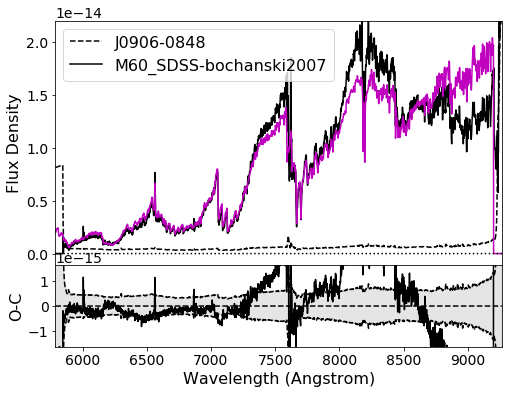

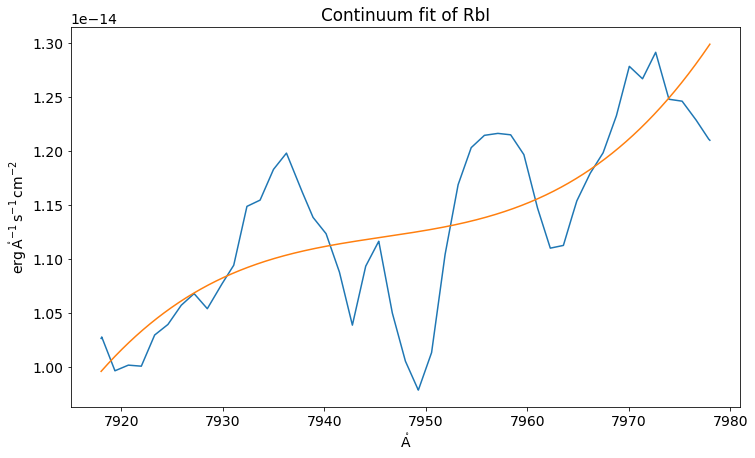

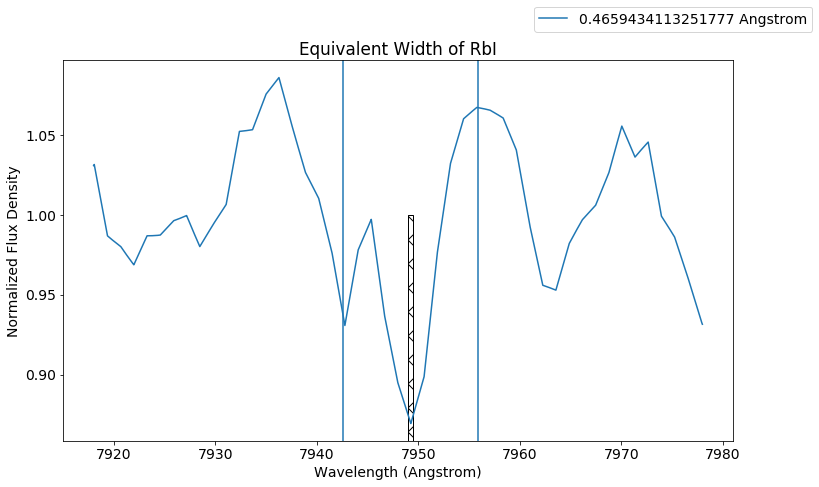

Done!
Measuring EW for Halpha...


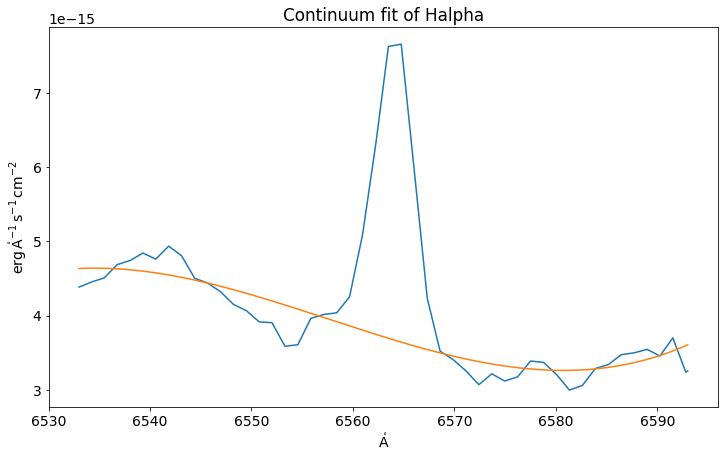

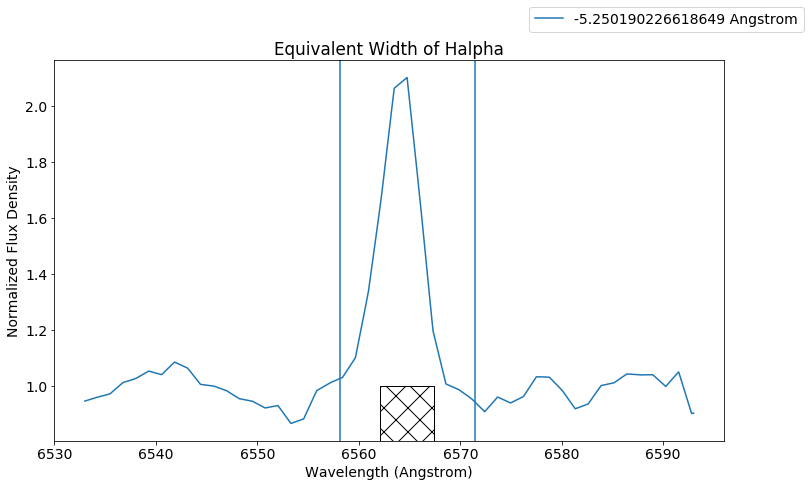

Done!
Done!
Calculating spectral types by index...
Done!
Packaging results...
Done!
Full Process took 0:07:39.730393


{'name': 'J0906-0848',
 'filename': 'kastRED_J0906-0848B_20191208.fits',
 'spt': 'M60',
 'subtype': 16.0,
 'spt_chi2': 17841.467052288048,
 'spt_scale': 1.7404180373645285e-14,
 'lepine2007_CaH3': 0.6481984257936682,
 'lepine2007_CaH3_err': 0.02557248365024621,
 'lepine2007_CaH2': 0.331692559665969,
 'lepine2007_CaH2_err': 0.013997841299128509,
 'lepine2007_TiO5': 0.2915485722054284,
 'lepine2007_TiO5_err': 0.016972651251680525,
 'lepine2003_CaH1': 0.7941908674248674,
 'lepine2003_CaH1_err': 0.055623376821970355,
 'lepine2003_CaH2': 0.331692559665969,
 'lepine2003_CaH2_err': 0.014338899153767624,
 'lepine2003_CaH3': 0.6481984257936682,
 'lepine2003_CaH3_err': 0.024598956442657766,
 'lepine2003_TiO5': 0.2915485722054284,
 'lepine2003_TiO5_err': 0.02008899761325065,
 'lepine2003_VO1': 0.8237516558768605,
 'lepine2003_VO1_err': 0.011379987213611166,
 'lepine2003_TiO6': 2.0321265899206447,
 'lepine2003_TiO6_err': 0.046014458619316766,
 'lepine2003_VO2': 0.8773643684392161,
 'lepine2003_VO2

In [17]:
t1 = datetime.datetime.now()
sp1_info = get_spec_info(sp1_path, plot=True)
t2 = datetime.datetime.now()

dt = t2 - t1
print('Full Process took {}'.format(dt))
sp1_info

In [24]:
list(sp1_info.items())

[('name', 'J0906-0848'),
 ('filename', 'kastRED_J0906-0848B_20191208.fits'),
 ('spt', 'M60'),
 ('subtype', 16.0),
 ('spt_chi2', 17841.467052288048),
 ('spt_scale', 1.7404180373645285e-14),
 ('lepine2007_CaH3', 0.6481984257936682),
 ('lepine2007_CaH3_err', 0.02557248365024621),
 ('lepine2007_CaH2', 0.331692559665969),
 ('lepine2007_CaH2_err', 0.013997841299128509),
 ('lepine2007_TiO5', 0.2915485722054284),
 ('lepine2007_TiO5_err', 0.016972651251680525),
 ('lepine2003_CaH1', 0.7941908674248674),
 ('lepine2003_CaH1_err', 0.055623376821970355),
 ('lepine2003_CaH2', 0.331692559665969),
 ('lepine2003_CaH2_err', 0.014338899153767624),
 ('lepine2003_CaH3', 0.6481984257936682),
 ('lepine2003_CaH3_err', 0.024598956442657766),
 ('lepine2003_TiO5', 0.2915485722054284),
 ('lepine2003_TiO5_err', 0.02008899761325065),
 ('lepine2003_VO1', 0.8237516558768605),
 ('lepine2003_VO1_err', 0.011379987213611166),
 ('lepine2003_TiO6', 2.0321265899206447),
 ('lepine2003_TiO6_err', 0.046014458619316766),
 ('lepi

In [28]:
s = pd.Series(sp1_info)

df1 = s.to_frame().transpose()

In [29]:
df2 = copy.deepcopy(df1)

In [13]:
df = pd.DataFrame()

In [14]:
df1 = pd.DataFrame(np.ones(55))

In [20]:
df = df.append(df1)

In [21]:
df

,0
0,1.0
1,1.0
2,1.0
3,1.0
4,1.0
...,...
50,1.0
51,1.0
52,1.0
53,1.0


In [21]:
d = get_spec_info(sp1_path)

Reading in /home/ryan/projects/Kast_Reduct/20191208/reduction/kastRED_J0906-0848B_20191208.fits
Classifying by standard comparison...
Done!
Measuring indices...
Mesuring index set lepine2007...
Done!
Mesuring index set lepine2003...
Done!
Mesuring index set gizis...
Done!
Mesuring index set reid...
Done!
Mesuring index set kirkpatrick...
Done!
Mesuring index set burgasser...
Done!
Mesuring index set martin...
Done!
Done!
Measuring Equivalent Widths...
Measuring EW for RbIa...
Done!
Measuring EW for RbIb...
Done!
Measuring EW for NaIa...
Done!
Measuring EW for NaIb...
Done!
Measuring EW for CsIa...
Done!
Measuring EW for CsIb...
Done!
Measuring EW for Halpha...
Done!
Measuring EW for LiI...
Done!
Measuring EW for KIa...
Done!
Measuring EW for KIb...
Done!
Measuring EW for TiIa...
Warning! No features detected for TiIa!
Done!
Measuring EW for TiIb...
Done!
Measuring EW for CaII...
Done!
Measuring EW for CaIa...
Done!
Measuring EW for CaIb...
Warning! No features detected for CaIb!
Done!


In [23]:
d['Halpha_EW_(Angstrom)']

-5.215437352481203

In [31]:
chi = 0

spt = typeToNum(d['spt'])

Halpha_EW = d['Halpha_EW_(Angstrom)']

types = list(kastclassify_chi_factor_dict)

for sp in types:
    
    if typeToNum(sp) == spt:
        chi = kastclassify_chi_factor_dict[sp]['chi']

Lratio = chi * Halpha_EW

Lratio

-9.056606962583609e-05

In [38]:
calculate_L_Lbol(d['Halpha_EW_(Angstrom)'], d['Halpha_EW_err_(Angstrom)'], d['spt'])

(-9.056606962583609e-05, 3.475e-06)

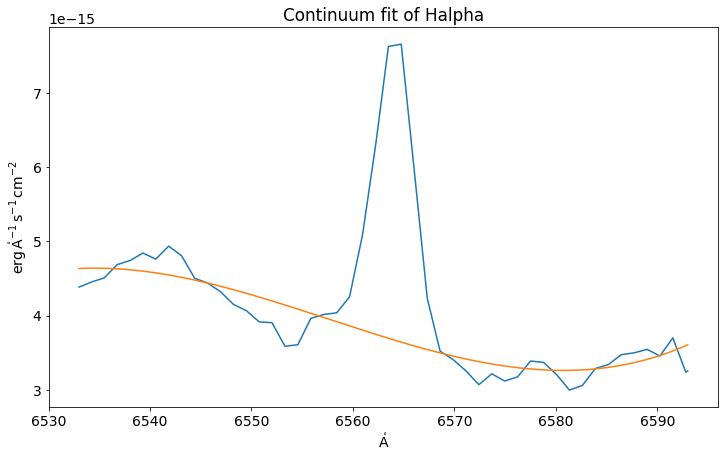

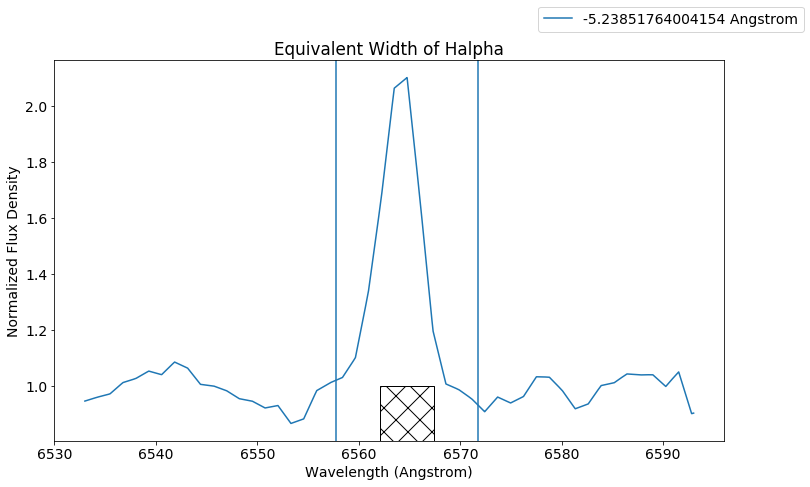

{'EW': <Quantity -5.23851764 Angstrom>,
 'EW_err': 0.06999204888361116,
 'line_center': 6564.755175517552,
 'line_center_err': 0.7693854620918633}

In [86]:
measure_EW_element(sp1, 'Halpha', plot=True, no_trials=100)

Fit Start
Fit End. Time was 0:00:00.129739
Masking Start
Masking End. Time is 0:00:00.905122


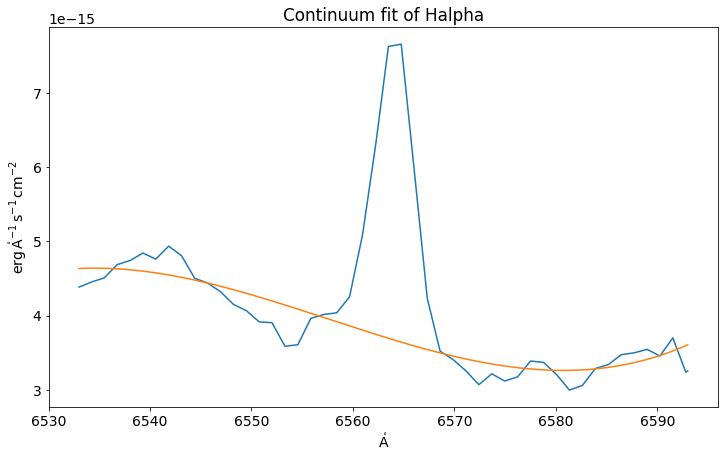

Line Finding Start
Line Finding End. Time was 0:00:00.006788
Line Centering End. Time was 0:00:00.007621
Line Width Start
Line Width End. Time was 0:00:00.002375
EW calculation start
EW calculation end. Time was 0:00:01.015633


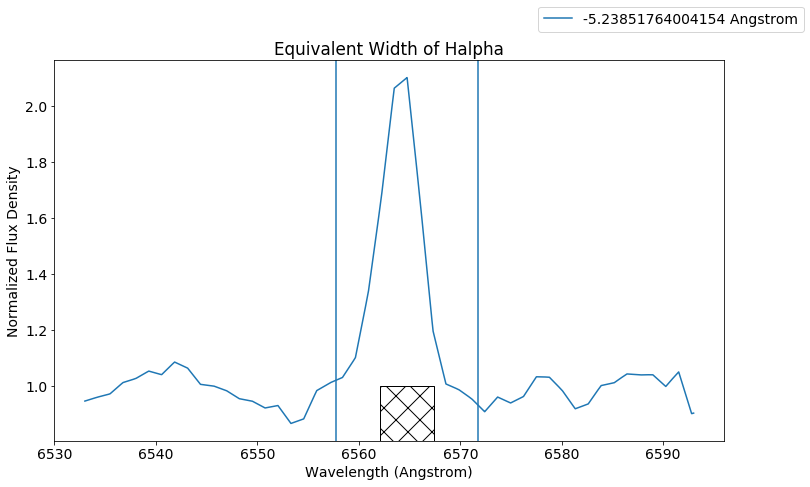

{'EW': <Quantity -5.23851764 Angstrom>,
 'EW_err': nan,
 'line_center': 6564.755175517552,
 'line_center_err': nan}

In [72]:
measure_EW_element(sp1, 'Halpha', plot=True, no_trials=0)

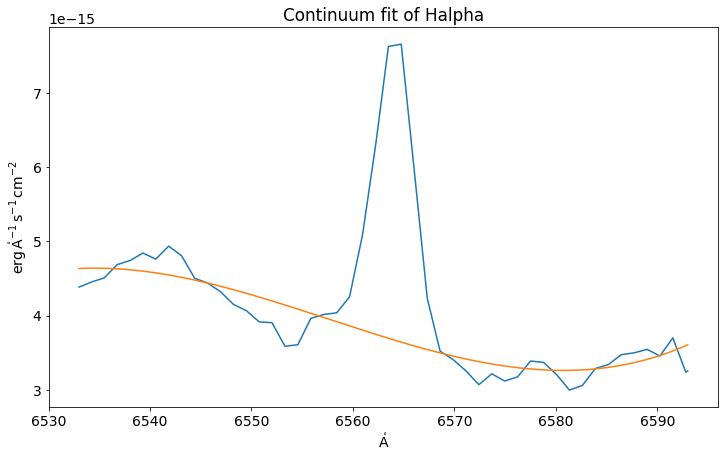

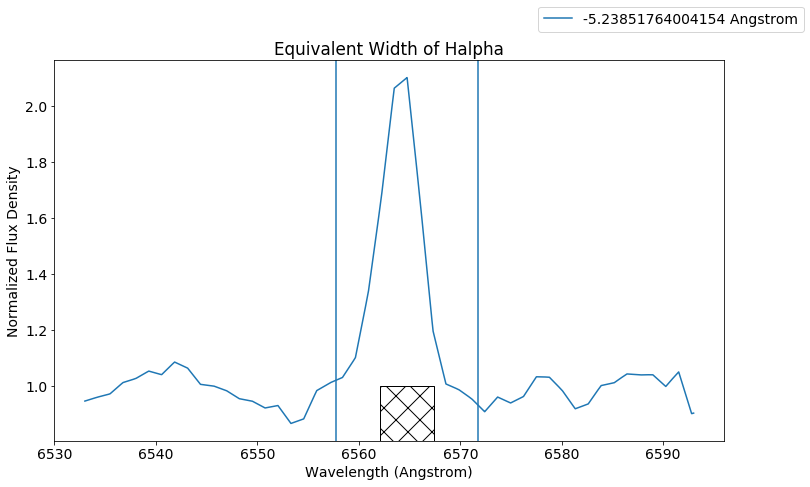

Trial Start
Trial Finished. Time of trial: 0:00:01.656130
Trial Start
Trial Finished. Time of trial: 0:00:01.722598
Trial Start
Trial Finished. Time of trial: 0:00:01.609872
Trial Start
Trial Finished. Time of trial: 0:00:01.554535
Trial Start
Trial Finished. Time of trial: 0:00:01.514808
Trial Start
Trial Finished. Time of trial: 0:00:01.510006
Trial Start
Trial Finished. Time of trial: 0:00:01.543424
Trial Start
Trial Finished. Time of trial: 0:00:01.545955
Trial Start
Trial Finished. Time of trial: 0:00:01.524525
Trial Start
Trial Finished. Time of trial: 0:00:01.512811
Trial Start
Trial Finished. Time of trial: 0:00:01.505987
Trial Start
Trial Finished. Time of trial: 0:00:01.512991
Trial Start
Trial Finished. Time of trial: 0:00:01.511700
Trial Start
Trial Finished. Time of trial: 0:00:01.501673
Trial Start
Trial Finished. Time of trial: 0:00:01.587663
Trial Start
Trial Finished. Time of trial: 0:00:01.590390
Trial Start
Trial Finished. Time of trial: 0:00:01.786529
Trial Start
Tr

KeyboardInterrupt: 

In [69]:
measure_EW_element(sp1, 'Halpha', plot=True, no_trials=100)#, file='HalphaDiagnostic.png')

Fit Start
Fit End. Time was 0:00:00.152502
Masking Start
Masking End. Time is 0:00:00.968357


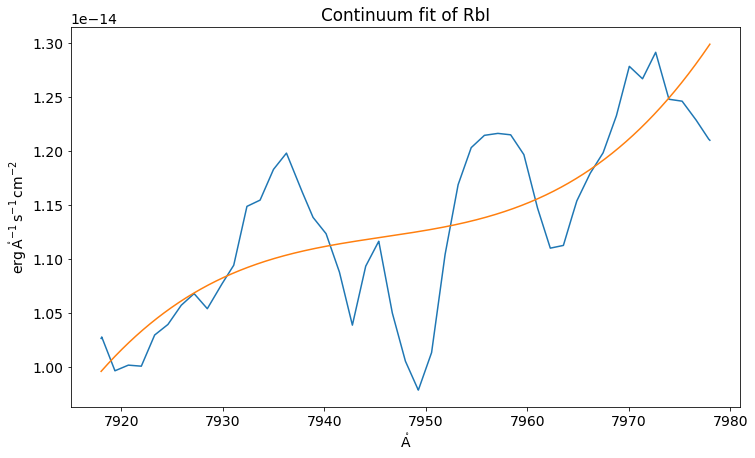

Line Finding Start
Line Finding End. Time was 0:00:00.004955
Line Centering End. Time was 0:00:00.006157
EW calculation start
EW calculation end. Time was 0:00:01.025657


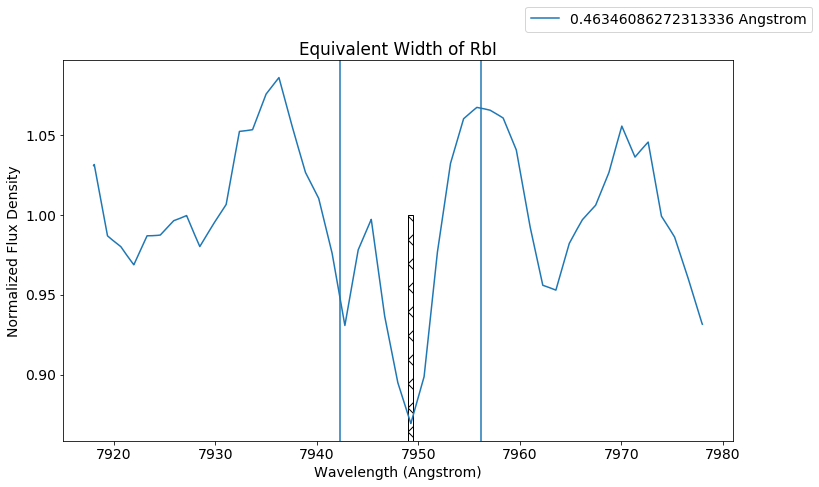

{'EW': <Quantity 0.46346086 Angstrom>,
 'EW_err': nan,
 'line_center': 7949.263126312631,
 'line_center_err': nan}

In [73]:
measure_EW_element(sp1, 'RbI', plot=True, no_trials=0)

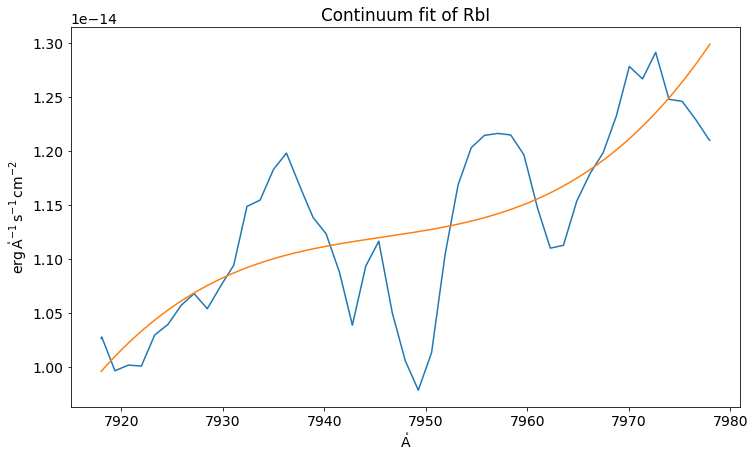

[7938.         7938.00060001 7938.00120001 ... 7957.99879999 7957.99939999
 7958.        ] Angstrom
[5.05337269e-16 5.05190640e-16 5.05044005e-16 ... 7.08170573e-16
 7.08145316e-16 7.08120062e-16]
-1.4701095765215287e-15


(<Quantity 0.53351569 Angstrom>, 7949.264512645126)

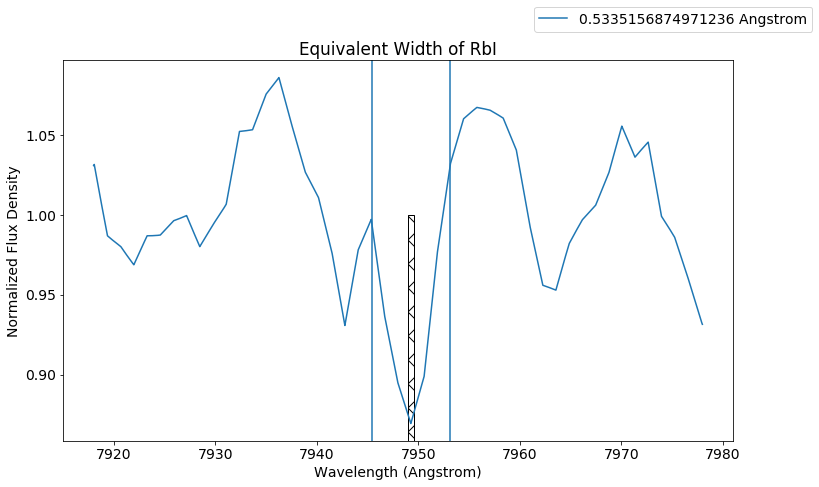

In [38]:
measure_EW_simple(sp1, 7948, [7918, 7978], 'absorption', plot=True, name='RbI')#, file='RbIDiagnostic.png')

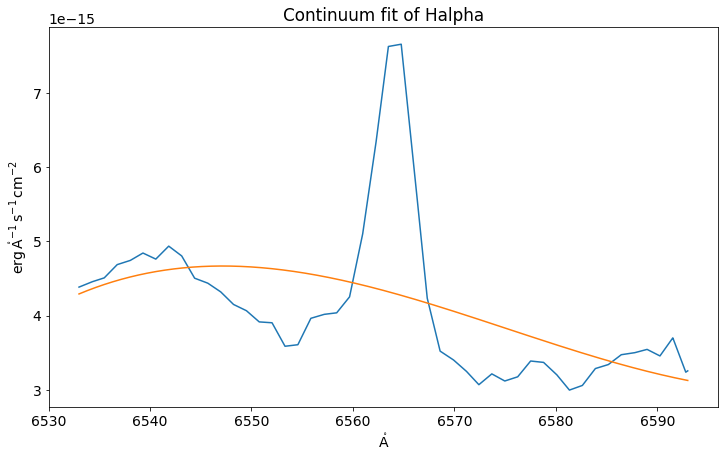

<Quantity -3.08048649 Angstrom>

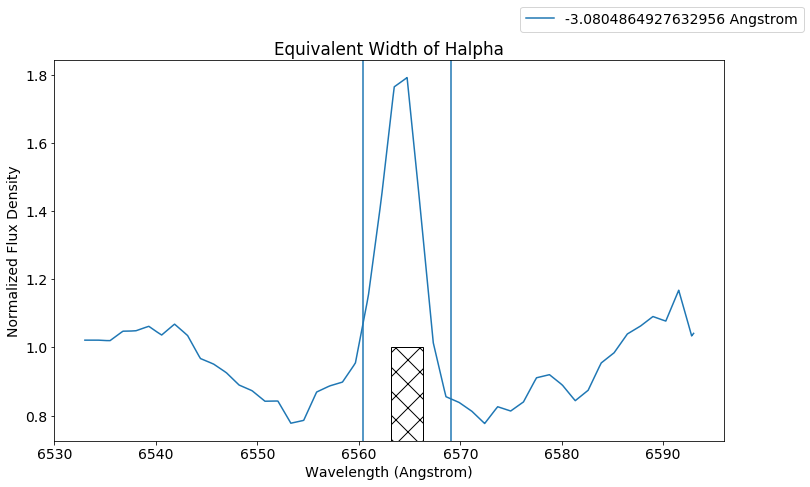

In [123]:
measure_EW_simple(sp1, 6563, [6533, 6593], 'emission', plot=True, name='Halpha')

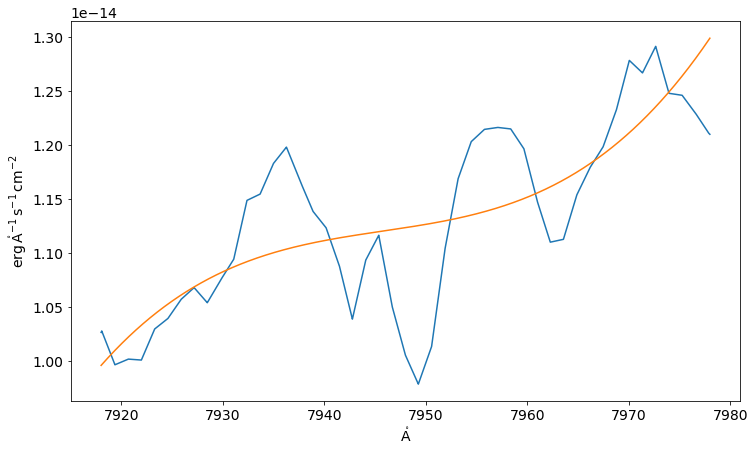

7949.264512645126


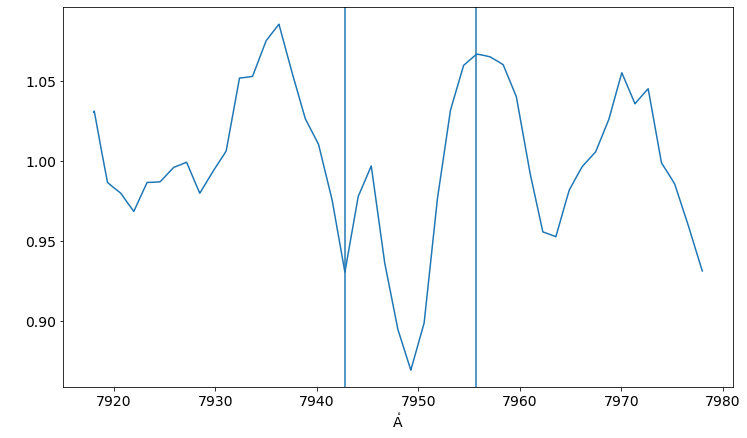

<Quantity 0.46604158 Angstrom>

In [94]:
#wave_range = [6533, 6593]
wave_range = [7918, 7978]
line = 7948
name = 'RbI'
feat_type = 'absorption'
spec = sp1

line_width=[0.,0.]

if line_width[0] == 0.:
    ic = numpy.nanargmin(numpy.array([numpy.abs(a-line) for a in spec.wave.value]))
    width = numpy.array(spec.wave.value)[ic+5]-line
    line_width = [numpy.abs(width),numpy.abs(width)]

waves = spec.wave.value
fluxes = spec.flux.value
unc = spec.unc.value

no_samples = 100000

finterp = interp1d(waves, fluxes, bounds_error=False, fill_value=0.)

uinterp = interp1d(waves, unc, bounds_error=False, fill_value=0.)

feature_waves = np.linspace(wave_range[0], wave_range[1], no_samples) * u.AA

feature_flux = finterp(feature_waves) * u.erg / (u.AA * u.s * (u.cm)**2)

feature_unc = astropy.nddata.StdDevUncertainty(uinterp(feature_waves) * u.erg / (u.AA * u.s * (u.cm)**2))

feature_spec = specutils.Spectrum1D(spectral_axis=feature_waves, flux=feature_flux, uncertainty=feature_unc)

continuum_fit = specutils.fitting.fit_generic_continuum(feature_spec)(feature_spec.spectral_axis)

norm_spec = feature_spec / continuum_fit

subtr_spec = feature_spec - continuum_fit


plt.figure(figsize=[12,7])
plt.plot(feature_spec.wavelength, feature_spec.flux)
plt.plot(feature_spec.wavelength, continuum_fit)
plt.show()

line_info = specutils.fitting.find_lines_threshold(subtr_spec)

nearest = np.argmin(np.abs(line_info[ line_info['line_type'] == feat_type]['line_center'].value - line))

line_center = line_info[ line_info['line_type'] == feat_type][nearest]['line_center'].value

print(line_center)
#near = np.abs(line_info[ line_info['line_type'] == feat_type]['line_center'].value - line) < 5

#line_center = line_info[ line_info['line_type'] == feat_type][near]['line_center'].value

region = specutils.SpectralRegion( (line_center - line_width[0]) * u.AA, (line_center + line_width[1]) * u.AA )

EW = specutils.analysis.equivalent_width(norm_spec, regions=region)

plt.figure(figsize=[12,7])
plt.plot(feature_spec.wavelength, norm_spec.flux)
plt.axvline(line_center - line_width[0])
plt.axvline(line_center + line_width[1])
plt.show()

EW

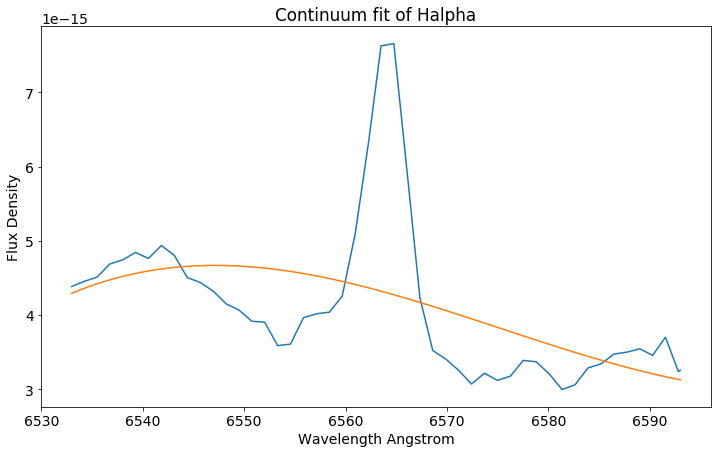

<Quantity 0.00566234 Angstrom>

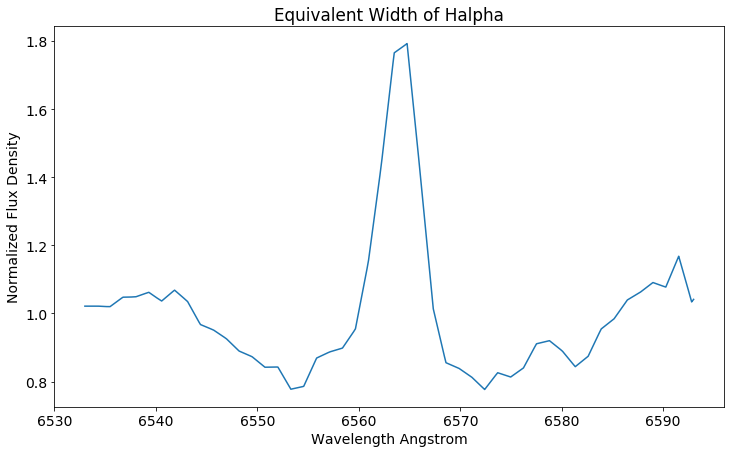

In [65]:
measure_EW_simple(sp1, [6533, 6593], plot=True, name='Halpha')

In [9]:
list(kastclassify_index_dict)

['lepine2007',
 'lepine2003',
 'gizis',
 'reid',
 'kirkpatrick',
 'burgasser',
 'martin']

In [10]:
stars_df = pd.DataFrame(columns=['NAME', 'TYPE', 'SUBTYPE', 'lepine2007',\
                                 'lepine2003', 'gizis', 'reid',\
                                 'kirkpatrick', 'burgasser', 'martin'])

<Figure size 432x288 with 0 Axes>

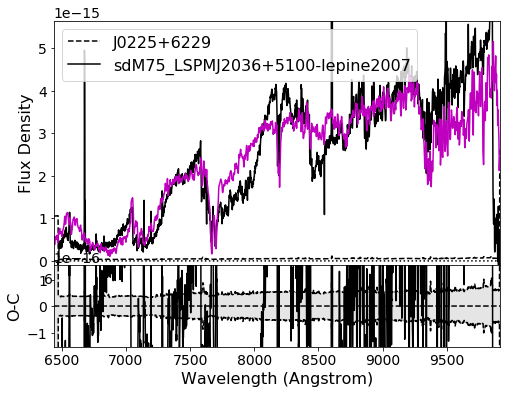

<Figure size 432x288 with 0 Axes>

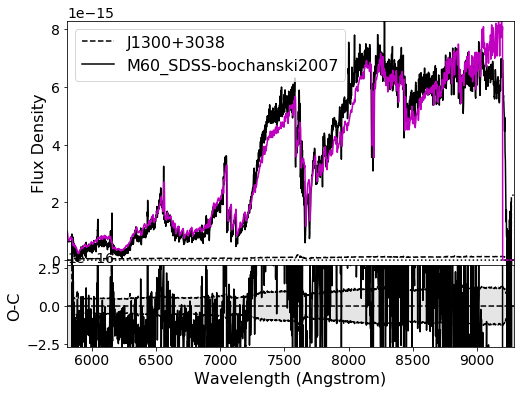

<Figure size 432x288 with 0 Axes>

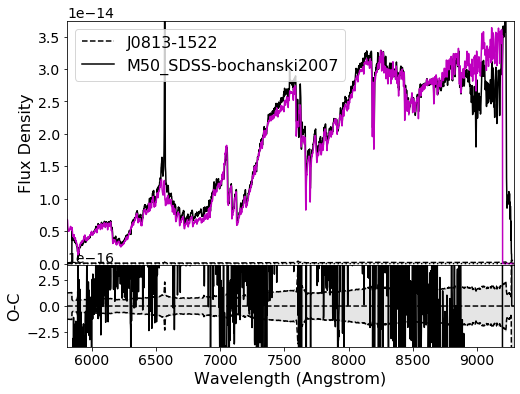

<Figure size 432x288 with 0 Axes>

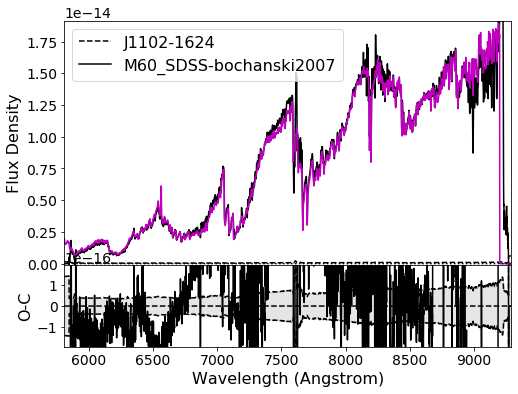

<Figure size 432x288 with 0 Axes>

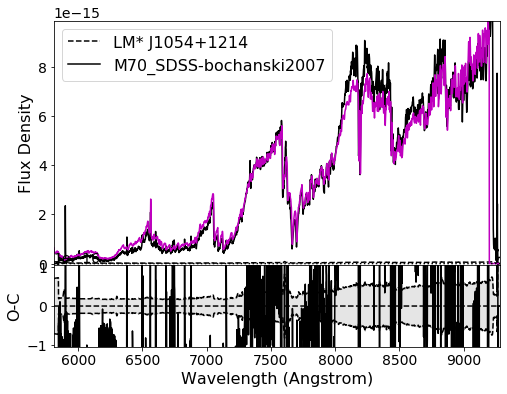

<Figure size 432x288 with 0 Axes>

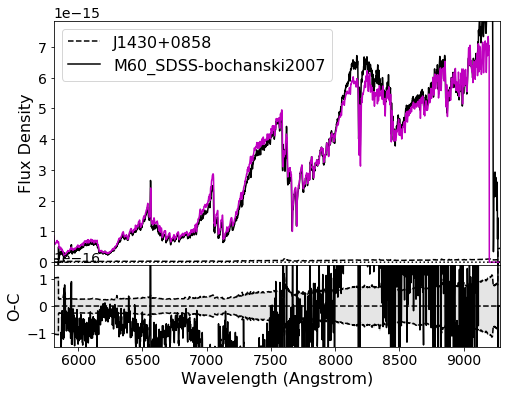

<Figure size 432x288 with 0 Axes>

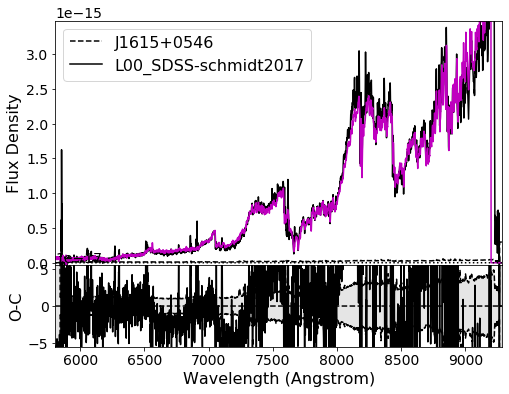

<Figure size 432x288 with 0 Axes>

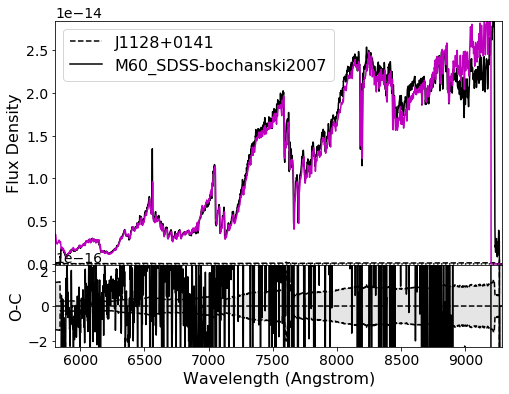

<Figure size 432x288 with 0 Axes>

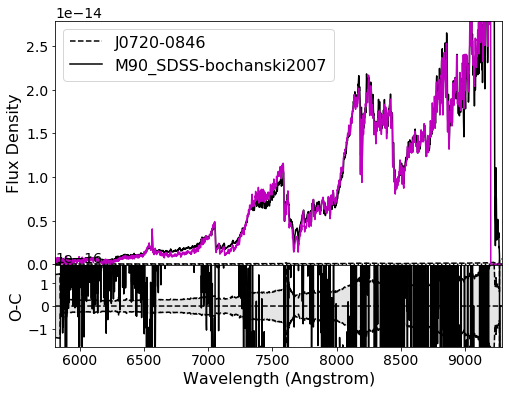

<Figure size 432x288 with 0 Axes>

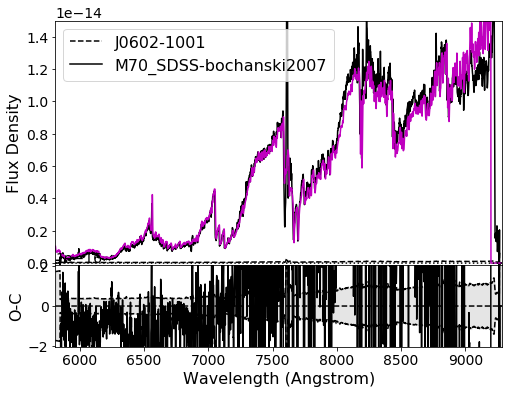

<Figure size 432x288 with 0 Axes>

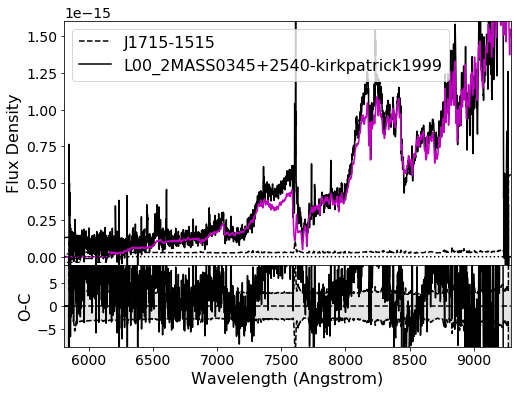

<Figure size 432x288 with 0 Axes>

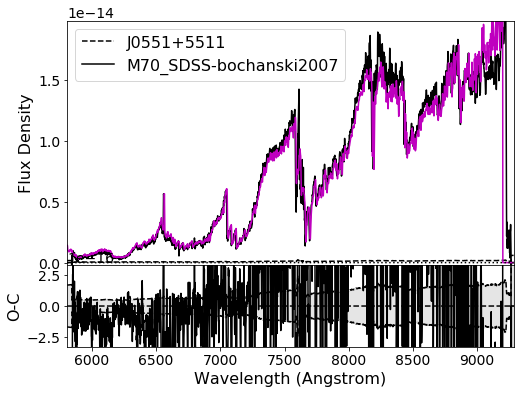

<Figure size 432x288 with 0 Axes>

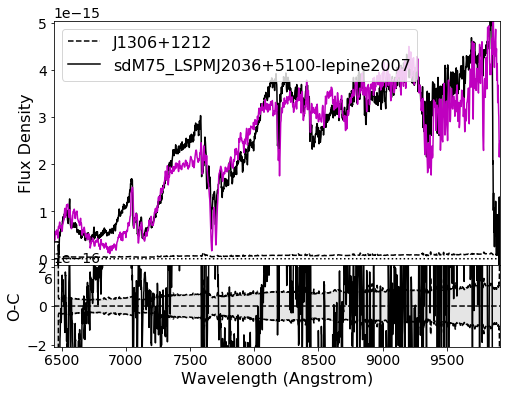

<Figure size 432x288 with 0 Axes>

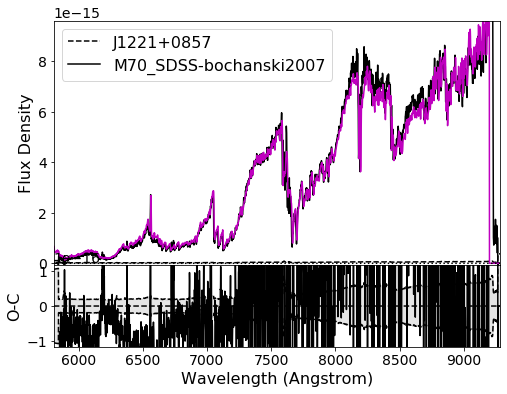

<Figure size 432x288 with 0 Axes>

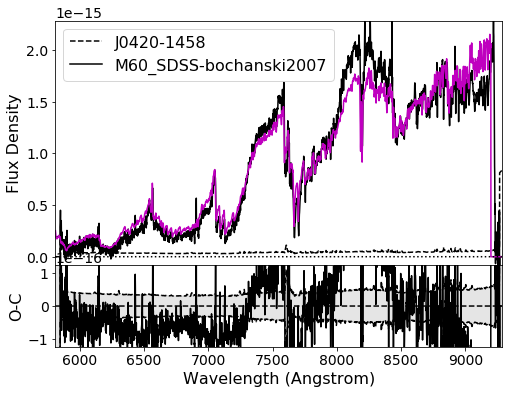

<Figure size 432x288 with 0 Axes>

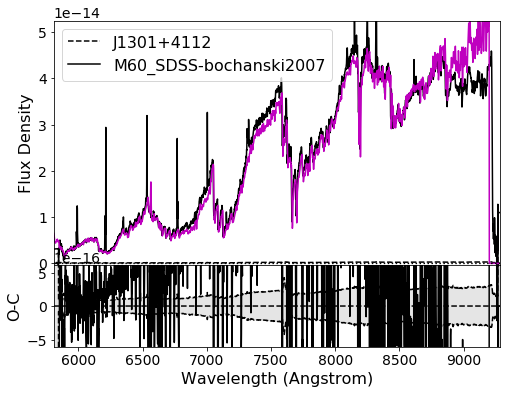

<Figure size 432x288 with 0 Axes>

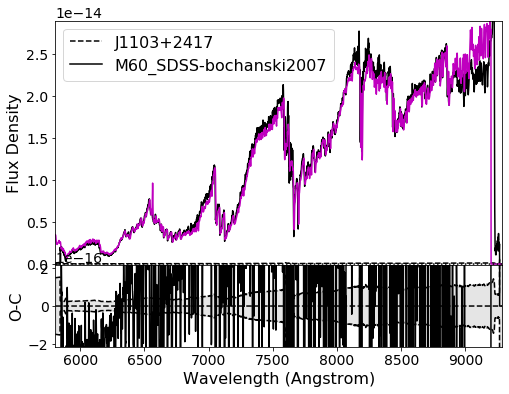

<Figure size 432x288 with 0 Axes>

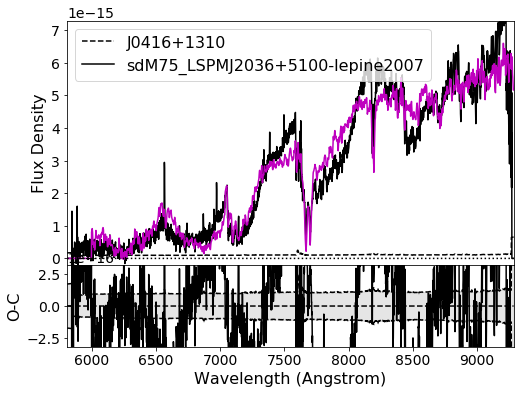

<Figure size 432x288 with 0 Axes>

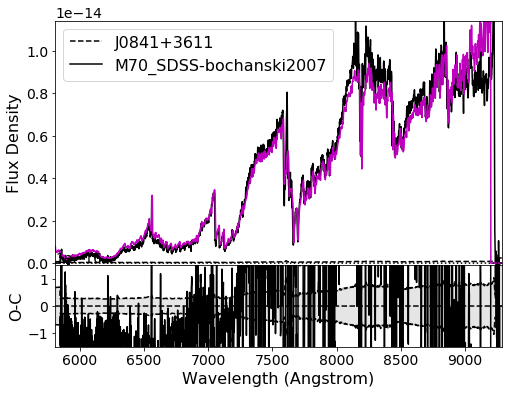

<Figure size 432x288 with 0 Axes>

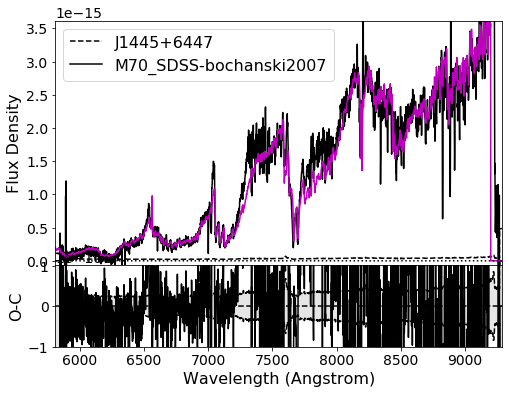

<Figure size 432x288 with 0 Axes>

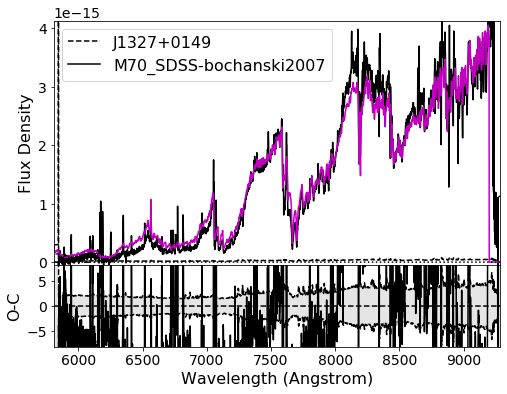

<Figure size 432x288 with 0 Axes>

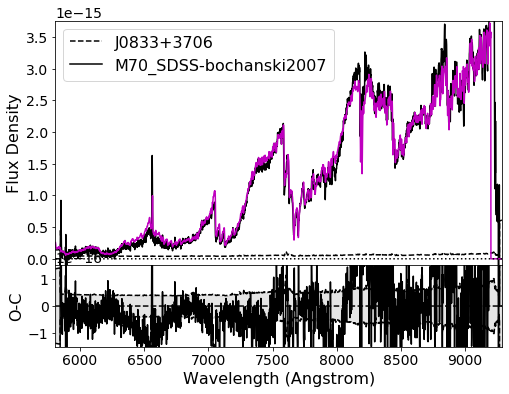

<Figure size 432x288 with 0 Axes>

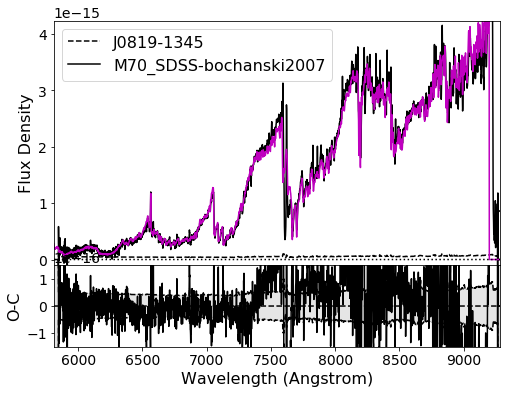

<Figure size 432x288 with 0 Axes>

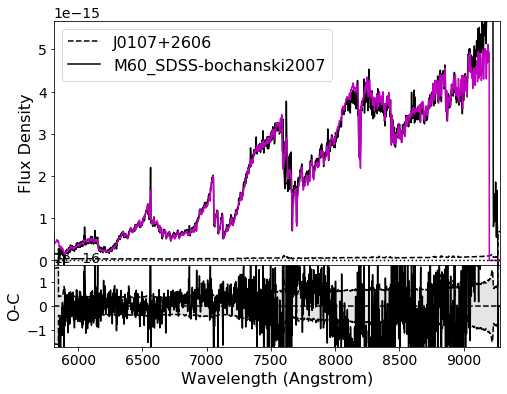

<Figure size 432x288 with 0 Axes>

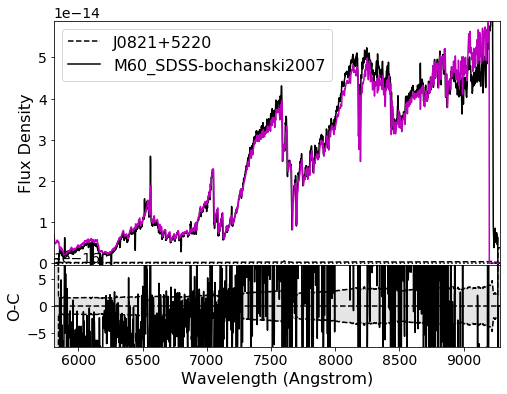

<Figure size 432x288 with 0 Axes>

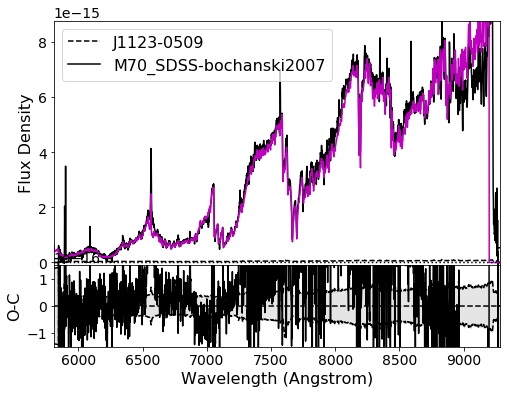

<Figure size 432x288 with 0 Axes>

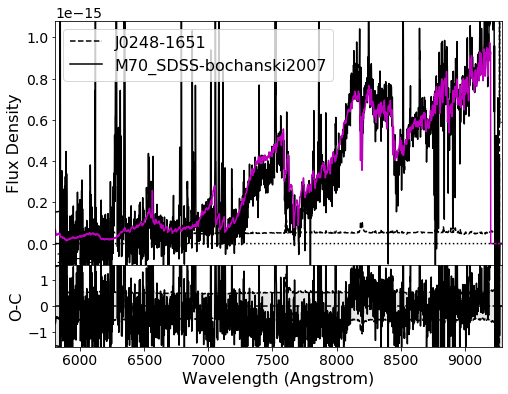

<Figure size 432x288 with 0 Axes>

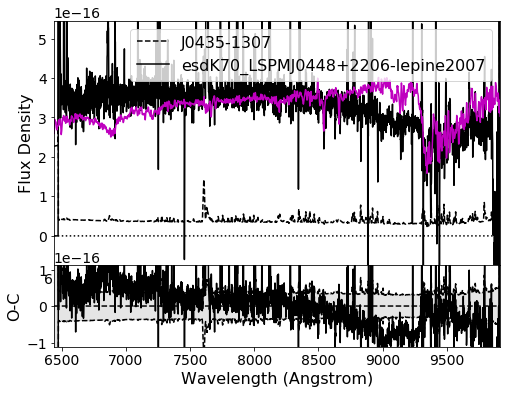

<Figure size 432x288 with 0 Axes>

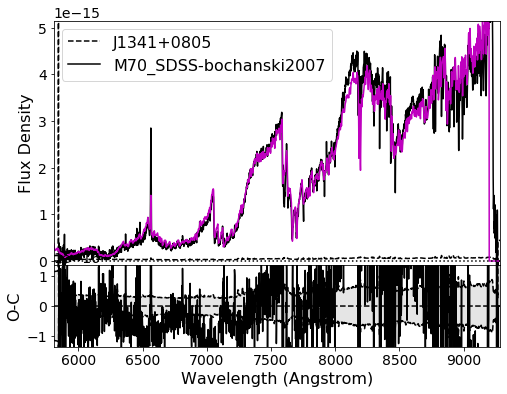

<Figure size 432x288 with 0 Axes>

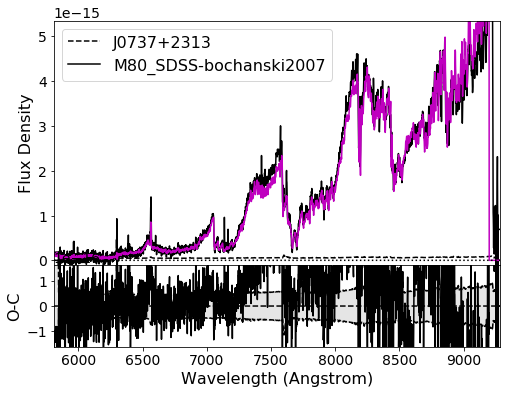

<Figure size 432x288 with 0 Axes>

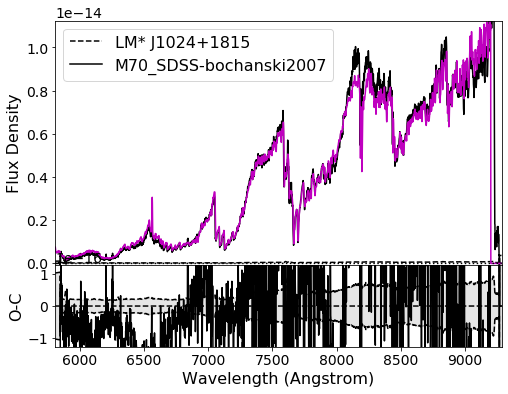

<Figure size 432x288 with 0 Axes>

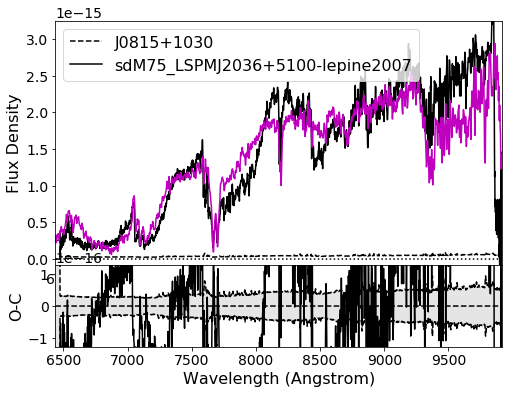

<Figure size 432x288 with 0 Axes>

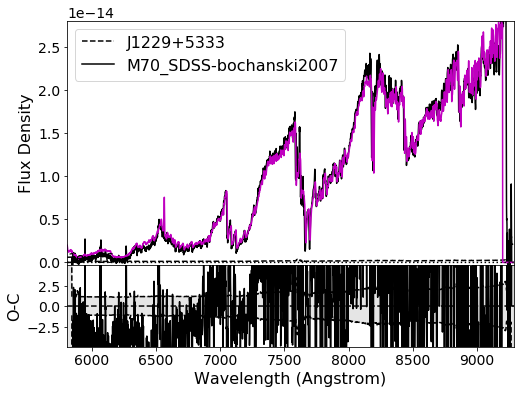

<Figure size 432x288 with 0 Axes>

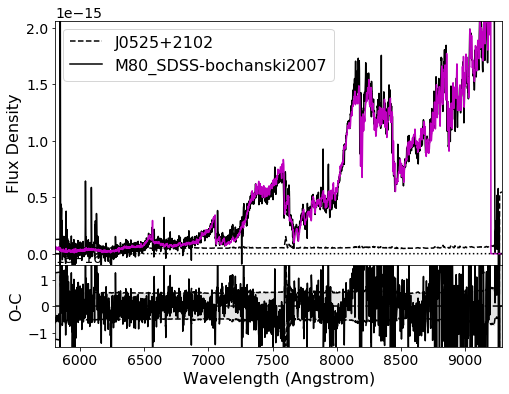

<Figure size 432x288 with 0 Axes>

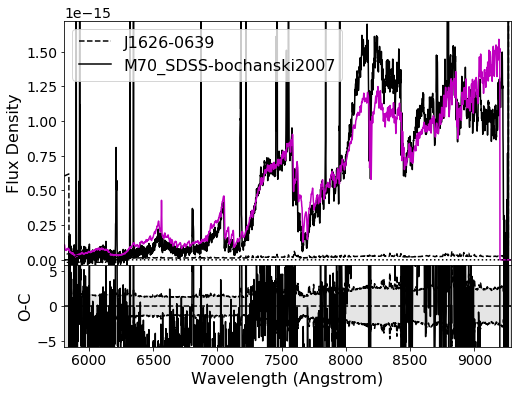

<Figure size 432x288 with 0 Axes>

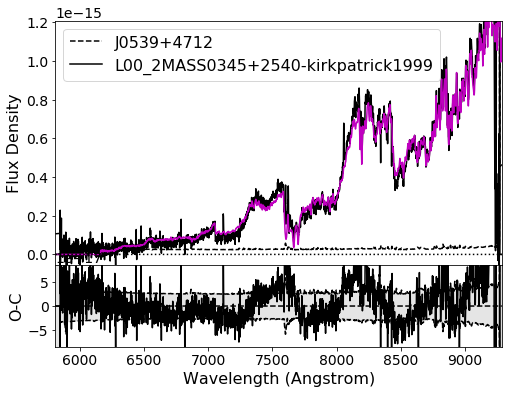

<Figure size 432x288 with 0 Axes>

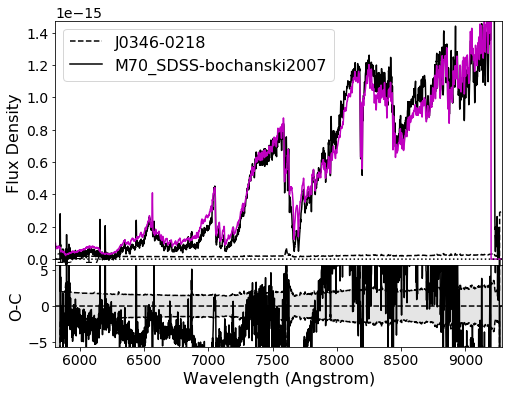

<Figure size 432x288 with 0 Axes>

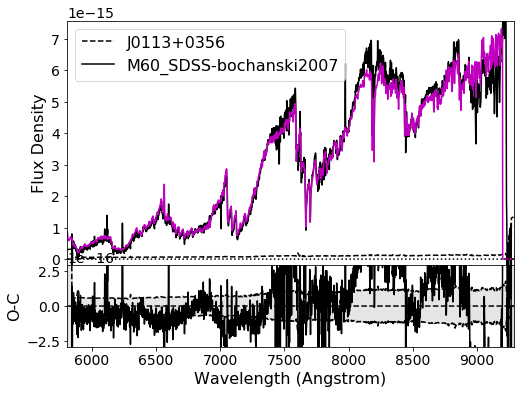

<Figure size 432x288 with 0 Axes>

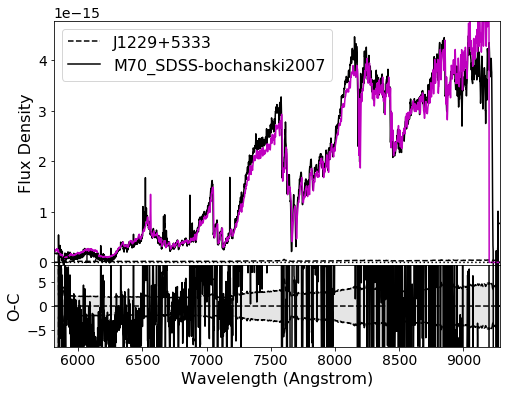

<Figure size 432x288 with 0 Axes>

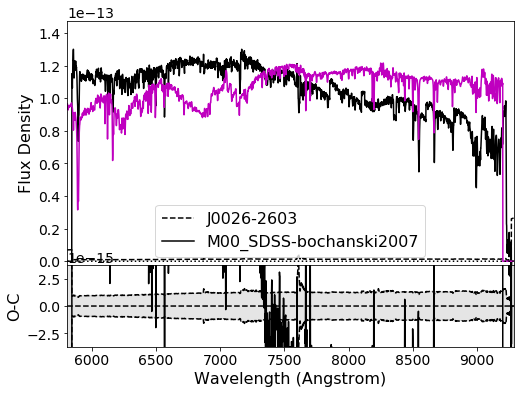

<Figure size 432x288 with 0 Axes>

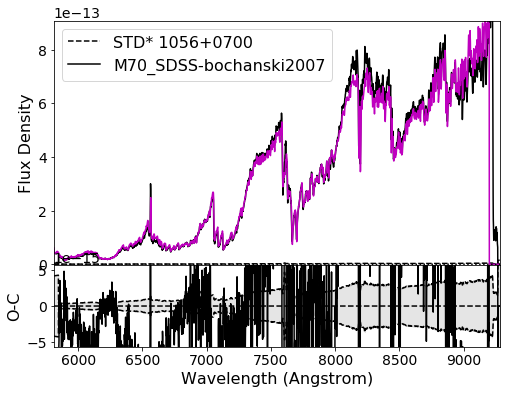

<Figure size 432x288 with 0 Axes>

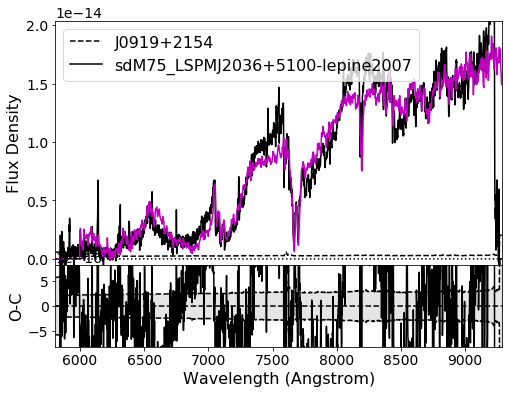

<Figure size 432x288 with 0 Axes>

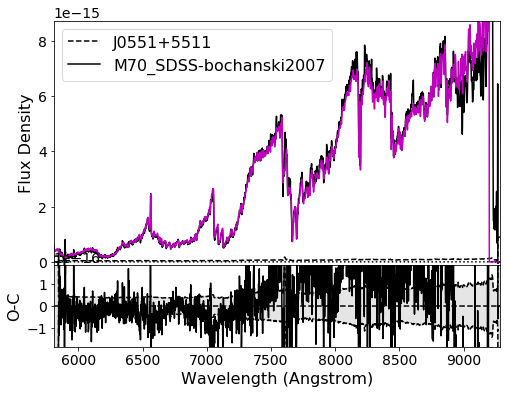

<Figure size 432x288 with 0 Axes>

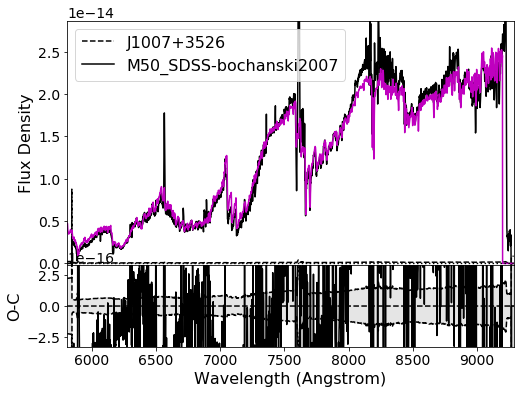

<Figure size 432x288 with 0 Axes>

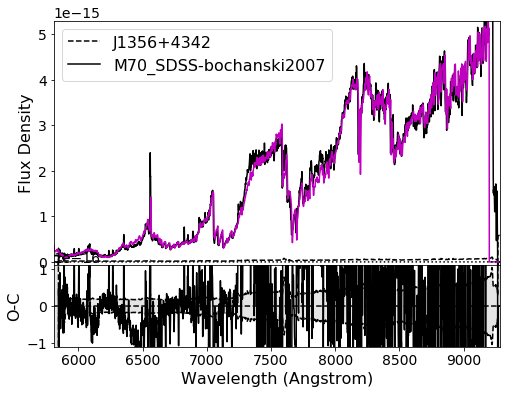

<Figure size 432x288 with 0 Axes>

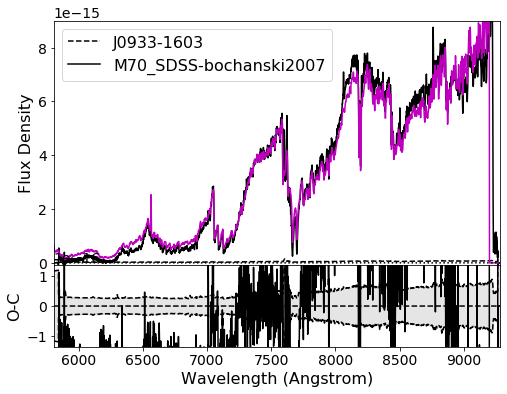

<Figure size 432x288 with 0 Axes>

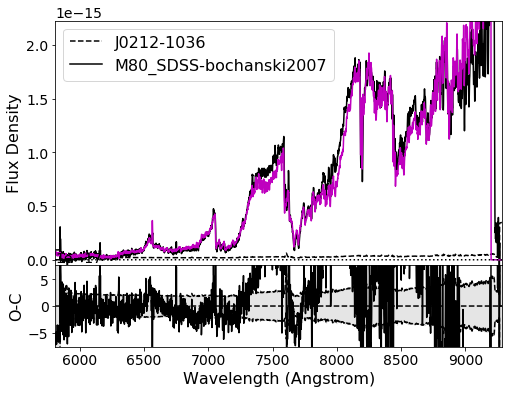

<Figure size 432x288 with 0 Axes>

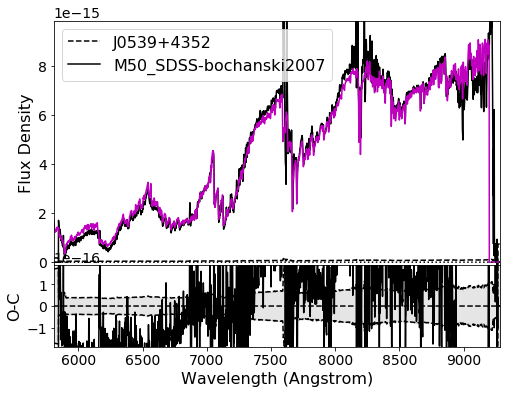

<Figure size 432x288 with 0 Axes>

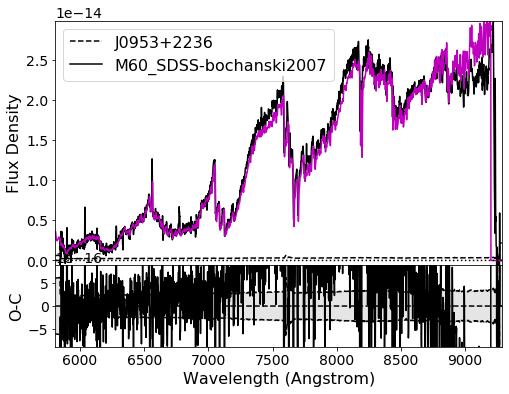

<Figure size 432x288 with 0 Axes>

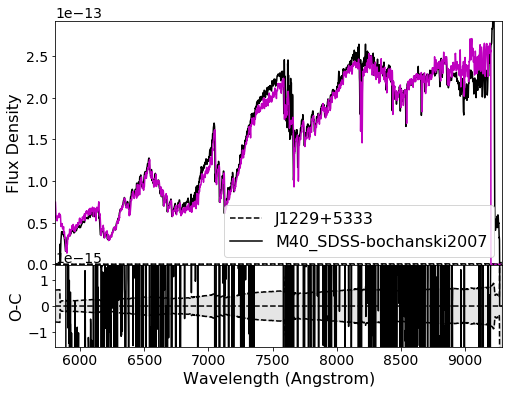

<Figure size 432x288 with 0 Axes>

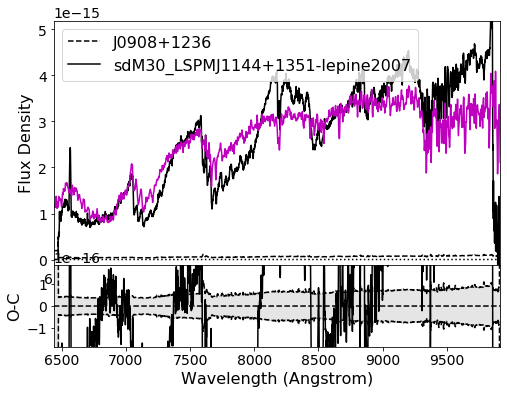

<Figure size 432x288 with 0 Axes>

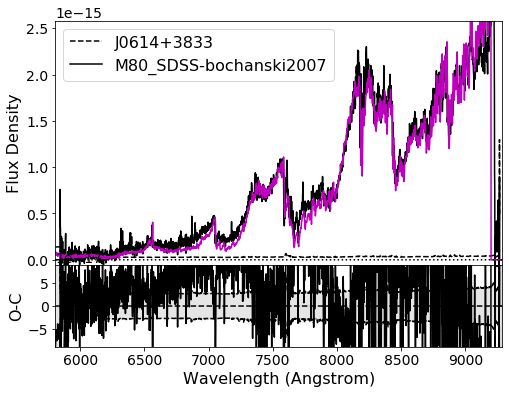

<Figure size 432x288 with 0 Axes>

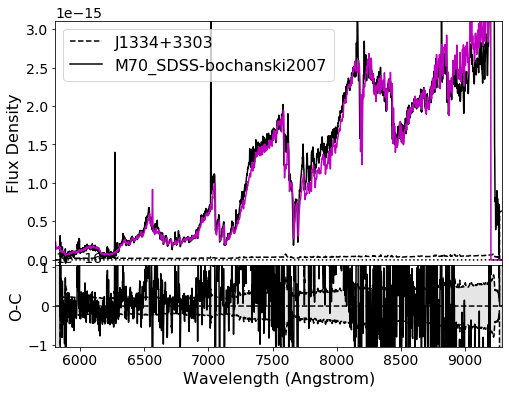

<Figure size 432x288 with 0 Axes>

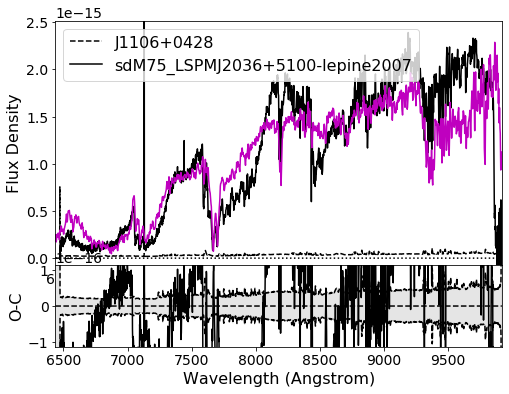

<Figure size 432x288 with 0 Axes>

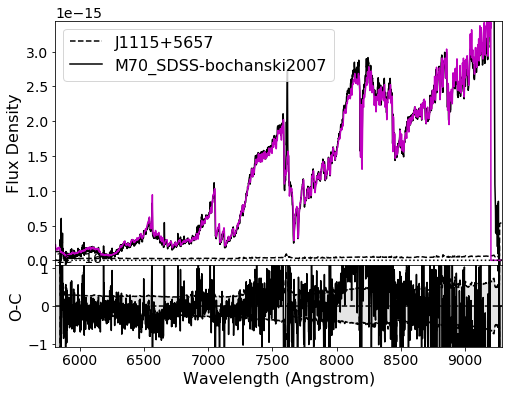

<Figure size 432x288 with 0 Axes>

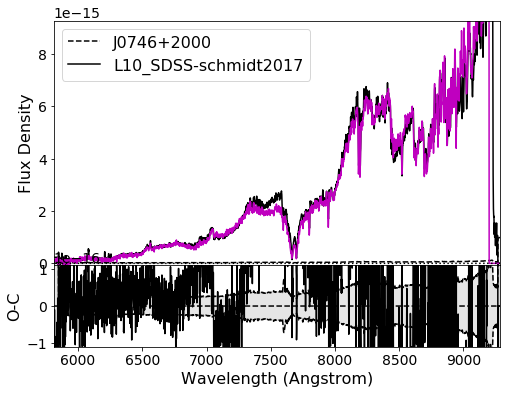

<Figure size 432x288 with 0 Axes>

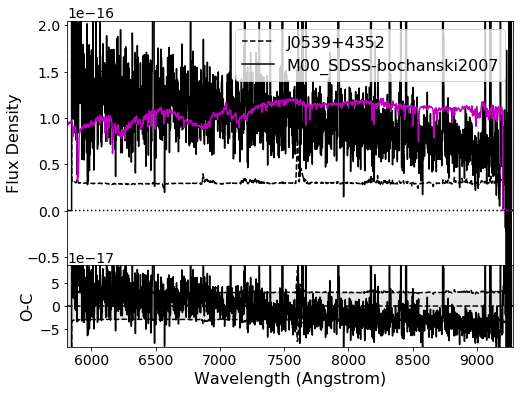

<Figure size 432x288 with 0 Axes>

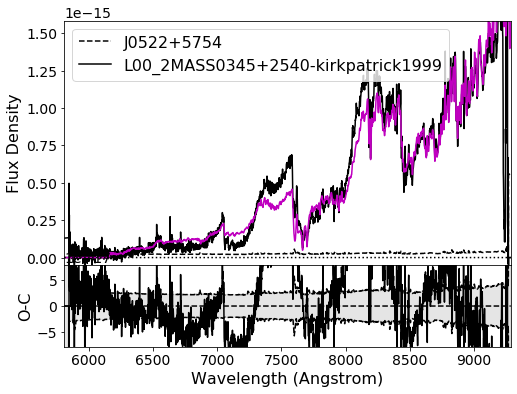

<Figure size 432x288 with 0 Axes>

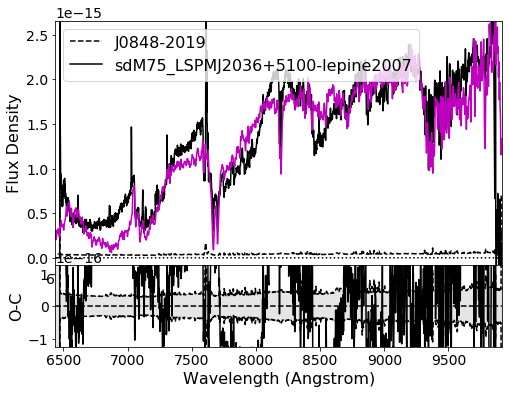

<Figure size 432x288 with 0 Axes>

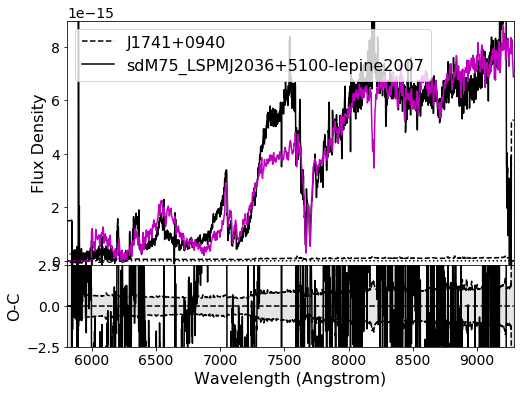

<Figure size 432x288 with 0 Axes>

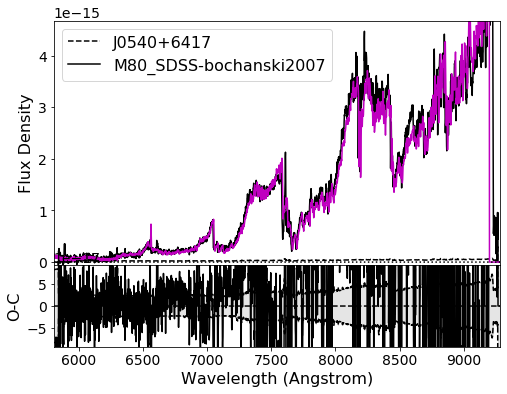

<Figure size 432x288 with 0 Axes>

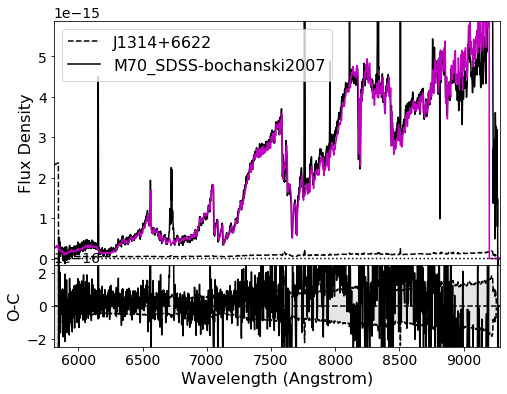

<Figure size 432x288 with 0 Axes>

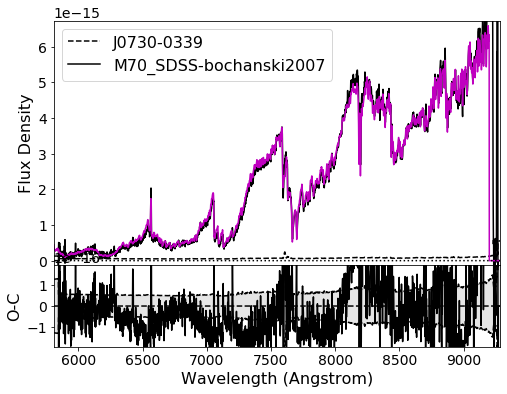

<Figure size 432x288 with 0 Axes>

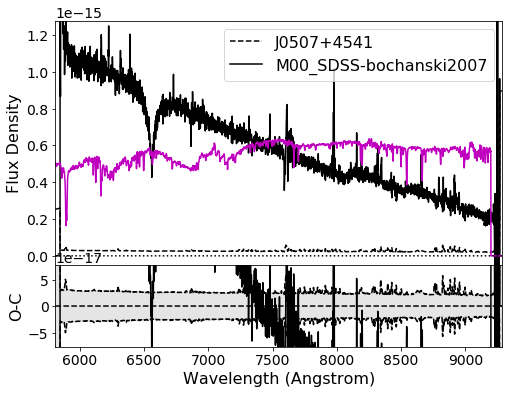

<Figure size 432x288 with 0 Axes>

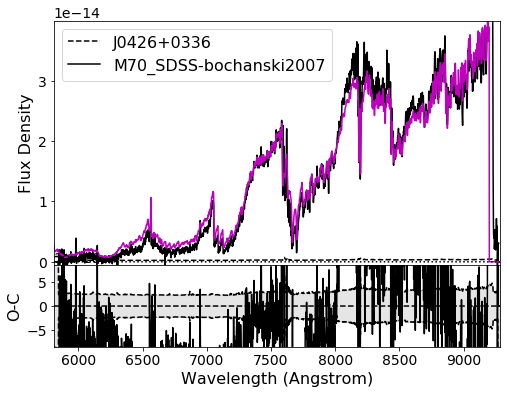

<Figure size 432x288 with 0 Axes>

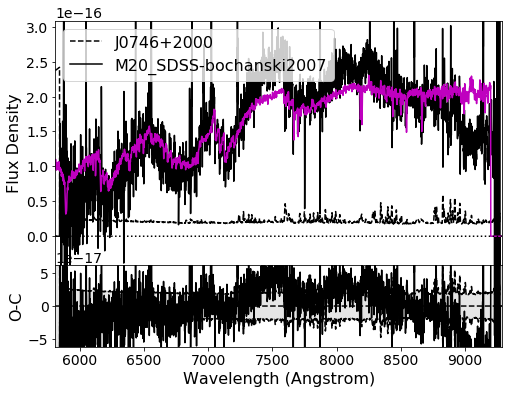

<Figure size 432x288 with 0 Axes>

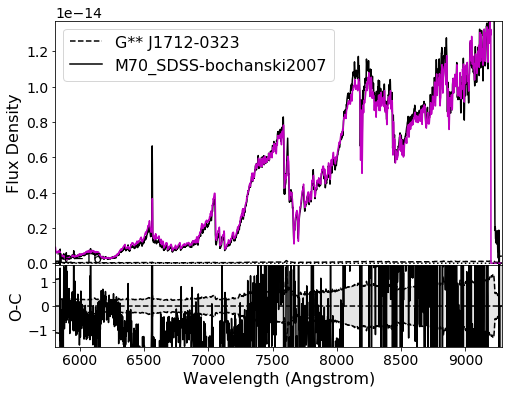

<Figure size 432x288 with 0 Axes>

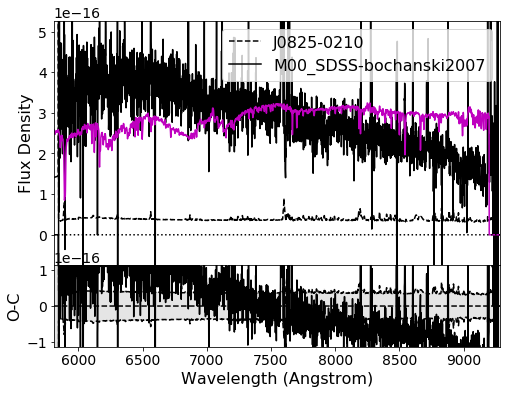

<Figure size 432x288 with 0 Axes>

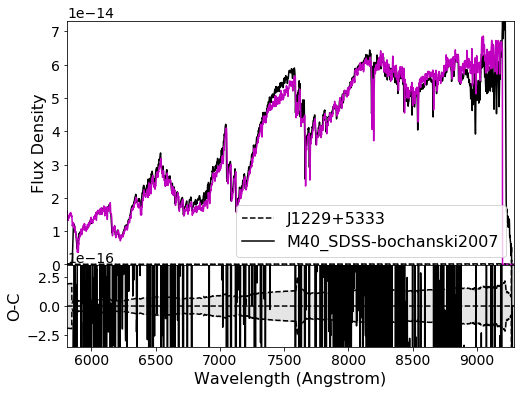

<Figure size 432x288 with 0 Axes>

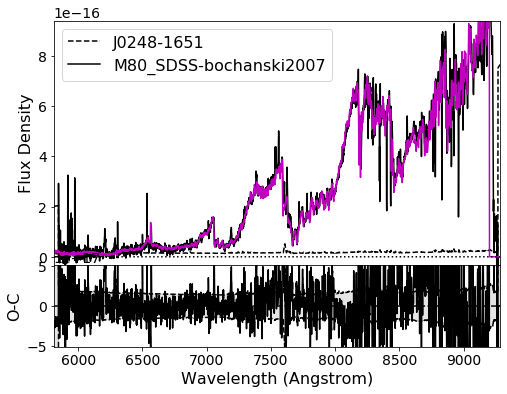

<Figure size 432x288 with 0 Axes>

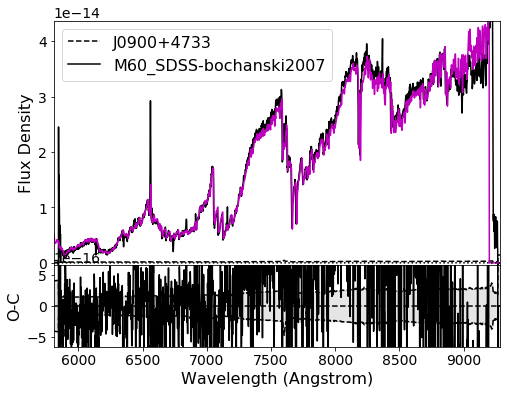

<Figure size 432x288 with 0 Axes>

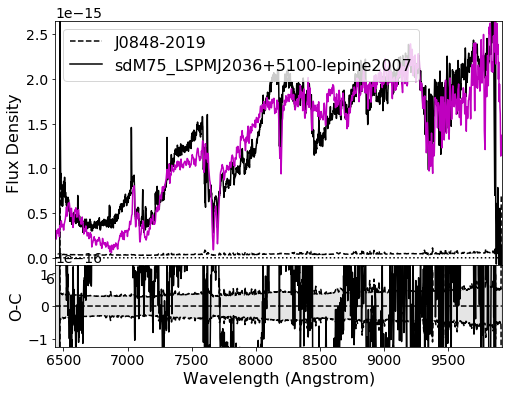

<Figure size 432x288 with 0 Axes>

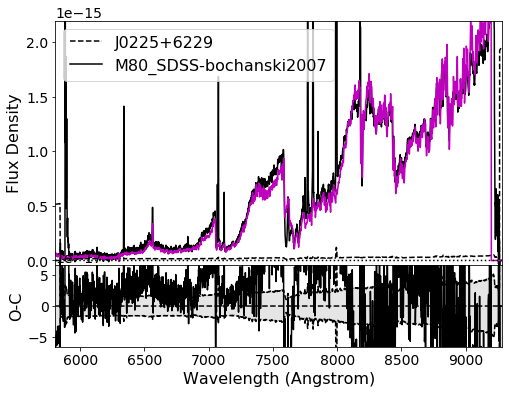

<Figure size 432x288 with 0 Axes>

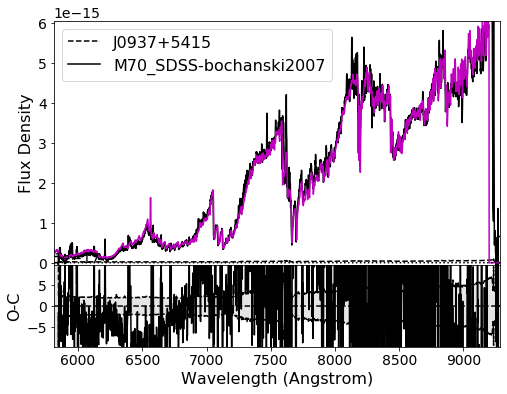

<Figure size 432x288 with 0 Axes>

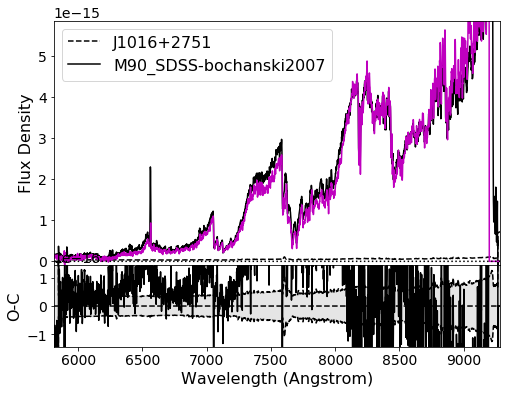

<Figure size 432x288 with 0 Axes>

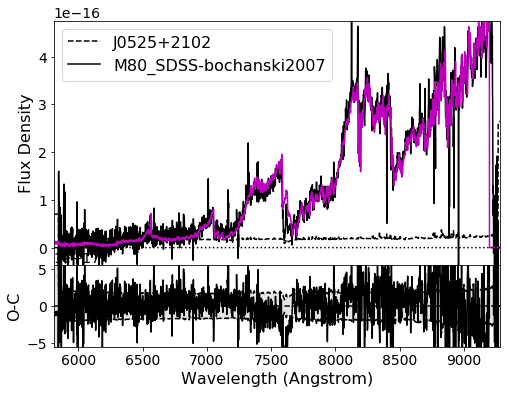

<Figure size 432x288 with 0 Axes>

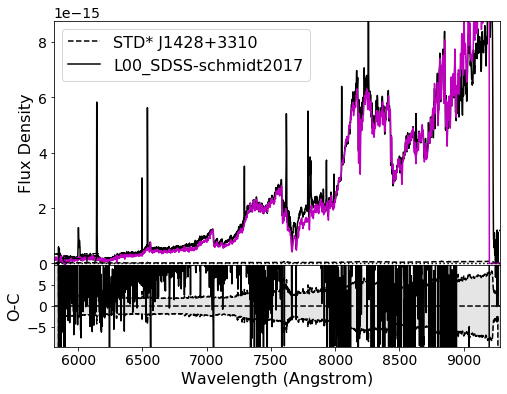

<Figure size 432x288 with 0 Axes>

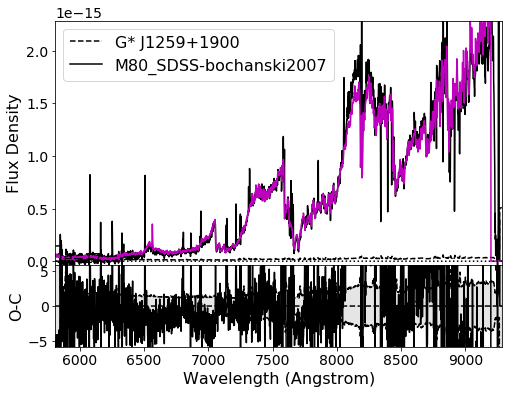

In [11]:
for spec in SPECTRA:
    
    info_dict = {}
    
    name = spec.name
    
    spt = classify_by_standard(spec, ref='all', plot=True)[0]
    plt.pause(1)
    
    subtype = typeToNum(spt) - 10
    
    info_dict['NAME'] = name
    info_dict['TYPE'] = spt
    info_dict['SUBTYPE'] = subtype
    
    for ref in list(kastclassify_index_dict):
        
        info_dict[ref] = measure_index_set(spec, ref=ref, no_trials=0)
        
    stars_df = stars_df.append(info_dict, ignore_index=True)
    
    

In [12]:
stars_df

,NAME,TYPE,SUBTYPE,lepine2007,lepine2003,gizis,reid,kirkpatrick,burgasser,martin
0,J0225+6229,sdM75,7.0,"{'CaH3': (0.595671511465507, nan), 'CaH2': (0....","{'CaH1': (nan, nan), 'CaH2': (0.30450799470747...","{'TiO5': (0.2047271466469788, nan), 'CaH1': (n...","{'TiO1': (0.7336076783534488, nan), 'TiO2': (0...","{'Rb-a': (1.011133760204664, nan), 'Rb-b': (1....","{'CsI(A)': (1.295649515672304, nan), 'CsI(B)':...","{'PC3': (1.5870420703994266, nan), 'PC6': (7.0..."
1,J1300+3038,M60,6.0,"{'CaH3': (0.4931044040258805, nan), 'CaH2': (0...","{'CaH1': (0.8739112856004231, nan), 'CaH2': (0...","{'TiO5': (0.1840211752640596, nan), 'CaH1': (0...","{'TiO1': (0.6680840316687224, nan), 'TiO2': (0...","{'Rb-a': (0.9524741211665089, nan), 'Rb-b': (1...","{'CsI(A)': (1.8493002531680969, nan), 'CsI(B)'...","{'PC3': (1.2293541798396934, nan), 'PC6': (3.4..."
2,J0813-1522,M50,5.0,"{'CaH3': (0.7403900807309968, nan), 'CaH2': (0...","{'CaH1': (0.8249903810553608, nan), 'CaH2': (0...","{'TiO5': (0.48869735804675984, nan), 'CaH1': (...","{'TiO1': (0.9026913666970707, nan), 'TiO2': (0...","{'Rb-a': (1.0691571691706998, nan), 'Rb-b': (1...","{'CsI(A)': (1.8839316296608823, nan), 'CsI(B)'...","{'PC3': (1.1274490086117461, nan), 'PC6': (2.3..."
3,J1102-1624,M60,6.0,"{'CaH3': (0.6796264907127467, nan), 'CaH2': (0...","{'CaH1': (0.7917382115755401, nan), 'CaH2': (0...","{'TiO5': (0.3201211890037243, nan), 'CaH1': (0...","{'TiO1': (0.7491215027007239, nan), 'TiO2': (0...","{'Rb-a': (1.07964135100009, nan), 'Rb-b': (1.0...","{'CsI(A)': (1.8429989207564512, nan), 'CsI(B)'...","{'PC3': (1.2439898943341603, nan), 'PC6': (4.0..."
4,LM* J1054+1214,M70,7.0,"{'CaH3': (0.5574657024475624, nan), 'CaH2': (0...","{'CaH1': (0.734817923281081, nan), 'CaH2': (0....","{'TiO5': (0.19286408325596624, nan), 'CaH1': (...","{'TiO1': (0.7656668305789497, nan), 'TiO2': (0...","{'Rb-a': (1.084849752802353, nan), 'Rb-b': (1....","{'CsI(A)': (1.7736874205994304, nan), 'CsI(B)'...","{'PC3': (1.5929401109693844, nan), 'PC6': (7.7..."
...,...,...,...,...,...,...,...,...,...,...
73,J0937+5415,M70,7.0,"{'CaH3': (0.6426774903195458, nan), 'CaH2': (0...","{'CaH1': (0.9559577187066223, nan), 'CaH2': (0...","{'TiO5': (0.20687961420693685, nan), 'CaH1': (...","{'TiO1': (0.904354194592045, nan), 'TiO2': (0....","{'Rb-a': (1.0419659934223169, nan), 'Rb-b': (1...","{'CsI(A)': (1.801582699139404, nan), 'CsI(B)':...","{'PC3': (1.3464815713642282, nan), 'PC6': (6.8..."
74,J1016+2751,M90,9.0,"{'CaH3': (0.6381371295343389, nan), 'CaH2': (0...","{'CaH1': (0.7455887819390864, nan), 'CaH2': (0...","{'TiO5': (0.2073437607068995, nan), 'CaH1': (0...","{'TiO1': (0.8629153837657614, nan), 'TiO2': (0...","{'Rb-a': (1.0950255888363105, nan), 'Rb-b': (1...","{'CsI(A)': (1.79762804771064, nan), 'CsI(B)': ...","{'PC3': (1.562557484153589, nan), 'PC6': (10.6..."
75,J0525+2102,M80,8.0,"{'CaH3': (0.6549647361112406, nan), 'CaH2': (0...","{'CaH1': (0.8919266952084587, nan), 'CaH2': (0...","{'TiO5': (0.4494940843321574, nan), 'CaH1': (0...","{'TiO1': (1.1752656746353136, nan), 'TiO2': (0...","{'Rb-a': (0.9755674618589958, nan), 'Rb-b': (1...","{'CsI(A)': (1.7344640251594317, nan), 'CsI(B)'...","{'PC3': (2.1743495449289023, nan), 'PC6': (14...."
76,STD* J1428+3310,L00,10.0,"{'CaH3': (0.7809635464047836, nan), 'CaH2': (0...","{'CaH1': (1.01274487675279, nan), 'CaH2': (0.5...","{'TiO5': (0.5817926001214057, nan), 'CaH1': (1...","{'TiO1': (0.9248160197319394, nan), 'TiO2': (0...","{'Rb-a': (0.9534902708469284, nan), 'Rb-b': (1...","{'CsI(A)': (1.7744760755645532, nan), 'CsI(B)'...","{'PC3': (2.4878358815032504, nan), 'PC6': (10...."


In [31]:
stars_df.to_excel('Kast_stars.xlsx', index=False)

In [26]:
not np.any(sp1.flux.value < 1e-22)

False

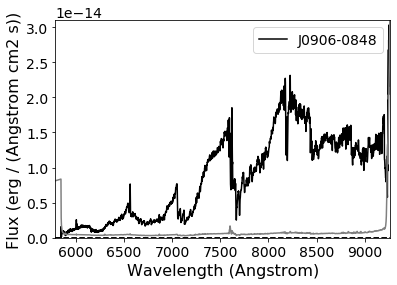

In [23]:
sp1.plot()

In [20]:
#reading Lepine dataset

file_path = '/home/ryan/projects/KASTr_data/PMstars_spectra/'

suffix = '*.fits'

filepaths = glob.glob(file_path + suffix)

SPECTRA = []
for filepath in filepaths:
    
    spectrum = kastredux.readSpectrum(filepath)
    
    spectrum.unc = spectrum.flux * 0.01
    
    spectrum.name = os.path.basename(os.path.splitext(filepath)[0])
    
    SPECTRA.append(spectrum)
    
    

In [21]:
data_file_path = '/home/ryan/projects/KASTr_data/PMstars_spectra/calculated_spectral_types.tab'

df = pd.read_csv(data_file_path, skiprows=(1,), delim_whitespace=True)

df['STAR'] = [star[:-5] for star in df['STAR']]

df

,STAR,col-M,CAH2,CAH3,TIO5,TIO6,TIO7,VO1,VO2,CLASS,SUBTYPE,ZETA
0,PM_I00012+0659.ms,3.0537,0.31471,0.59992,0.27452,0.48775,0.0,0.89118,0.69525,M,5.5,0.89664
1,PM_I00013+3416.ms,1.0487,0.77680,0.88768,0.84750,0.97106,0.0,0.95739,1.00360,esdK,7.5,0.35709
2,PM_I00014-1656.ms,1.1343,0.72565,0.86633,0.80926,0.94968,0.0,0.96336,0.97543,esdM,0.0,0.42673
3,PM_I00019-0600.ms,1.4584,0.61122,0.87779,0.46752,0.71657,0.0,0.97084,0.98949,M,2.0,1.09200
4,PM_I00020+4104.ms,1.0952,0.75253,0.85451,0.83515,0.94626,0.0,0.98839,1.03290,esdM,0.0,0.37280
...,...,...,...,...,...,...,...,...,...,...,...,...
4973,PM_I23583+1234W.ms,1.6001,0.47335,0.66581,0.74273,0.95559,0.0,0.96925,0.90312,esdM,3.5,0.37544
4974,PM_I23587+4643.ms,1.1202,0.72646,0.84443,0.79992,0.94205,0.0,0.96664,1.01110,esdM,0.0,0.44049
4975,PM_I23590+2051.ms,1.6306,0.49924,0.75046,0.52593,0.72255,0.0,0.93871,0.91411,sdM,2.5,0.76687
4976,PM_I23595+4255.ms,1.7925,0.45819,0.72335,0.46709,0.71775,0.0,0.92404,0.83843,sdM,3.0,0.80799


In [22]:
df_sorted = df.sort_values(by='STAR')

In [23]:
SPTYPES = [typeToNum(spclass + str(subtype)) - 10 for spclass, subtype in zip(df_sorted['CLASS'], df_sorted['SUBTYPE'])]

SPTYPES

[5.5,
 -2.5,
 0.0,
 2.0,
 0.0,
 5.5,
 4.0,
 1.0,
 7.5,
 5.0,
 2.0,
 4.0,
 4.5,
 0.0,
 2.5,
 4.5,
 5.5,
 3.5,
 3.0,
 4.0,
 4.5,
 3.5,
 -2.5,
 3.0,
 0.0,
 -2.5,
 1.0,
 3.0,
 3.5,
 2.5,
 0.5,
 -2.5,
 2.0,
 4.5,
 4.0,
 2.5,
 3.5,
 4.0,
 4.5,
 -4.5,
 2.0,
 3.0,
 4.0,
 4.0,
 4.5,
 3.5,
 -2.5,
 -2.5,
 3.5,
 0.0,
 1.0,
 8.0,
 1.0,
 4.0,
 4.0,
 3.5,
 6.0,
 4.5,
 -3.0,
 2.0,
 2.5,
 5.5,
 3.0,
 3.0,
 4.5,
 0.0,
 2.0,
 0.0,
 4.0,
 0.0,
 4.0,
 7.0,
 4.0,
 4.5,
 2.0,
 3.5,
 4.0,
 1.0,
 2.0,
 1.5,
 2.0,
 -2.5,
 6.0,
 3.0,
 3.5,
 0.0,
 8.5,
 4.0,
 4.5,
 0.5,
 2.0,
 -3.0,
 1.5,
 4.0,
 1.0,
 -2.5,
 1.0,
 -2.5,
 4.0,
 4.0,
 2.5,
 0.0,
 0.0,
 4.0,
 2.0,
 4.5,
 4.0,
 3.0,
 0.0,
 2.5,
 4.0,
 -2.5,
 4.0,
 3.0,
 3.0,
 -2.5,
 5.0,
 6.0,
 4.5,
 -2.5,
 7.0,
 4.0,
 2.5,
 2.0,
 0.5,
 0.5,
 0.0,
 3.5,
 0.5,
 3.0,
 4.0,
 2.5,
 4.0,
 2.5,
 -2.5,
 1.0,
 3.5,
 4.0,
 3.5,
 1.0,
 2.0,
 2.5,
 1.5,
 0.0,
 4.0,
 4.5,
 0.0,
 4.0,
 4.0,
 3.5,
 5.0,
 3.0,
 4.0,
 6.5,
 2.5,
 0.0,
 5.0,
 5.5,
 1.5,
 1.5,
 3.5,
 4.0,
 2.0,
 3.5,


In [24]:
df_sorted['SPTYPES'] = SPTYPES
df_sorted

,STAR,col-M,CAH2,CAH3,TIO5,TIO6,TIO7,VO1,VO2,CLASS,SUBTYPE,ZETA,SPTYPES
0,PM_I00012+0659.ms,3.0537,0.31471,0.59992,0.27452,0.48775,0.0,0.89118,0.69525,M,5.5,0.89664,5.5
1,PM_I00013+3416.ms,1.0487,0.77680,0.88768,0.84750,0.97106,0.0,0.95739,1.00360,esdK,7.5,0.35709,-2.5
2,PM_I00014-1656.ms,1.1343,0.72565,0.86633,0.80926,0.94968,0.0,0.96336,0.97543,esdM,0.0,0.42673,0.0
3,PM_I00019-0600.ms,1.4584,0.61122,0.87779,0.46752,0.71657,0.0,0.97084,0.98949,M,2.0,1.09200,2.0
4,PM_I00020+4104.ms,1.0952,0.75253,0.85451,0.83515,0.94626,0.0,0.98839,1.03290,esdM,0.0,0.37280,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
4973,PM_I23583+1234W.ms,1.6001,0.47335,0.66581,0.74273,0.95559,0.0,0.96925,0.90312,esdM,3.5,0.37544,3.5
4974,PM_I23587+4643.ms,1.1202,0.72646,0.84443,0.79992,0.94205,0.0,0.96664,1.01110,esdM,0.0,0.44049,0.0
4975,PM_I23590+2051.ms,1.6306,0.49924,0.75046,0.52593,0.72255,0.0,0.93871,0.91411,sdM,2.5,0.76687,2.5
4976,PM_I23595+4255.ms,1.7925,0.45819,0.72335,0.46709,0.71775,0.0,0.92404,0.83843,sdM,3.0,0.80799,3.0


In [25]:
def compile_spec_info(SPECLIST):
    
    name = []
    cah2 = []
    cah3 = []
    tio5 = []
    subtype = []
    
    for spec in SPECLIST:
        
        if( (df_sorted[ df_sorted['STAR'] == spec.name]['SPTYPES'] > 5).all(axis=None) ):

            name.append(spec.name)

            classinfo1 = classify_by_standard(spec, ref='all', plot=True)

            spt = -100000000
            chi2 = 100000000
            spt = classinfo1[0]
            chi2 = classinfo1[2]

            plt.pause(1)
            print('Type: {}, chi2: {:.2f}'.format(spt, chi2))
            
            sub = typeToNum(spt) - 10

            subtype.append(sub)

            #get the index info
            #just lepine for now

            indices = measure_index_set(spec, no_trials=0)

            cah2.append(indices['CaH2'][0])
            cah3.append(indices['CaH3'][0])
            tio5.append(indices['TiO5'][0])
        
    
    return name, cah2, cah3, tio5, subtype

<Figure size 432x288 with 0 Axes>

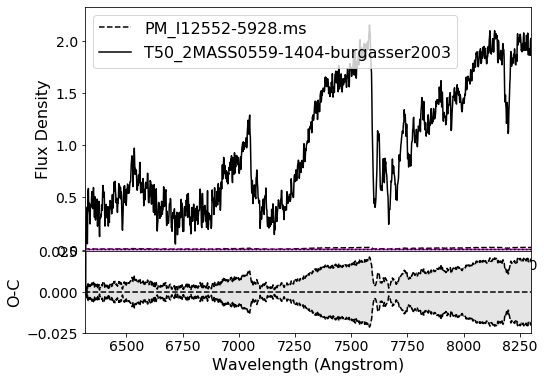

Type: T50, chi2: 13200000.57


<Figure size 432x288 with 0 Axes>

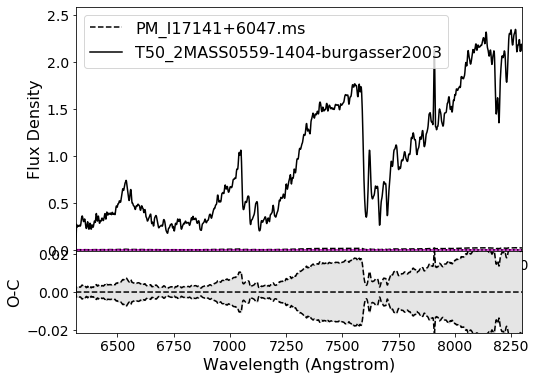

Type: T50, chi2: 13230000.62


<Figure size 432x288 with 0 Axes>

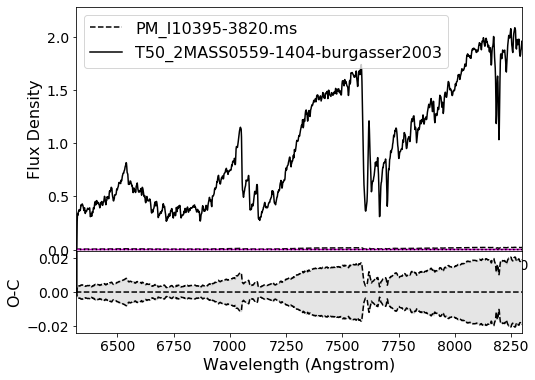

Type: T50, chi2: 13200000.61


<Figure size 432x288 with 0 Axes>

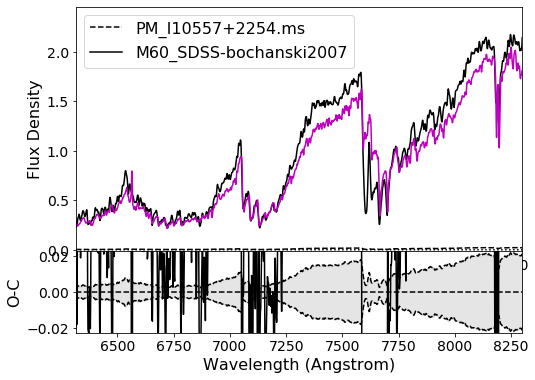

Type: M60, chi2: 735804.34


<Figure size 432x288 with 0 Axes>

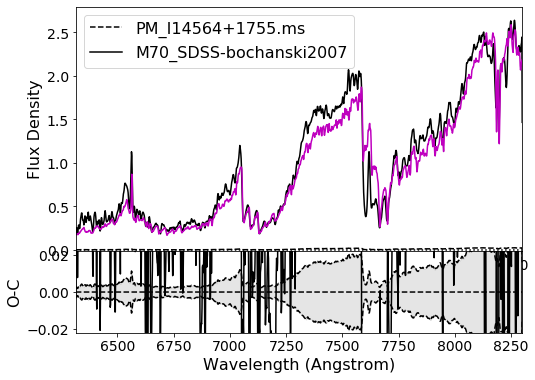

Type: M70, chi2: 826080.19


<Figure size 432x288 with 0 Axes>

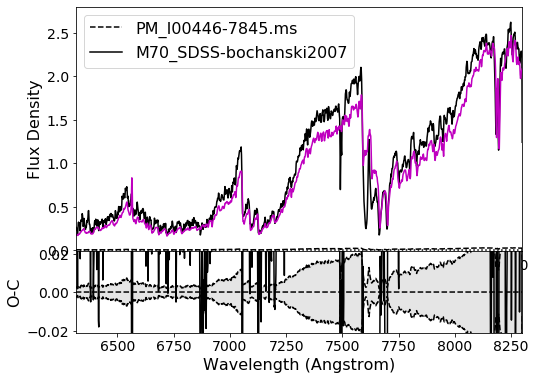

Type: M70, chi2: 1233942.78


<Figure size 432x288 with 0 Axes>

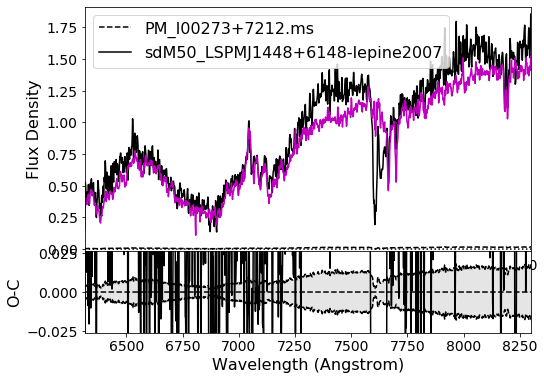

Type: sdM50, chi2: 991018.89


<Figure size 432x288 with 0 Axes>

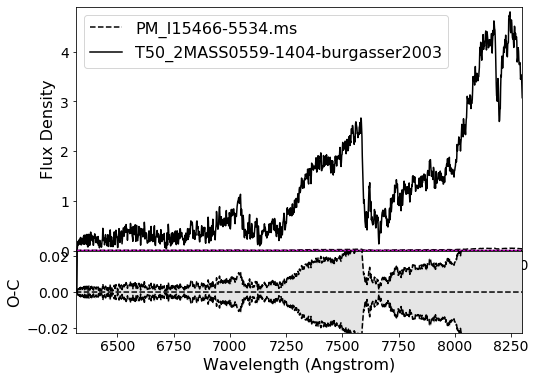

Type: T50, chi2: 13210000.58


<Figure size 432x288 with 0 Axes>

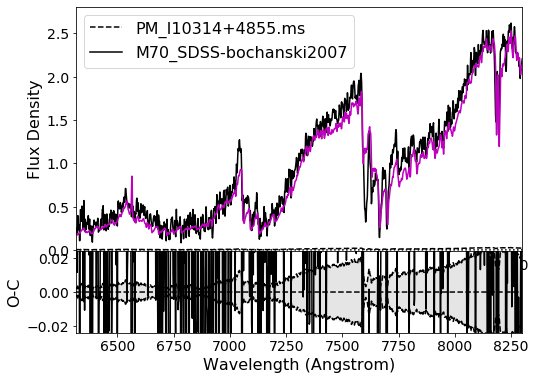

Type: M70, chi2: 982818.87


<Figure size 432x288 with 0 Axes>

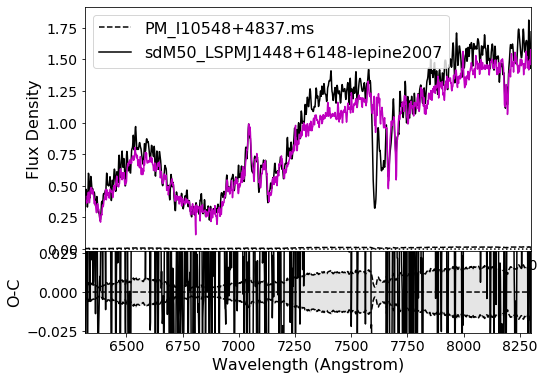

Type: sdM50, chi2: 581323.25


<Figure size 432x288 with 0 Axes>

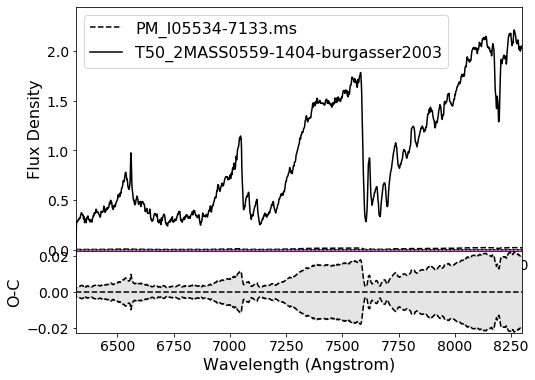

Type: T50, chi2: 13230000.58


<Figure size 432x288 with 0 Axes>

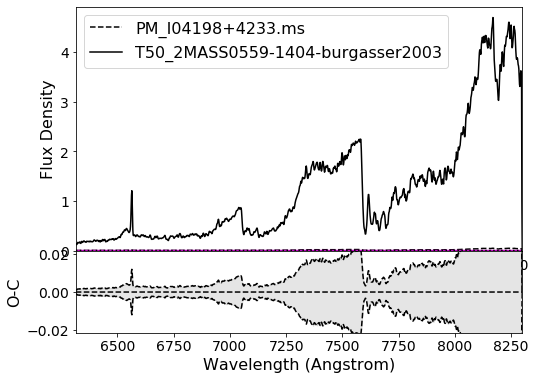

Type: T50, chi2: 13230000.61


<Figure size 432x288 with 0 Axes>

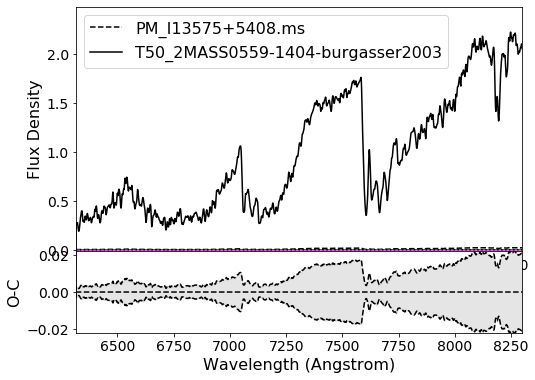

Type: T50, chi2: 13230000.60


<Figure size 432x288 with 0 Axes>

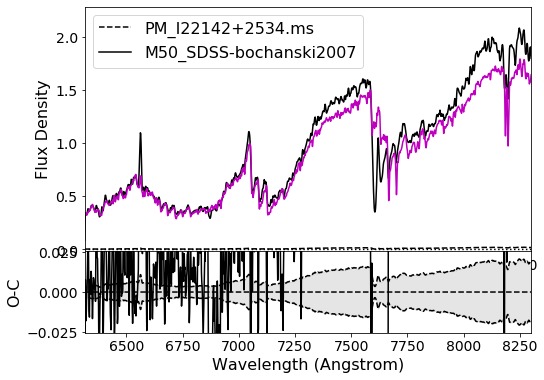

Type: M50, chi2: 607803.86


<Figure size 432x288 with 0 Axes>

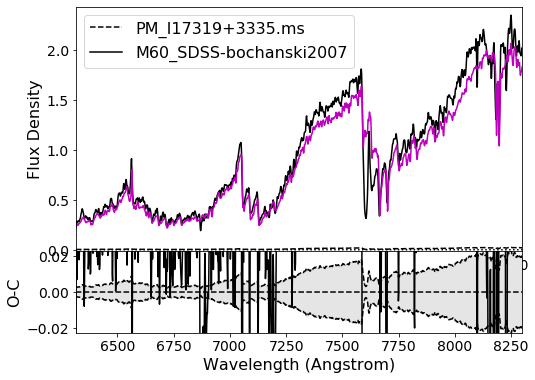

Type: M60, chi2: 708497.03


<Figure size 432x288 with 0 Axes>

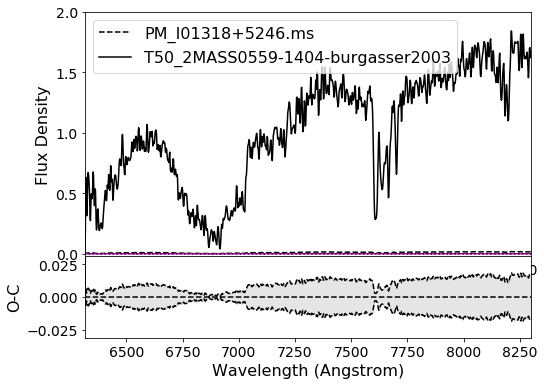

Type: T50, chi2: 13220000.60


<Figure size 432x288 with 0 Axes>

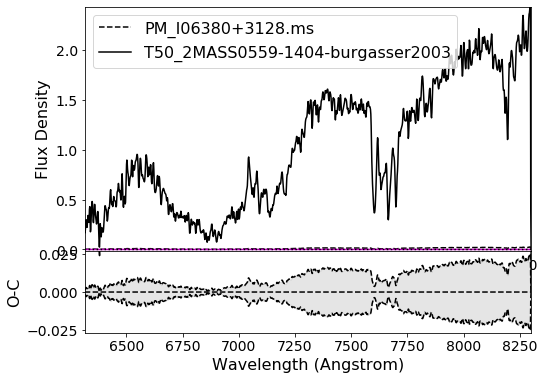

Type: T50, chi2: 13230000.59


<Figure size 432x288 with 0 Axes>

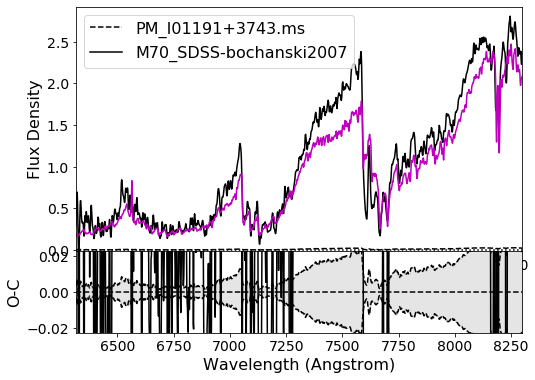

Type: M70, chi2: 1245292.89


<Figure size 432x288 with 0 Axes>

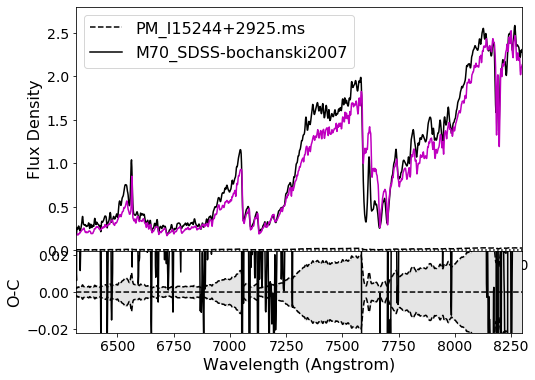

Type: M70, chi2: 970594.20


<Figure size 432x288 with 0 Axes>

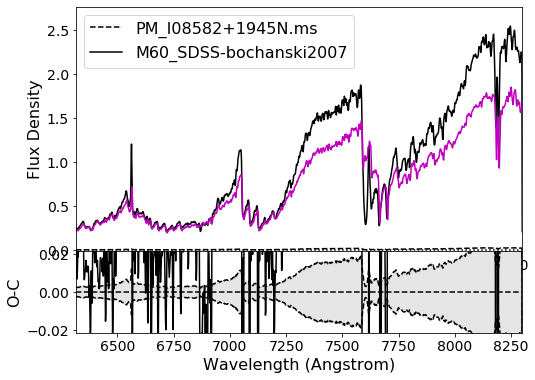

Type: M60, chi2: 1442154.64


<Figure size 432x288 with 0 Axes>

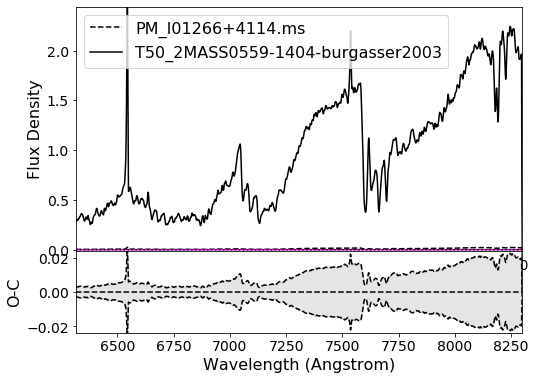

Type: T50, chi2: 13230000.60


<Figure size 432x288 with 0 Axes>

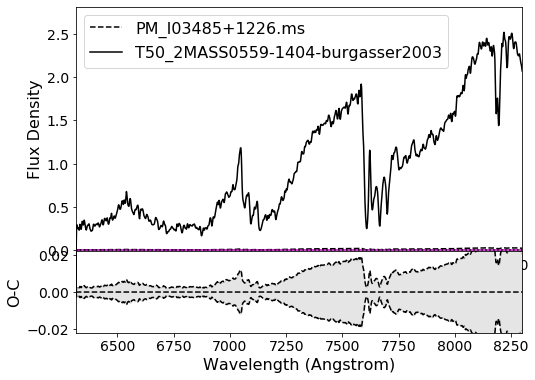

Type: T50, chi2: 13220000.61


<Figure size 432x288 with 0 Axes>

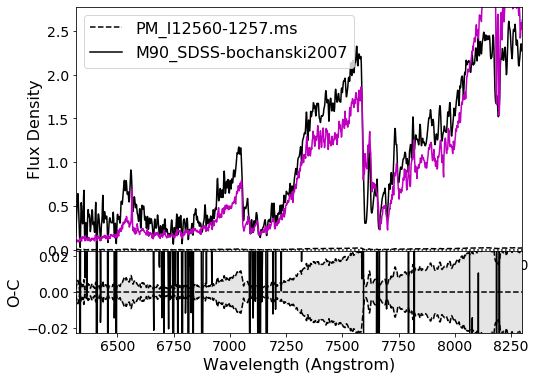

Type: M90, chi2: 2242390.69


<Figure size 432x288 with 0 Axes>

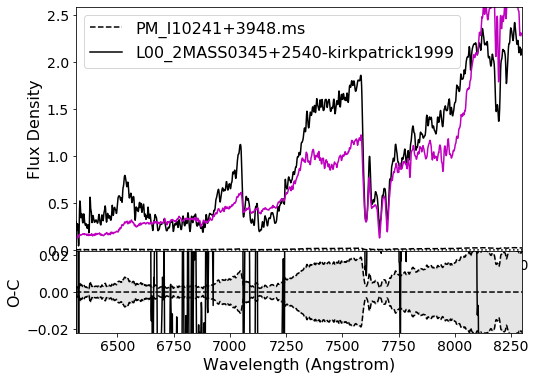

Type: L00, chi2: 1741174.81


<Figure size 432x288 with 0 Axes>

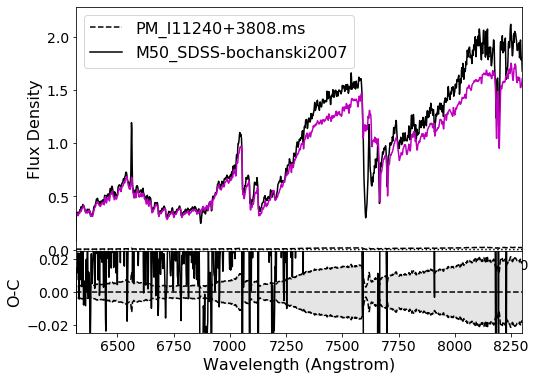

Type: M50, chi2: 721188.29


<Figure size 432x288 with 0 Axes>

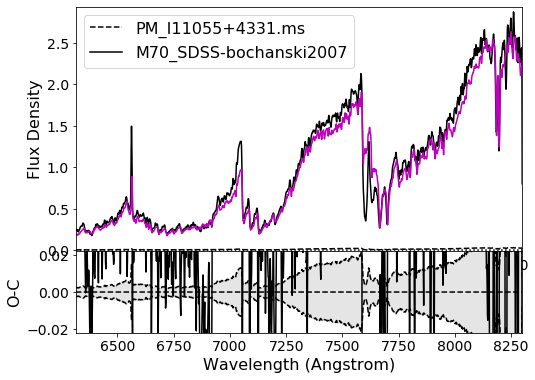

Type: M70, chi2: 615954.78


<Figure size 432x288 with 0 Axes>

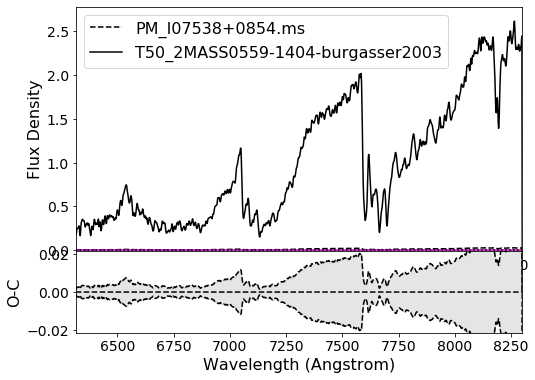

Type: T50, chi2: 13230000.59


<Figure size 432x288 with 0 Axes>

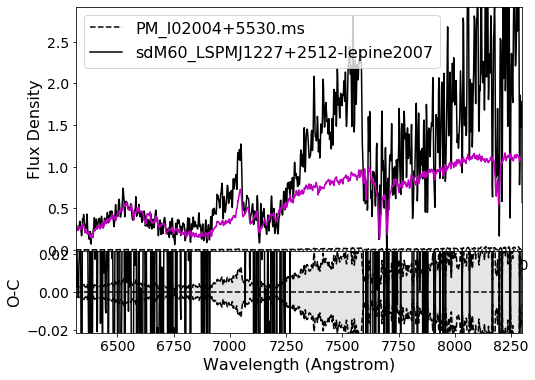

Type: sdM60, chi2: 2806753.66


<Figure size 432x288 with 0 Axes>

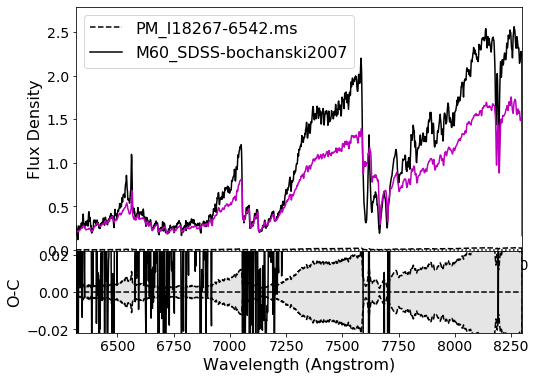

Type: M60, chi2: 1873635.75


<Figure size 432x288 with 0 Axes>

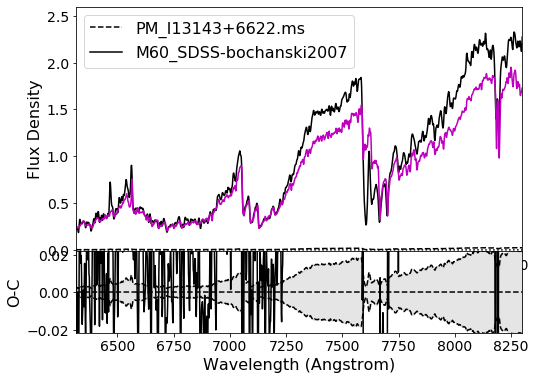

Type: M60, chi2: 903529.81


<Figure size 432x288 with 0 Axes>

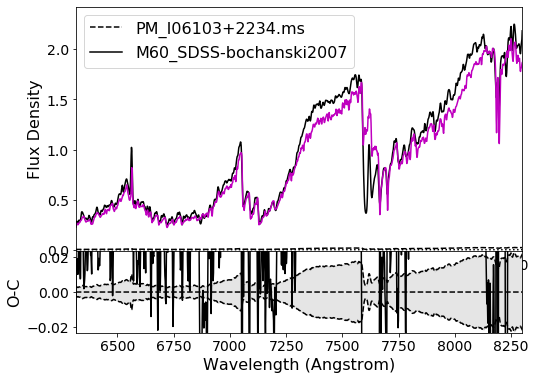

Type: M60, chi2: 593416.23


<Figure size 432x288 with 0 Axes>

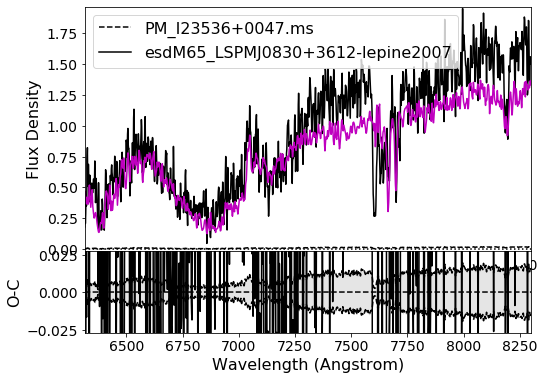

Type: esdM65, chi2: 1398751.43


<Figure size 432x288 with 0 Axes>

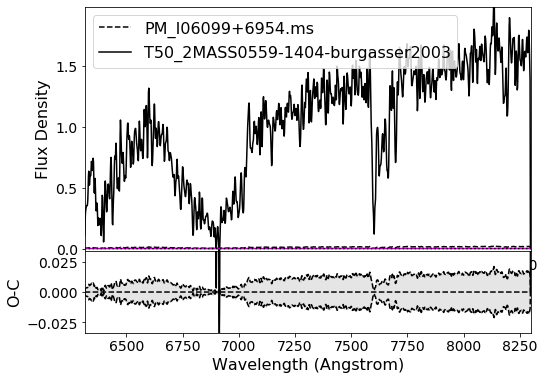

Type: T50, chi2: 13210000.59


<Figure size 432x288 with 0 Axes>

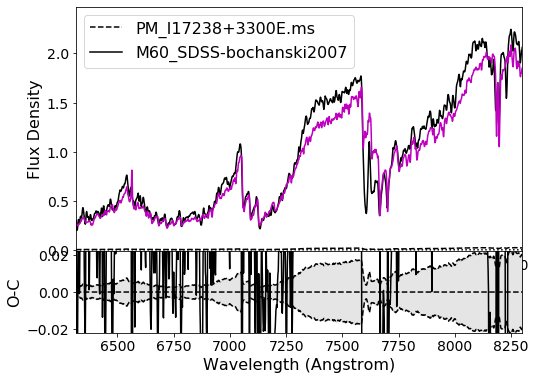

Type: M60, chi2: 587075.15


<Figure size 432x288 with 0 Axes>

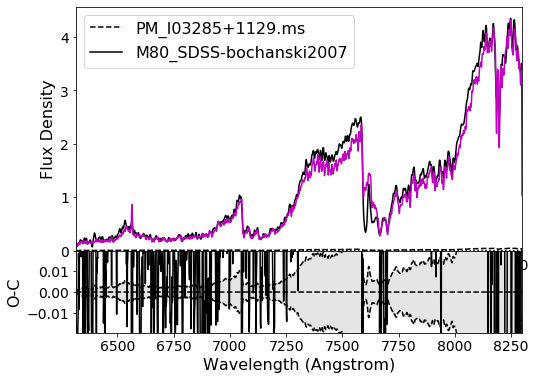

Type: M80, chi2: 732056.39


<Figure size 432x288 with 0 Axes>

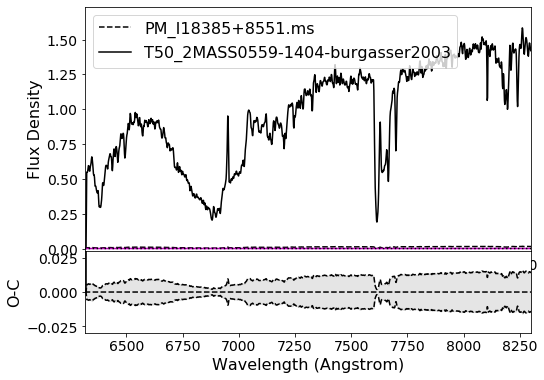

Type: T50, chi2: 13190000.58


<Figure size 432x288 with 0 Axes>

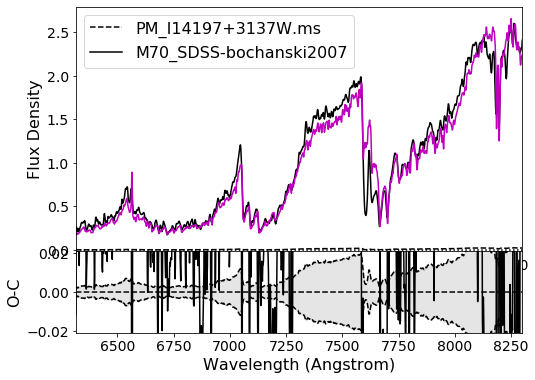

Type: M70, chi2: 590381.50


<Figure size 432x288 with 0 Axes>

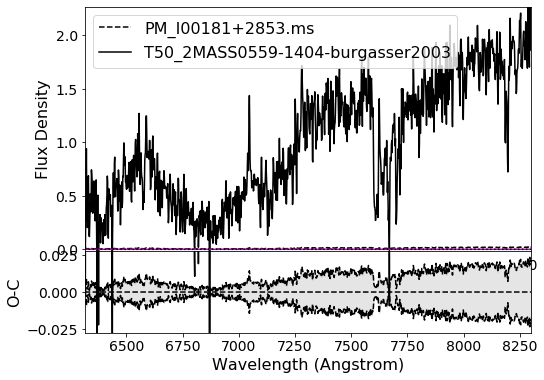

Type: T50, chi2: 13210000.62


<Figure size 432x288 with 0 Axes>

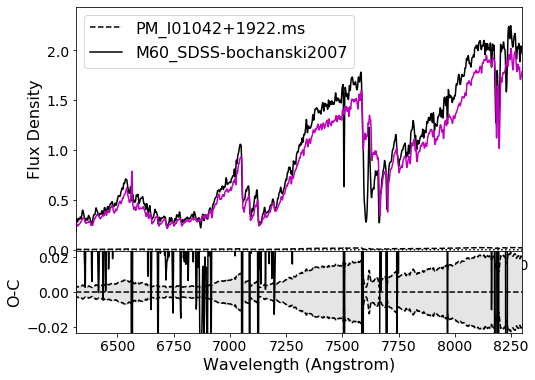

Type: M60, chi2: 917606.13


<Figure size 432x288 with 0 Axes>

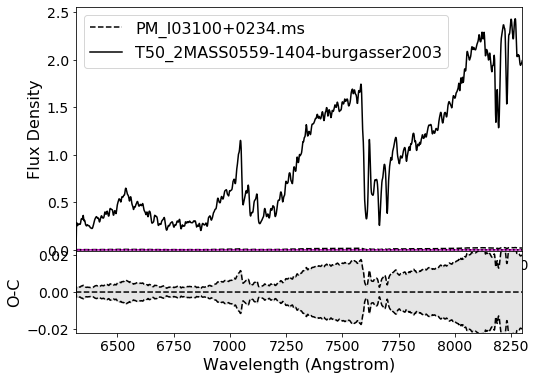

Type: T50, chi2: 13230000.60


<Figure size 432x288 with 0 Axes>

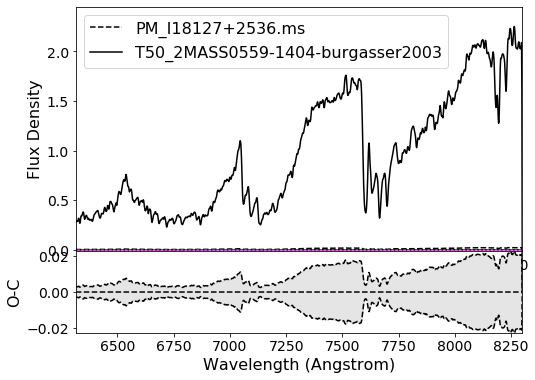

Type: T50, chi2: 13230000.58


<Figure size 432x288 with 0 Axes>

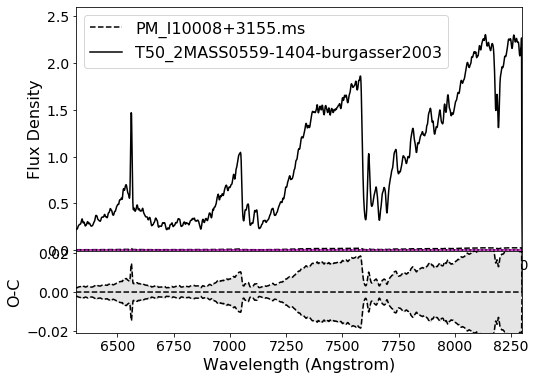

Type: T50, chi2: 13230000.60


<Figure size 432x288 with 0 Axes>

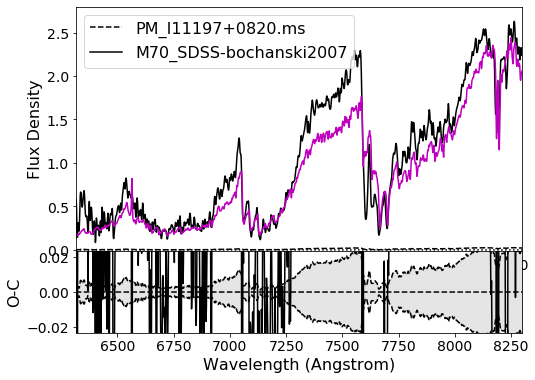

Type: M70, chi2: 1314585.47


<Figure size 432x288 with 0 Axes>

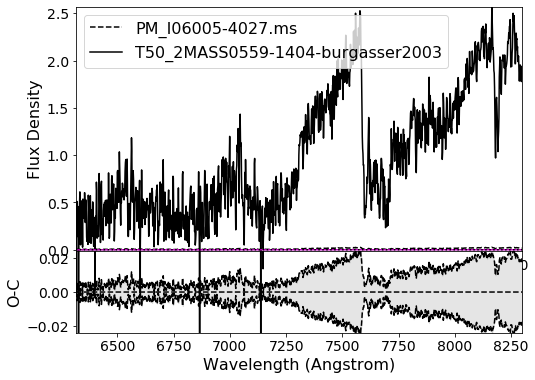

Type: T50, chi2: 13210000.59


<Figure size 432x288 with 0 Axes>

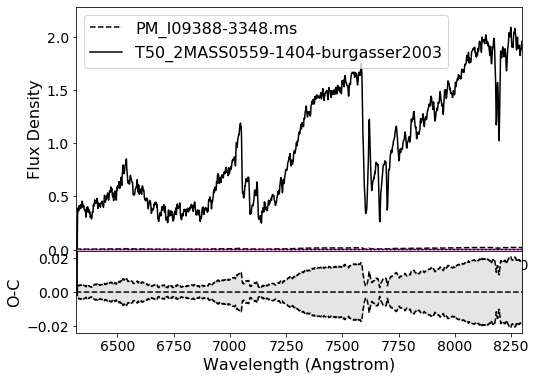

Type: T50, chi2: 13190000.58


<Figure size 432x288 with 0 Axes>

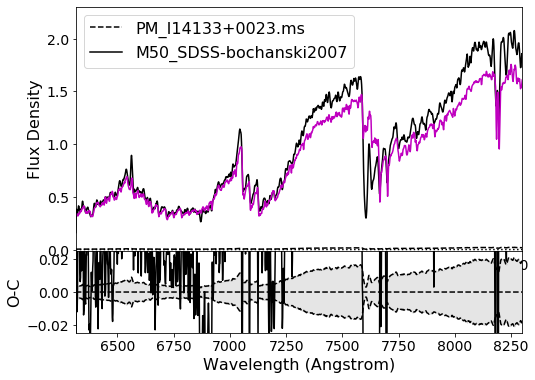

Type: M50, chi2: 699479.75


<Figure size 432x288 with 0 Axes>

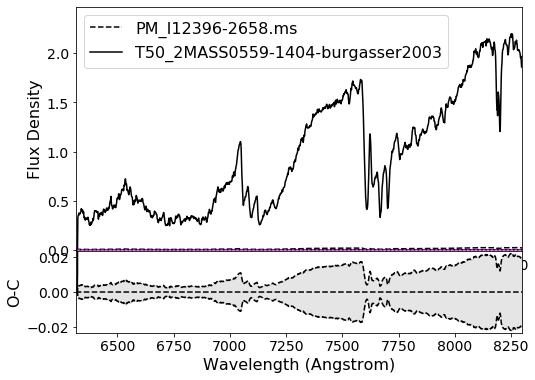

Type: T50, chi2: 13190000.60


<Figure size 432x288 with 0 Axes>

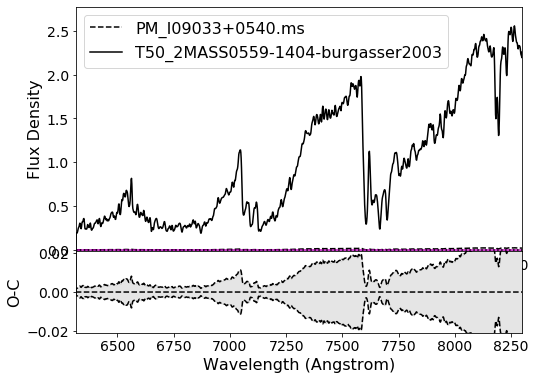

Type: T50, chi2: 13230000.57


<Figure size 432x288 with 0 Axes>

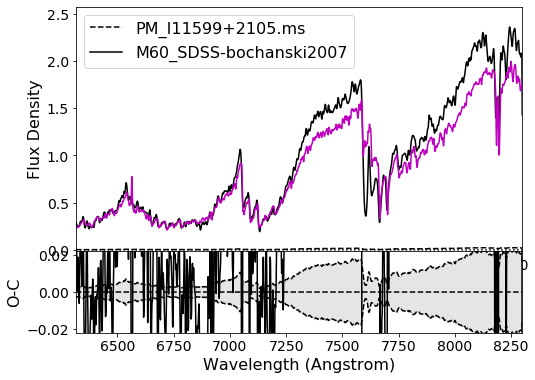

Type: M60, chi2: 606534.87


<Figure size 432x288 with 0 Axes>

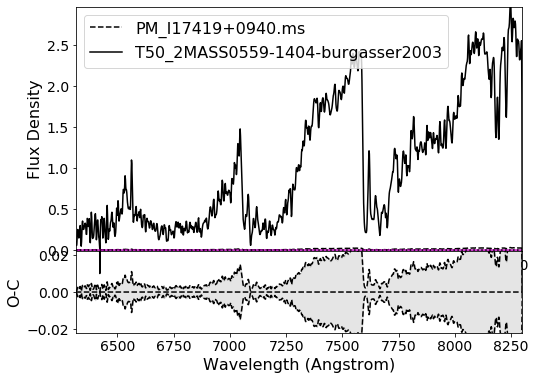

Type: T50, chi2: 13230000.61


<Figure size 432x288 with 0 Axes>

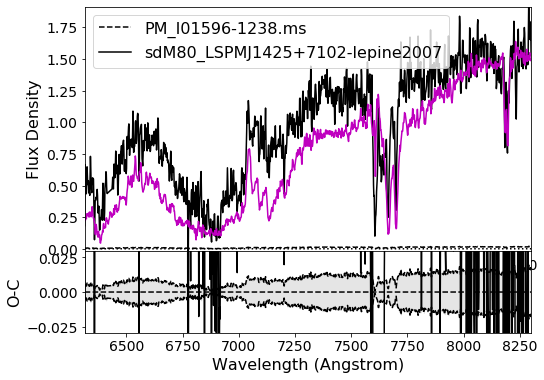

Type: sdM80, chi2: 3596337.28


<Figure size 432x288 with 0 Axes>

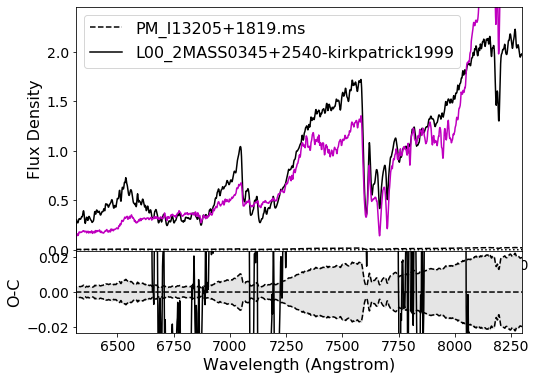

Type: L00, chi2: 1325910.39


<Figure size 432x288 with 0 Axes>

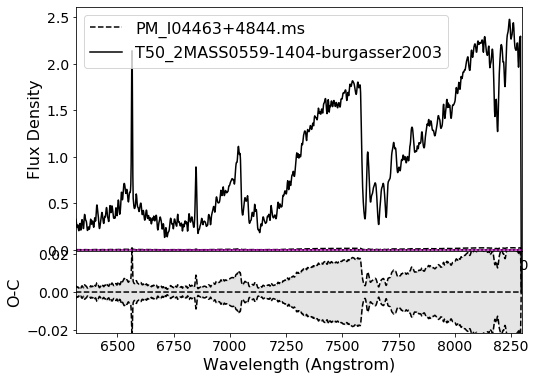

Type: T50, chi2: 13200000.55


<Figure size 432x288 with 0 Axes>

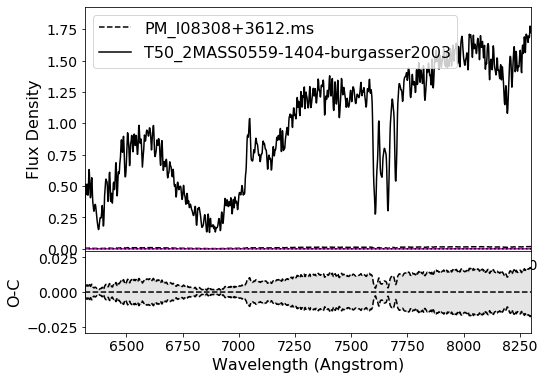

Type: T50, chi2: 13230000.59


<Figure size 432x288 with 0 Axes>

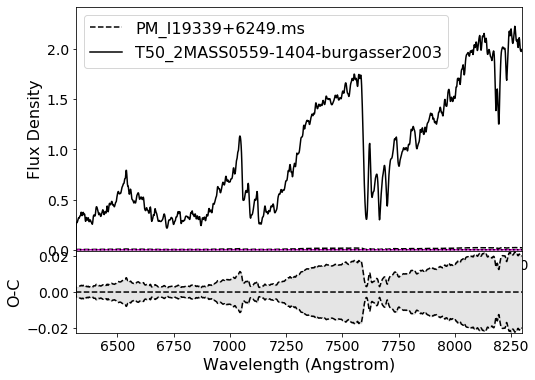

Type: T50, chi2: 13230000.62


<Figure size 432x288 with 0 Axes>

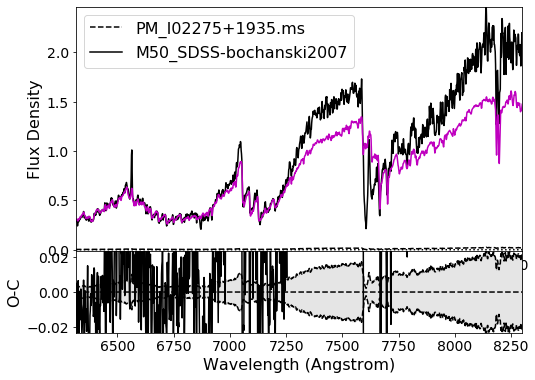

Type: M50, chi2: 1026660.81


<Figure size 432x288 with 0 Axes>

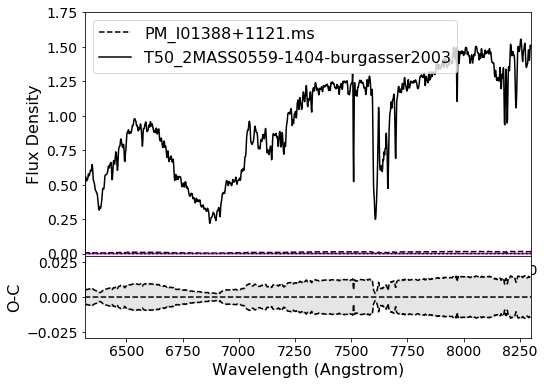

Type: T50, chi2: 13230000.56


<Figure size 432x288 with 0 Axes>

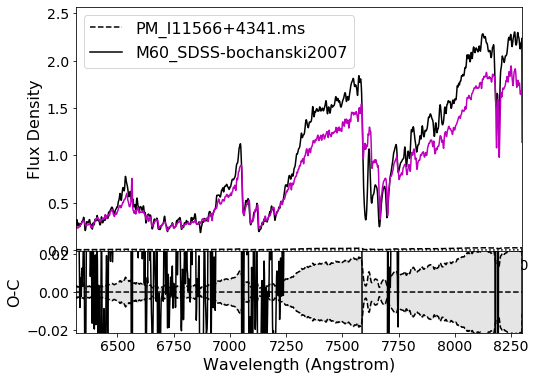

Type: M60, chi2: 836819.72


<Figure size 432x288 with 0 Axes>

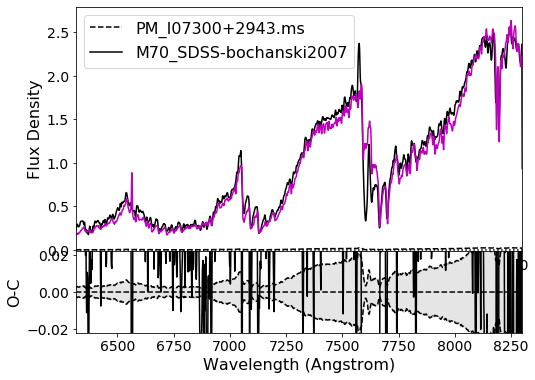

KeyboardInterrupt: 

In [26]:
#subset

#EXTREMELY SLOW, IMPORT FROM FILE
headers = ['NAME', 'CAH2', 'CAH3', 'TIO5', 'SUBTYPE']
name, cah2, cah3, tio5, subtype = compile_spec_info(SPECTRA)
headerlist = list(zip(name, cah2, cah3, tio5, subtype))
df2 = pd.DataFrame(headerlist, columns=headers)
df2


In [80]:
df2

,NAME,CAH2,CAH3,TIO5,SUBTYPE
0,PM_I14564+1755.ms,0.274333,0.572530,0.184215,7.0
1,PM_I00446-7845.ms,0.273980,0.561494,0.182587,7.0
2,PM_I15466-5534.ms,0.386293,0.586638,0.278763,25.0
3,PM_I10314+4855.ms,0.265670,0.477295,0.218296,7.0
4,PM_I04198+4233.ms,0.377262,0.708245,0.351609,25.0
...,...,...,...,...,...
140,PM_I01283+0211.ms,0.239500,0.552919,0.129541,7.0
141,PM_I14378+1043E.ms,0.234869,0.507164,0.182365,25.0
142,PM_I12292+5333.ms,0.260776,0.595590,0.143626,7.0
143,PM_I02193-0258.ms,0.570781,1.149325,0.133594,25.0


In [84]:
kastredux.compareSpectra_simple(sp1, sp2, plot=True)

(282499.0851918532, 0.004223407557561382)

<Figure size 432x288 with 0 Axes>

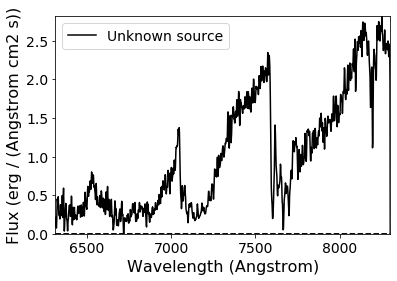

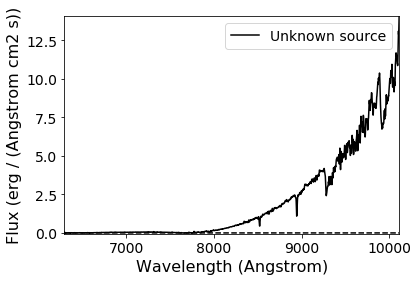

In [83]:
speca = kastredux.readSpectrum('/home/ryan/projects/KASTr_data/PMstars_spectra/PM_I14378+1043E.ms.fits')
standa = kastredux.readSpectrum('/home/ryan/code/kastredux/resources/spectral_standards/T50_2MASS0559-1404-burgasser2003.txt')
speca.plot()
standa.plot()

In [10]:

#it's in a file now thank god
df1 = pd.read_csv('/home/ryan/projects/KASTr_data/PMstars_spectra/PMStars_spt_indices.csv')
df1

,NAME,CAH2,CAH3,TIO5,SUBTYPE,SPT
0,PM_I00012+0659.ms,0.319793,0.588955,0.275065,6.0,M6.0
1,PM_I00013+3416.ms,0.806439,0.908920,0.848083,-3.0,K7.0
2,PM_I00014-1656.ms,0.752572,0.885167,0.809818,-3.0,K7.0
3,PM_I00019-0600.ms,0.632171,0.897984,0.468478,2.0,M2.0
4,PM_I00020+4104.ms,0.781141,0.872333,0.835974,2.0,M2.0
...,...,...,...,...,...,...
4973,PM_I23583+1234W.ms,0.487853,0.663700,0.744542,2.0,M2.0
4974,PM_I23587+4643.ms,0.753529,0.860926,0.800709,-3.0,K7.0
4975,PM_I23590+2051.ms,0.514102,0.756290,0.526514,2.0,M2.0
4976,PM_I23595+4255.ms,0.470633,0.725789,0.467331,6.0,M6.0


In [22]:
df1_sorted = df1.sort_values(by='NAME').reset_index(drop=True)


df1_sorted

,NAME,CAH2,CAH3,TIO5,SUBTYPE,SPT
0,PM_I00012+0659.ms,0.319793,0.588955,0.275065,6.0,M6.0
1,PM_I00013+3416.ms,0.806439,0.908920,0.848083,-3.0,K7.0
2,PM_I00014-1656.ms,0.752572,0.885167,0.809818,-3.0,K7.0
3,PM_I00019-0600.ms,0.632171,0.897984,0.468478,2.0,M2.0
4,PM_I00020+4104.ms,0.781141,0.872333,0.835974,2.0,M2.0
...,...,...,...,...,...,...
4973,PM_I23583+1234W.ms,0.487853,0.663700,0.744542,2.0,M2.0
4974,PM_I23587+4643.ms,0.753529,0.860926,0.800709,-3.0,K7.0
4975,PM_I23590+2051.ms,0.514102,0.756290,0.526514,2.0,M2.0
4976,PM_I23595+4255.ms,0.470633,0.725789,0.467331,6.0,M6.0


In [29]:
df_sorted[ df_sorted['STAR'] == 'PM_I00012+0659.ms']['SPTYPES'][0]

5.5

In [13]:
list(df_sorted)

['STAR',
 'col-M',
 'CAH2',
 'CAH3',
 'TIO5',
 'TIO6',
 'TIO7',
 'VO1',
 'VO2',
 'CLASS',
 'SUBTYPE',
 'ZETA']

In [15]:
delta_type = SPTYPES - df1_sorted['SUBTYPE']
delta_type

0      -0.5
1       0.5
2       3.0
3       0.0
4      -2.0
       ... 
4973    1.5
4974    3.0
4975    0.5
4976   -3.0
4977    1.0
Name: SUBTYPE, Length: 4978, dtype: float64

In [16]:
df_sorted[delta_type < -5]

,STAR,col-M,CAH2,CAH3,TIO5,TIO6,TIO7,VO1,VO2,CLASS,SUBTYPE,ZETA
38,PM_I00153+4344.ms,2.40660,0.39010,0.65598,0.34459,0.61875,0.0,0.94986,0.73606,M,4.5,0.885620
39,PM_I00156+1230.ms,0.90455,0.67470,1.01430,0.98661,2.50460,0.0,2.79230,1.09650,usdK,5.5,0.031722
116,PM_I00341+5625.ms,1.94950,0.40119,0.59290,0.59359,0.86849,0.0,0.96754,0.89139,sdM,5.0,0.528570
133,PM_I00395+6033.ms,1.46130,0.51826,0.76743,0.51997,0.74677,0.0,0.94763,0.95267,sdM,2.5,0.804540
316,PM_I01330+1336.ms,1.75420,0.46176,0.74126,0.42442,0.67990,0.0,0.94445,0.86419,M,3.5,0.890310
...,...,...,...,...,...,...,...,...,...,...,...,...
4600,PM_I22056+6421.ms,1.46500,0.54872,0.78969,0.59359,0.80461,0.0,0.94804,0.93125,sdM,2.0,0.718160
4608,PM_I22070+4015.ms,1.99660,0.43950,0.71181,0.44860,0.71274,0.0,0.92858,0.80650,sdM,3.5,0.813400
4632,PM_I22142+0245.ms,2.22460,0.36303,0.67125,0.36011,0.56309,0.0,0.94012,0.79417,M,4.5,0.856910
4729,PM_I22432+4113.ms,2.96460,0.28545,0.65806,0.25650,0.40184,0.0,0.79265,0.64608,M,5.5,0.935070


In [17]:
df1_sorted[delta_type < -5]

,NAME,CAH2,CAH3,TIO5,SUBTYPE,SPT
38,PM_I00153+4344.ms,0.399149,0.651199,0.346097,10.0,L0.0
39,PM_I00156+1230.ms,0.695232,1.043969,0.982596,2.0,M2.0
116,PM_I00341+5625.ms,0.410586,0.580963,0.594461,13.0,L3.0
133,PM_I00395+6033.ms,0.534171,0.775217,0.520620,13.0,L3.0
316,PM_I01330+1336.ms,0.474542,0.745918,0.424934,16.0,L6.0
...,...,...,...,...,...,...
4600,PM_I22056+6421.ms,0.566138,0.799829,0.594156,12.0,L2.0
4608,PM_I22070+4015.ms,0.451023,0.713085,0.449070,13.0,L3.0
4632,PM_I22142+0245.ms,0.370764,0.668383,0.360747,10.0,L0.0
4729,PM_I22432+4113.ms,0.289749,0.655385,0.256969,11.0,L1.0


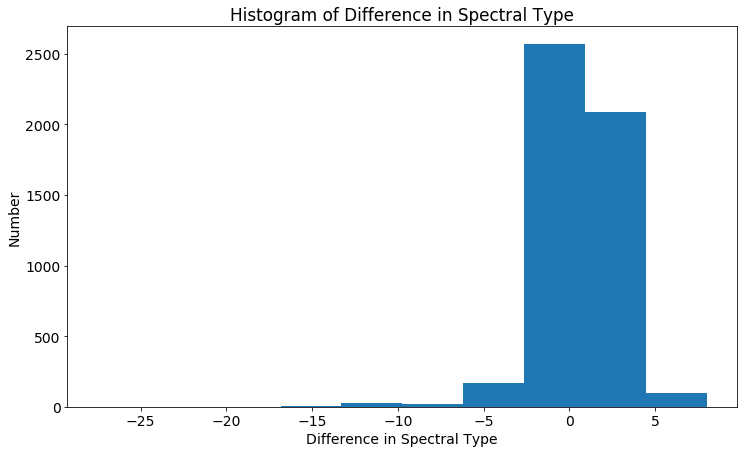

In [18]:
plt.figure(figsize=[12,7])
plt.hist(delta_type)
plt.xlabel('Difference in Spectral Type')
plt.ylabel('Number')
plt.title('Histogram of Difference in Spectral Type')
#plt.savefig('TypeHist.png')
plt.show()

In [19]:
delta_cah2 = df_sorted['CAH2'] - df1_sorted['CAH2']

delta_cah2

0      -0.005083
1      -0.029639
2      -0.026922
3      -0.020951
4      -0.028611
          ...   
4973   -0.014503
4974   -0.027069
4975   -0.014862
4976   -0.012443
4977   -0.022790
Name: CAH2, Length: 4978, dtype: float64

In [20]:
delta_cah3 = df_sorted['CAH3'] - df1_sorted['CAH3']

delta_cah3

0       0.010965
1      -0.021240
2      -0.018837
3      -0.020194
4      -0.017823
          ...   
4973    0.002110
4974   -0.016496
4975   -0.005830
4976   -0.002439
4977   -0.015435
Name: CAH3, Length: 4978, dtype: float64

In [21]:
delta_tio5 = df_sorted['TIO5'] - df1_sorted['TIO5']

delta_tio5

0      -0.000545
1      -0.000583
2      -0.000558
3      -0.000958
4      -0.000824
          ...   
4973   -0.001812
4974   -0.000789
4975   -0.000584
4976   -0.000241
4977   -0.000646
Name: TIO5, Length: 4978, dtype: float64

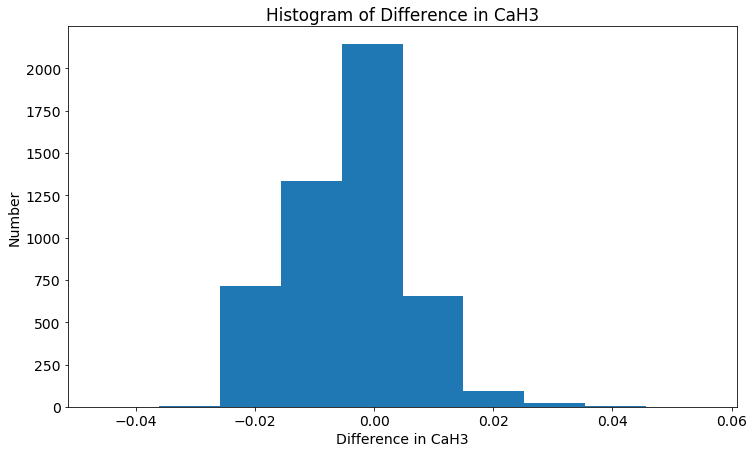

In [22]:
plt.figure(figsize=[12,7])
plt.hist(delta_cah3)
plt.xlabel('Difference in CaH3')
plt.ylabel('Number')
plt.title('Histogram of Difference in CaH3')
#plt.savefig('CaH3Hist.png')
plt.show()

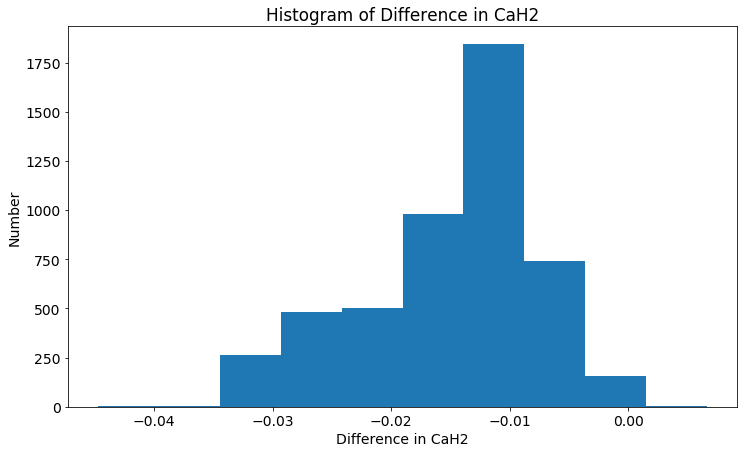

In [23]:
plt.figure(figsize=[12,7])
plt.hist(delta_cah2)
plt.xlabel('Difference in CaH2')
plt.ylabel('Number')
plt.title('Histogram of Difference in CaH2')
#plt.savefig('CaH2Hist.png')
plt.show()

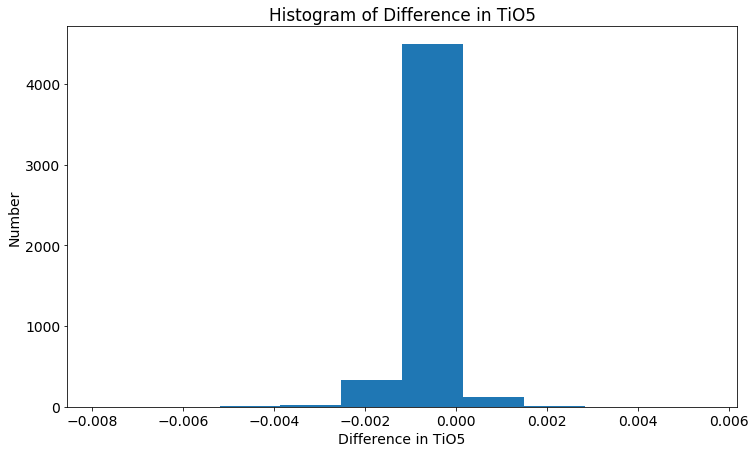

In [24]:
plt.figure(figsize=[12,7])
plt.hist(delta_tio5)
plt.xlabel('Difference in TiO5')
plt.ylabel('Number')
plt.title('Histogram of Difference in TiO5')
#plt.savefig('TiO5Hist.png')
plt.show()

In [61]:
(df_sorted[ df_sorted['STAR'] == 'PM_I22482+2723.ms']['SPTYPES'] > 6).all(axis=None)

False

In [150]:
typeToNum('M6') - 10

6.0

In [22]:
SPECTRA[0]

KAST red spectrum of LSR2248+2722-N

In [71]:
kastredux.compareSpectra(sp1, sp2, plot=True)

2.837980038180255e-14


(126.11618552927665, 0.006366803875783394)

In [66]:
classify_by_standard(SPECTRA[0], ref='lepine', plot=True)

('sdM30',
 'sdM30_LSPMJ1144+1351-lepine2007',
 6080937460.1785965,
 1.4876840097502484)

<Figure size 432x288 with 0 Axes>

In [9]:
spec_info = []

for spec in SPECTRA:
    spec_info.append(compile_spec_info(spec))

Accepted Spt: sdM10	 Chi2:0.0
Accepted Spt: sdM10	 Chi2:0.0
Accepted Spt: sdM10	 Chi2:0.0
Accepted Spt: sdM10	 Chi2:0.0
Accepted Spt: sdM10	 Chi2:0.0
Accepted Spt: sdM10	 Chi2:0.0
Accepted Spt: sdM10	 Chi2:0.0
Accepted Spt: sdM10	 Chi2:0.0


KeyboardInterrupt: 

In [18]:
spec_info

[{'spec': KAST red spectrum of J0225+6229,
  'indices': {'CaH3': (0.59567056503709, 0.011939826176839323),
   'CaH2': (0.3045070468580348, 0.008071087224705412),
   'TiO5': (0.20472921136538927, 0.010758642315739652)},
  'spt': 17.0},
 {'spec': KAST red spectrum of J1300+3038,
  'indices': {'CaH3': (0.49310542271890234, 0.00668764014691949),
   'CaH2': (0.24249614419098933, 0.004207713953792618),
   'TiO5': (0.1840205481074907, 0.005788472927246111)},
  'spt': 16.0},
 {'spec': KAST red spectrum of J0813-1522,
  'indices': {'CaH3': (0.7403887637360066, 0.0029374625092787707),
   'CaH2': (0.46679168810813293, 0.001915591982163578),
   'TiO5': (0.4887031397245506, 0.002459357713728492)},
  'spt': 15.0},
 {'spec': KAST red spectrum of J1102-1624,
  'indices': {'CaH3': (0.6796257030300994, 0.003159619005523585),
   'CaH2': (0.358022080244404, 0.0019279218490731304),
   'TiO5': (0.3201275049624369, 0.0023931470187429915)},
  'spt': 16.0},
 {'spec': KAST red spectrum of LM* J1054+1214,
  'ind

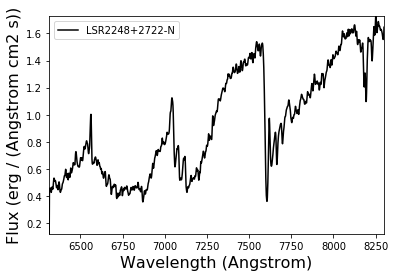

In [17]:
SPECTRA[0].plot()

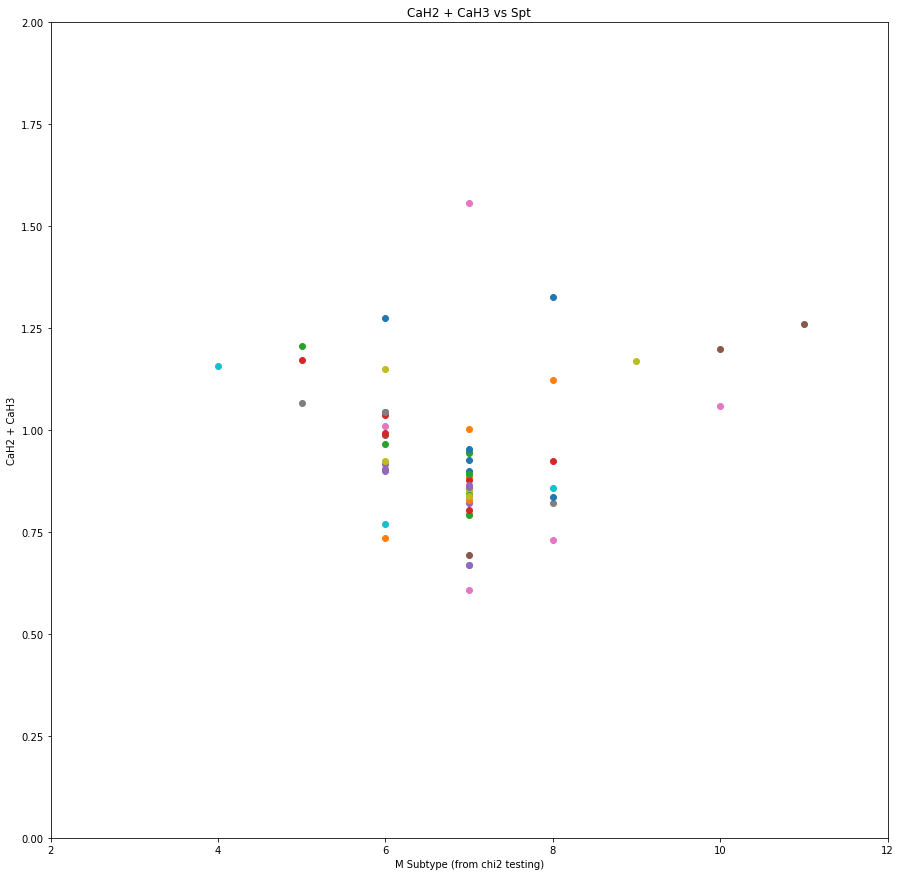

In [34]:
fig, axs = plt.subplots(1, 1, figsize=[15,15])

for info in spec_info:
    
    axs.scatter(info['spt'] - 10, info['indices']['CaH3'][0] + info['indices']['CaH2'][0])
    

    
axs.set_xlim(2, 12)
axs.set_ylim(0, 2)
axs.set_xlabel('M Subtype (from chi2 testing)')
axs.set_ylabel('CaH2 + CaH3')

axs.set_title('CaH2 + CaH3 vs Spt')

fig.savefig('CaH2+CaH3vsSpt.png')
fig.show()

In [23]:
typeToNum('M00')

10.0

<Figure size 432x288 with 0 Axes>

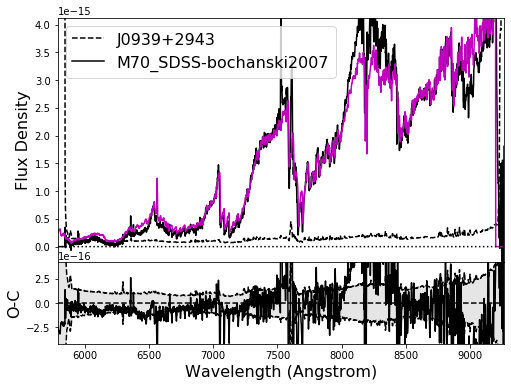

<Figure size 432x288 with 0 Axes>

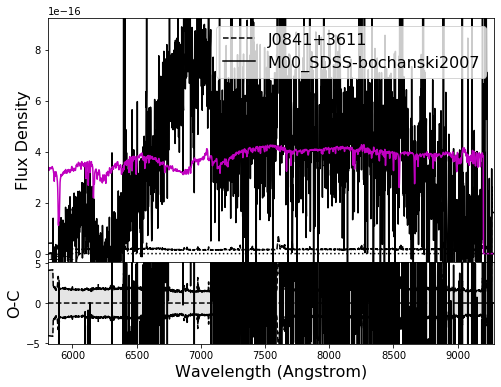

<Figure size 432x288 with 0 Axes>

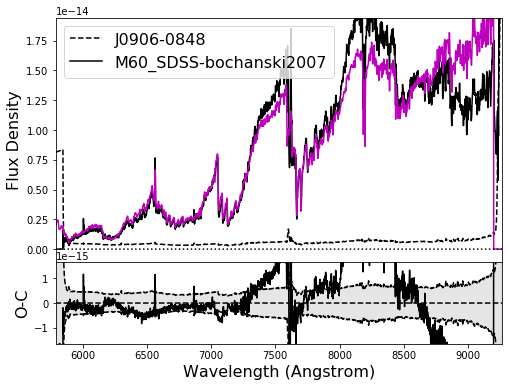

<Figure size 432x288 with 0 Axes>

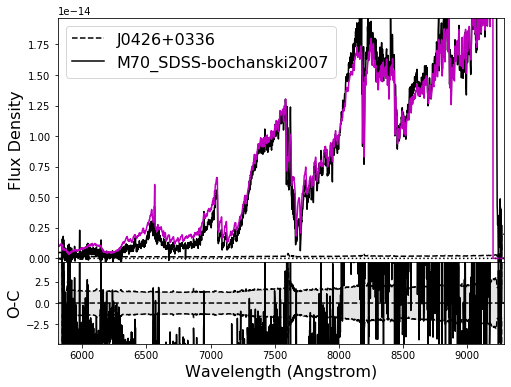

<Figure size 432x288 with 0 Axes>

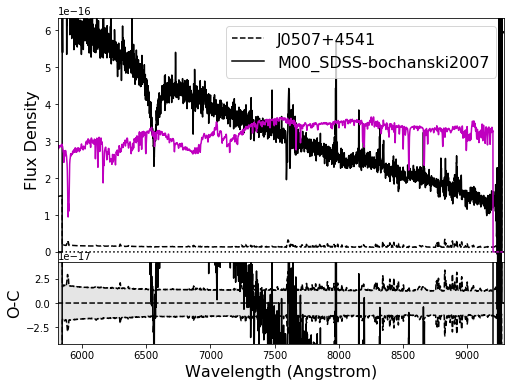

<Figure size 432x288 with 0 Axes>

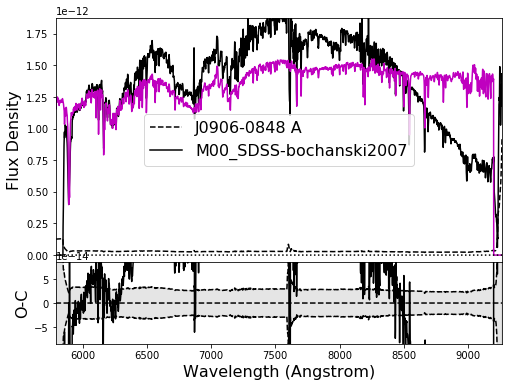

<Figure size 432x288 with 0 Axes>

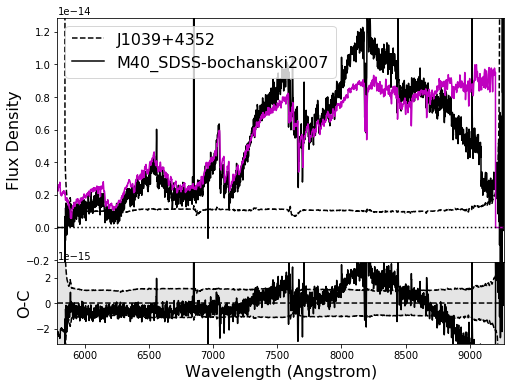

<Figure size 432x288 with 0 Axes>

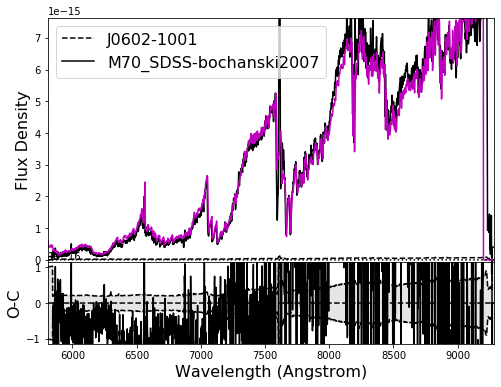

In [21]:
for spec in SPECTRA:
    info_tuple = classify_by_template(spec, plot=True)
    plt.show()

In [10]:
classify_by_template(sp1)

('M60', 'M60_SDSS-bochanski2007', 17841.467052288048, 1.7404180373645285e-14)

In [11]:
measure_index_set(sp1, ref='kirkpatrick')

/home/ryan/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:20: DeprecationWarning: object of type <class 'float'> cannot be safely interpreted as an integer.
/home/ryan/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:41: DeprecationWarning: object of type <class 'float'> cannot be safely interpreted as an integer.
/home/ryan/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:116: RuntimeWarning: invalid value encountered in double_scalars


{'Rb-a': (1.093481368463627, 0.027493892098396953),
 'Rb-b': (1.0796073465813874, 0.023566296498360645),
 'Na-a': (1.337727723680996, 0.026788897881865715),
 'Na-b': (4.152118897392347, 0.0734213279839894),
 'Cs-a': (1.0922952188075317, 0.021545164750578893),
 'Cs-b': (1.02660903951163, 0.02751122807465887),
 'TiO-a': (0.5894915597076726, 0.013379106632732386),
 'TiO-b': (0.6024341942597687, 0.00824576070042344),
 'VO-a': (1.0286530462209693, 0.012065758623568446),
 'VO-b': (1.158692357539012, 0.014047767476923191),
 'CrH-a': (1.0211300810280917, 0.016387010891543364),
 'CrH-b': (nan, nan),
 'FeH-a': (1.0897050643742894, 0.018817437526203035),
 'FeH-b': (nan, nan),
 'Color-a': (0.0, 0.0),
 'Color-b': (0.0, 0.0),
 'Color-c': (0.0, 0.0),
 'Color-d': (0.0, 0.0)}

In [5]:
STAND_PATHS = glob.glob('/home/ryan/code/kastredux/resources/spectral_standards/' + '*.txt')

STANDARDS = []

for path in STAND_PATHS:
    name = os.path.basename(os.path.splitext(path)[0])
    stand_spec = kastredux.readSpectrum(path)
    stand_spec.name = name
    
    STANDARDS.append(stand_spec)
    

In [22]:
indices = measure_index_set(sp1, ref='gizis')

In [23]:
print(indices['CaH1'][0])
print(indices['CaH2'][0])
print(indices['CaH3'][0])
print(indices['TiO5'][0])

0.7941940672439514
0.33169326337558375
0.6481986008837284
0.2915542759909266


In [20]:
measure_spt(sp1, ref='gizis')

((4.949416779447468, 0.16893240078442365),
 (4.737429506424476, 0.22303055224126914),
 (4.13242518409289, 0.4550503829132531))

In [32]:
indices['Cs-a'][0] / indices['VO-b'][0]


0.9426964903155971

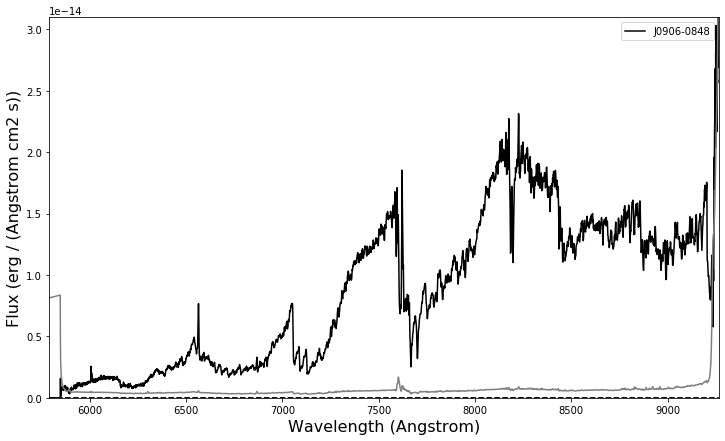

In [37]:
sp1.plot(figsize=[12,7])

0.5286207622048114

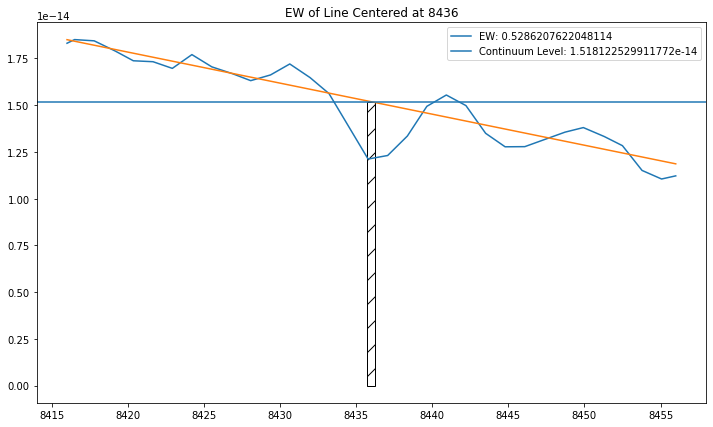

In [24]:
measure_EW_simple(sp1, 8436, 10, 20, plot=True, to_file=True)

In [ ]:
for stand in LEPINE_STANDARDS:
    
    indices = measure_index_set(stand, ref='lepine2007')
    
    print(indices)

In [62]:
#OLD
'''
measure_index_set(sp1, ref='lepine')
'''

{'CaH3': (0.6490527999040103, 0.025104920880684643),
 'CaH2': (0.3319778694090283, 0.01474269079440337),
 'TiO5': (0.2918329892314886, 0.018152477825190402)}

In [19]:
measure_solar_TiO5(sp1)

(0.3233943663135689, 0.021499820617438443)

In [63]:
#OLD
'''
measure_solar_TiO5(sp1)
'''

(0.3247650062922306, 0.02110637733620173)

In [20]:
measure_lepine_spt(sp1)

(3.9453446493051096, 0.2164505981498731)

In [68]:
#OLD
'''measure_lepine_spt(sp1)'''

(3.9329689140666795, 0.21271224357268168)

In [21]:
measure_lepine_zeta(sp1)

(1.047058565192792, 0.04210051889235641)

In [66]:
#OLD
'''measure_lepine_zeta(sp1)'''

(1.0481946923240055, 0.04290994735291789)

In [22]:
zeta = measure_lepine_zeta(sp1)[0]
determine_metallicity_class(zeta)

'Dwarf'

In [25]:
print(measure_lepine_indices(sp1))
print(measure_lepine_zeta(sp1))
print(measure_lepine_spt(sp1))

[0.6481988396642226, 0.33169267445447903, 0.29154963469410416]
1.0470650333057023
3.945347190031562


In [7]:
STAND_PATHS = glob.glob('/home/ryan/code/kastredux/resources/spectral_standards/' + '*.txt')

LEPINE_STANDARDS = []

lepine_str = 'lepine'

for path in STAND_PATHS:
    
    if lepine_str in path:
        name = os.path.basename(os.path.splitext(path)[0])
        stand_spec = kastredux.readSpectrum(path)
        stand_spec.name = name
    
        LEPINE_STANDARDS.append(stand_spec)

In [7]:
print(measure_lepine_indices(sp2))
print(measure_lepine_zeta(sp2))
print(measure_lepine_spt(sp2))

[0.8954600852555947, 0.7489002050531942, 0.7989483844199139]
1.2442262094235188
-0.2581138330057229


In [8]:
STATS = []
NAMES = []

for spec in STANDARDS:
    stat, scalefactor = kastredux.compareSpectra_simple(sp1, spec, novar2=False)
    
    #print('chi2: {}; name: {}'.format(stat, spec.name))
    
    STATS.append(stat)
    NAMES.append(spec.name)
    
print(np.amin(STATS))
print(NAMES[np.argmin(STATS)])

17841.46705228801
M60_SDSS-bochanski2007


In [9]:
STATS = []
NAMES = []

for spec in STANDARDS:
    stat, scalefactor = kastredux.compareSpectra_simple(sp2, spec, novar2=False)
    
    #print('chi2: {}; name: {}'.format(stat, spec.name))
    
    STATS.append(stat)
    NAMES.append(spec.name)
    
print(np.amin(STATS))
print(NAMES[np.argmin(STATS)])

301413.4185738305
M00_SDSS-bochanski2007


(301413.4185738305, 1.5536169095642894e-12)

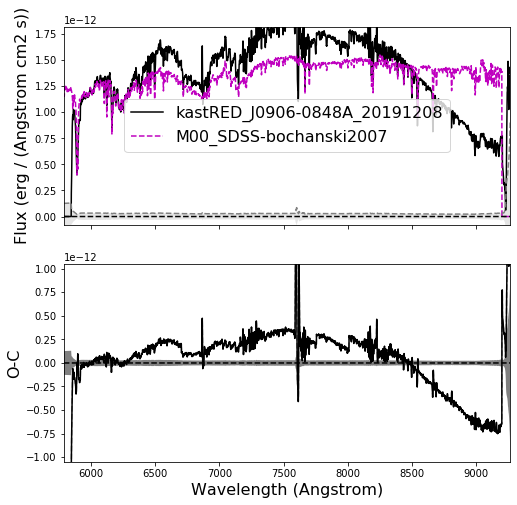

In [10]:
kastredux.compareSpectra_simple(sp2, stand3, plot=True)

In [23]:
for stand in LEPINE_STANDARDS:
    spt = measure_lepine_spt(stand)
    zeta = measure_lepine_zeta(stand)
    
    print('{}: \tspt: {}\tz: {}'.format(stand.name, spt, zeta))

sdM10_LSPMJ0938+2200-lepine2007: 	spt: 0.8900538738075046	z: 0.8135455813908783
usdM55_LSPMJ1202+1645-lepine2007: 	spt: 5.3345922413390685	z: 0.01828682660744999
sdM50_LSPMJ1448+6148-lepine2007: 	spt: 5.117203378093254	z: 0.6924521664562503
sdM20_LSPMJ1014+4354-lepine2007: 	spt: 1.8647819830774601	z: 0.6892053438412453
usdM20_LSPMJ0440+1538-lepine2007: 	spt: 1.8037094216942666	z: -0.04254823585449559
esdK70_LSPMJ0448+2206-lepine2007: 	spt: -0.9129413841861282	z: 0.6562963098591946
usdM75_LSPMJ0822+1700-lepine2007: 	spt: 7.6640156767016725	z: 0.11880308343058481
usdM00_LSPMJ0621+6558-lepine2007: 	spt: 0.10444394947498026	z: 0.10264688574863531
esdM30_LSPMJ1337+3501-lepine2007: 	spt: 2.771671654625786	z: 0.38812802173130234
esdM40_LSPMJ1340+1902-lepine2007: 	spt: 4.211210399708962	z: 0.2817846715013545
esdM50_LSPMJ0843+0600-lepine2007: 	spt: 5.01233613874156	z: 0.3120433294209408
usdK70_LSPMJ1815+2029-lepine2007: 	spt: -0.9506986025186723	z: 0.2530888026398841
sdM00_LSPMJ0202+0542-lepine

In [17]:
for stand in LEPINE_STANDARDS:
    indices = measure_lepine_indices(stand)
    
    print(stand.name, end=':\n')
    print('CaH3: {}\tCaH2: {}\tTiO5: {}'.format( indices[0], indices[1], indices[2]))

sdM10_LSPMJ0938+2200-lepine2007:
CaH3: 0.8110226255287503	CaH2: 0.63115444579965	TiO5: 0.740815238433589
usdM55_LSPMJ1202+1645-lepine2007:
CaH3: 0.47228090251473887	CaH2: 0.3227503246561026	TiO5: 0.9853204913632866
sdM50_LSPMJ1448+6148-lepine2007:
CaH3: 0.5068172303662366	CaH2: 0.31632015311661793	TiO5: 0.45667814111000443
sdM20_LSPMJ1014+4354-lepine2007:
CaH3: 0.7466039782080669	CaH2: 0.5379170055722666	TiO5: 0.6942219620196346
usdM20_LSPMJ0440+1538-lepine2007:
CaH3: 0.7196395777599247	CaH2: 0.5744389862450553	TiO5: 1.0185552752946574
esdK70_LSPMJ0448+2206-lepine2007:
CaH3: 0.917106631123188	CaH2: 0.8526953988242997	TiO5: 0.9544686189665083
usdM75_LSPMJ0822+1700-lepine2007:
CaH3: 0.30855736299680053	CaH2: 0.20145714045546473	TiO5: 0.8862268704624605
usdM00_LSPMJ0621+6558-lepine2007:
CaH3: 0.835969211552484	CaH2: 0.7423306623939034	TiO5: 0.9782357576438034
esdM30_LSPMJ1337+3501-lepine2007:
CaH3: 0.6572553423135574	CaH2: 0.48977131291726517	TiO5: 0.7860079525854062
esdM40_LSPMJ1340+1902

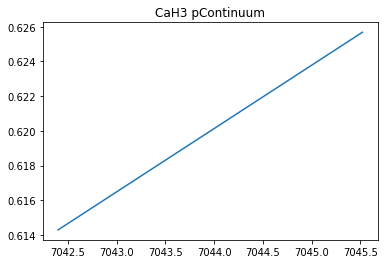

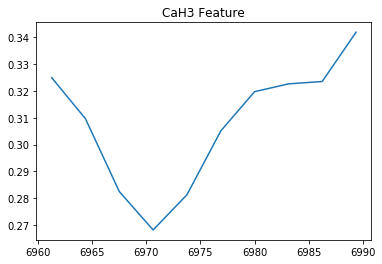

0.49669569577075895

In [16]:
waves = stand1.wave.value
fluxes = stand1.flux.value

CaH3_wave_cont = waves[ (waves > 7042) & (waves < 7046)]
CaH3_flux_cont = fluxes[ (waves > 7042) & (waves < 7046)]

CaH3_wave_feat = waves[ (waves > 6960) & (waves < 6990)]
CaH3_flux_feat = fluxes[ (waves > 6960) & (waves < 6990)]

plt.plot(CaH3_wave_cont, CaH3_flux_cont)
plt.title('CaH3 pContinuum')
plt.show()

plt.plot(CaH3_wave_feat, CaH3_flux_feat)
plt.title('CaH3 Feature')
plt.show()

pcontflux = np.mean(CaH3_flux_cont)
featflux = np.mean(CaH3_flux_feat)

CaH3_index = featflux / pcontflux

CaH3_index

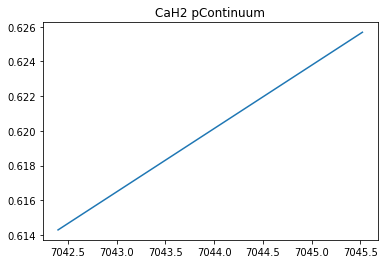

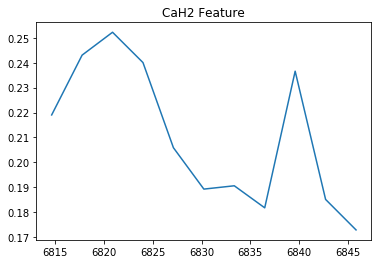

0.33968027563512115

In [17]:
waves = stand1.wave.value
fluxes = stand1.flux.value

CaH2_wave_cont = waves[ (waves > 7042) & (waves < 7046)]
CaH2_flux_cont = fluxes[ (waves > 7042) & (waves < 7046)]

CaH2_wave_feat = waves[ (waves > 6814) & (waves < 6846)]
CaH2_flux_feat = fluxes[ (waves > 6814) & (waves < 6846)]

plt.plot(CaH2_wave_cont, CaH2_flux_cont)
plt.title('CaH2 pContinuum')
plt.show()

plt.plot(CaH2_wave_feat, CaH2_flux_feat)
plt.title('CaH2 Feature')
plt.show()

pcontflux = np.mean(CaH2_flux_cont)
featflux = np.mean(CaH2_flux_feat)

CaH2_index = featflux / pcontflux

CaH2_index

In [18]:
CaH3 = CaH2_index + CaH3_index

spt = 1.4 * ( CaH3 )**2 - 10 * CaH3 + 12.4

solarTiO5 = -0.164 * CaH3 ** 3 + 0.670 * CaH3 ** 2 - 0.118 * CaH3 - 0.05
spt

5.01557495770438

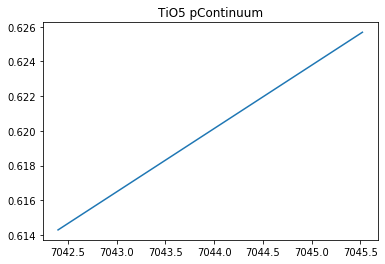

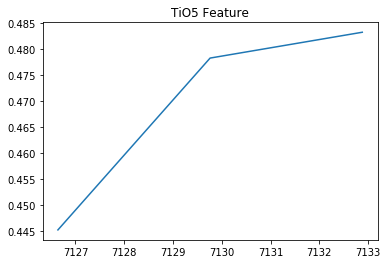

0.7564184812059905

In [19]:
waves = stand1.wave.value
fluxes = stand1.flux.value

TiO5_wave_cont = waves[ (waves > 7042) & (waves < 7046)]
TiO5_flux_cont = fluxes[ (waves > 7042) & (waves < 7046)]

TiO5_wave_feat = waves[ (waves > 7126) & (waves < 7135)]
TiO5_flux_feat = fluxes[ (waves > 7126) & (waves < 7135)]

plt.plot(TiO5_wave_cont, TiO5_flux_cont)
plt.title('TiO5 pContinuum')
plt.show()

plt.plot(TiO5_wave_feat, TiO5_flux_feat)
plt.title('TiO5 Feature')
plt.show()

pcontflux = np.mean(TiO5_flux_cont)
featflux = np.mean(TiO5_flux_feat)

TiO5_index = featflux / pcontflux

TiO5_index

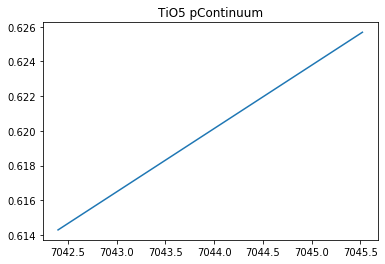

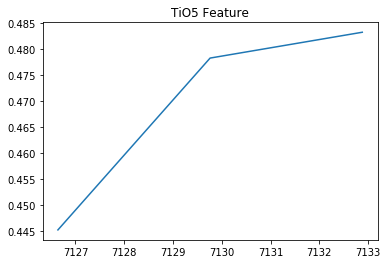

0.7564184812059905

In [20]:
waves = stand1.wave.value
fluxes = stand1.flux.value

TiO5_wave_cont = waves[ (waves >= 7042) & (waves <= 7046)]
TiO5_flux_cont = fluxes[ (waves >= 7042) & (waves <= 7046)]

TiO5_wave_feat = waves[ (waves >= 7126) & (waves <= 7135)]
TiO5_flux_feat = fluxes[ (waves >= 7126) & (waves <= 7135)]

plt.plot(TiO5_wave_cont, TiO5_flux_cont)
plt.title('TiO5 pContinuum')
plt.show()

plt.plot(TiO5_wave_feat, TiO5_flux_feat)
plt.title('TiO5 Feature')
plt.show()

pcontflux = np.mean(TiO5_flux_cont)
featflux = np.mean(TiO5_flux_feat)

TiO5_index = featflux / pcontflux

TiO5_index

In [21]:
zeta = (1 - TiO5_index)/(1 - solarTiO5)
zeta

0.31390926472610003

In [3]:
print(kastredux.compareSpectra_simple(sp1, stand1))
print(kastredux.compareSpectra_simple(sp1, stand2))


(139203.4858655595, 1.0811182242974623e-14)
(30574.64188978693, 1.88373850560153e-14)


In [3]:
def get_chi2(spec1, spec2):
    sp1 = copy.deepcopy(spec1)
    
    sp2 = copy.deepcopy(spec2)

    waves = sp1.wave.value
    f1 = sp1.flux.value
    u1 = sp1.unc.value
    #v1 = sp1.variance.value

    f2interp = kastredux.interp1d(sp2.wave.value, sp2.flux.value, bounds_error=False, fill_value=0.)
    u2interp = kastredux.interp1d(sp2.wave.value, sp2.unc.value, bounds_error=False, fill_value=0.)
    #v2interp = kastredux.interp1d(stand2.wave.value, stand2.variance.value, bounds_error=False, fill_value=0.)

    f2 = f2interp(waves)
    u2 = u2interp(waves)
    #v2 = v2interp(waves)

    #vartot = v1 + v2

    vartot = u1**2 #+ u2**2

    scalefactor = np.nansum( (f1 * f2)/ vartot )/np.nansum( f2**2 / vartot )

    chi2 = np.nansum( (f1 - scalefactor*f2)**2 /vartot )

    return chi2

In [24]:
CHI2 = []

for spec in STANDARDS:
    chi2 = get_chi2(sp1, spec)
    
    CHI2.append(chi2)
    
stdarr = np.array(STANDARDS)

print(np.amin(CHI2))
print(stdarr[ CHI2 == np.amin(CHI2) ][0].name)

17841.46705228801
M60_SDSS-bochanski2007


In [6]:
for spec in STANDARDS:
    chi2 = get_chi2(sp1, spec)
    
    print('chi2: {}; name: {}'.format(chi2, spec.name))

chi2: 419278.8513129336; name: T50_2MASS0559-1404-burgasser2003
chi2: 139203.4858655595; name: M20_SDSS-bochanski2007
chi2: 144968.92693349224; name: sdM10_LSPMJ0938+2200-lepine2007
chi2: 166975.0182826653; name: usdM55_LSPMJ1202+1645-lepine2007
chi2: 374093.9252107437; name: T00_SDSS0837-0000-burgasser2003
chi2: 218008.7967401127; name: L50_SDSS-schmidt2017
chi2: 107792.12152231444; name: L30_2MASS1146+2230-kirkpatrick1999
chi2: 58751.17393782745; name: sdM50_LSPMJ1448+6148-lepine2007
chi2: 118715.08125289954; name: sdM20_LSPMJ1014+4354-lepine2007
chi2: 183391.07166633318; name: L50_2MASS1228-1547-kirkpatrick1999
chi2: 47719.95946108667; name: M40_SDSS-bochanski2007
chi2: 185338.34779091267; name: usdM20_LSPMJ0440+1538-lepine2007
chi2: 30574.64188978693; name: M70_SDSS-bochanski2007
chi2: 17841.46705228801; name: M60_SDSS-bochanski2007
chi2: 25441.217024842976; name: M50_SDSS-bochanski2007
chi2: 238551.08447864756; name: esdK70_LSPMJ0448+2206-lepine2007
chi2: 254442.85622780537; name:

In [8]:
for spec in STANDARDS:
    
    chi2 = mod_get_chi2(sp1, spec)
    
    print('chi2: {}; name: {}'.format(chi2, spec.name))

/home/ryan/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:51: RuntimeWarning: invalid value encountered in double_scalars


chi2: 0.0; name: T50_2MASS0559-1404-burgasser2003
chi2: 1224.8452906758748; name: M20_SDSS-bochanski2007
chi2: 0.0; name: sdM10_LSPMJ0938+2200-lepine2007
chi2: 0.0; name: usdM55_LSPMJ1202+1645-lepine2007
chi2: 0.0; name: T00_SDSS0837-0000-burgasser2003
chi2: 54848.26396909516; name: L50_SDSS-schmidt2017
chi2: 0.0; name: L30_2MASS1146+2230-kirkpatrick1999
chi2: 0.0; name: sdM50_LSPMJ1448+6148-lepine2007
chi2: 0.0; name: sdM20_LSPMJ1014+4354-lepine2007
chi2: 0.0; name: L50_2MASS1228-1547-kirkpatrick1999
chi2: 1224.8452906758748; name: M40_SDSS-bochanski2007
chi2: 0.0; name: usdM20_LSPMJ0440+1538-lepine2007
chi2: 1224.8452906758748; name: M70_SDSS-bochanski2007
chi2: 1224.8452906758748; name: M60_SDSS-bochanski2007
chi2: 1224.8452906758748; name: M50_SDSS-bochanski2007
chi2: 0.0; name: esdK70_LSPMJ0448+2206-lepine2007
chi2: 1224.8452906758748; name: M00_SDSS-bochanski2007
chi2: 0.0; name: usdM75_LSPMJ0822+1700-lepine2007
chi2: 0.0; name: T80_2MASS0415-0935-burgasser2003
chi2: 0.0; name: T

In [9]:
for spec in STANDARDS:
    stat, scalefactor = kastredux.compareSpectra(sp1, spec, novar2=False)
    
    print('chi2: {}; name: {}'.format(stat, spec.name))
    

/home/ryan/anaconda3/lib/python3.7/site-packages/numpy/lib/function_base.py:3405: RuntimeWarning: Invalid value encountered in median
  r = func(a, **kwargs)


chi2: 419278.8513129336; name: T50_2MASS0559-1404-burgasser2003
chi2: 1224.8452906758748; name: M20_SDSS-bochanski2007
chi2: 144968.92693349224; name: sdM10_LSPMJ0938+2200-lepine2007
chi2: 166975.0182826653; name: usdM55_LSPMJ1202+1645-lepine2007
chi2: 374093.9252107437; name: T00_SDSS0837-0000-burgasser2003
chi2: 54848.26396909516; name: L50_SDSS-schmidt2017
chi2: 107792.12152231444; name: L30_2MASS1146+2230-kirkpatrick1999
chi2: 58751.17393782745; name: sdM50_LSPMJ1448+6148-lepine2007
chi2: 118715.08125289954; name: sdM20_LSPMJ1014+4354-lepine2007
chi2: 183391.07166633318; name: L50_2MASS1228-1547-kirkpatrick1999
chi2: 1224.8452906758748; name: M40_SDSS-bochanski2007
chi2: 185338.34779091267; name: usdM20_LSPMJ0440+1538-lepine2007
chi2: 1224.8452906758748; name: M70_SDSS-bochanski2007
chi2: 1224.8452906758748; name: M60_SDSS-bochanski2007
chi2: 1224.8452906758748; name: M50_SDSS-bochanski2007
chi2: 238551.08447864756; name: esdK70_LSPMJ0448+2206-lepine2007
chi2: 1224.8452906758748; n

In [11]:
STATS = []
SCALEFACTORS = []

for spec in STANDARDS:
    stat, scalefactor = kastredux.compareSpectra_simple(sp1, spec, novar2=False)
    
    STATS.append(stat)
    
    SCALEFACTORS.append(scalefactor)

In [12]:
np.amin(STATS)

17841.46705228801

In [56]:
STATS = []
SCALEFACTORS = []

for spec in STANDARDS:
    stat, scalefactor = kastredux.compareSpectra(sp1, spec)
    
    STATS.append(stat)
    
    SCALEFACTORS.append(scalefactor)
    


/home/ryan/anaconda3/lib/python3.7/site-packages/numpy/lib/function_base.py:3405: RuntimeWarning: Invalid value encountered in median
  r = func(a, **kwargs)


In [60]:
statarr = np.array(STATS)

print(len(statarr[statarr < 1500]))

0


/home/ryan/code/kastredux/core.py:1095: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  f,(ax1,ax2) = plt.subplots(2,1,sharex='col',figsize=kwargs.get('figsize',[8,8]))


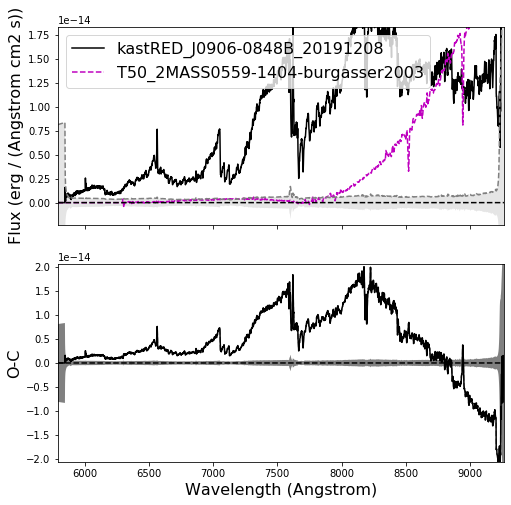

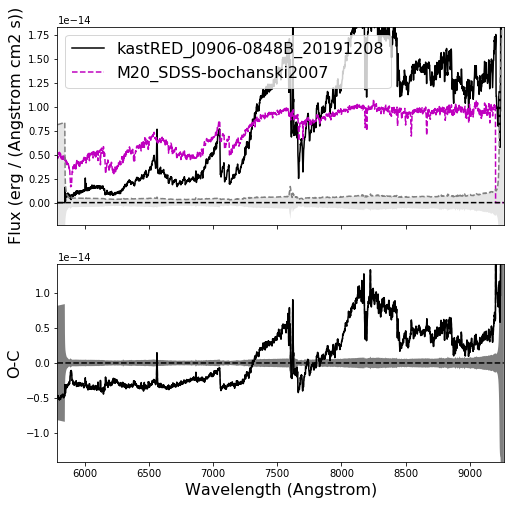

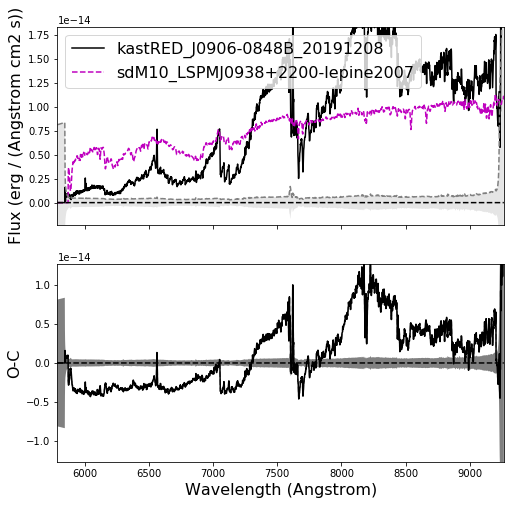

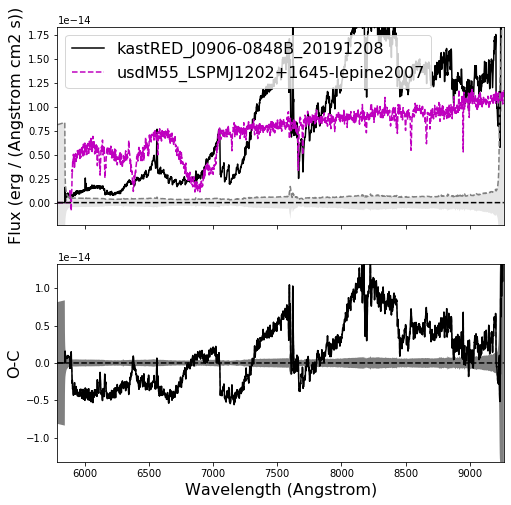

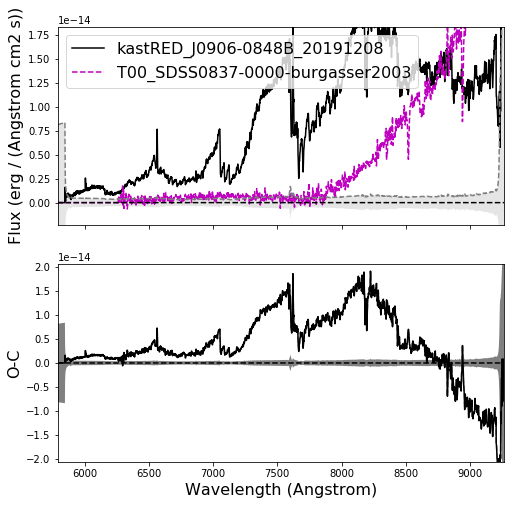

...

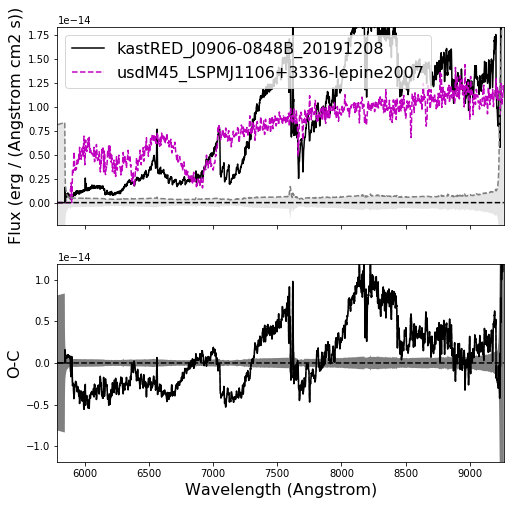

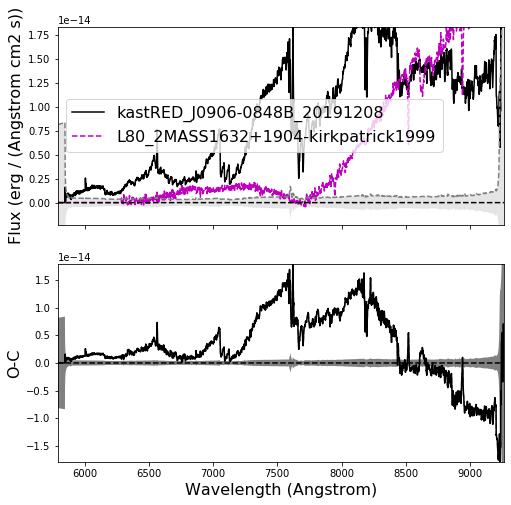

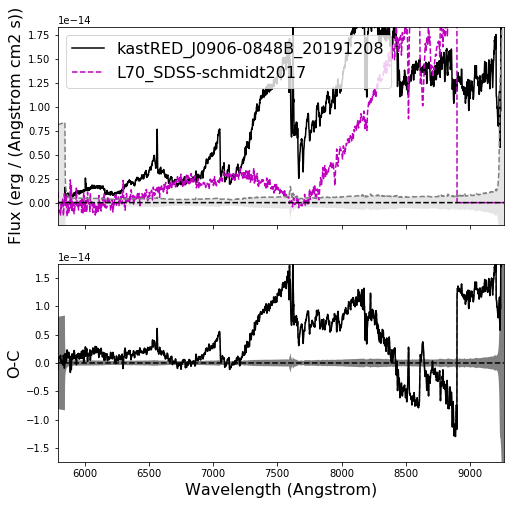

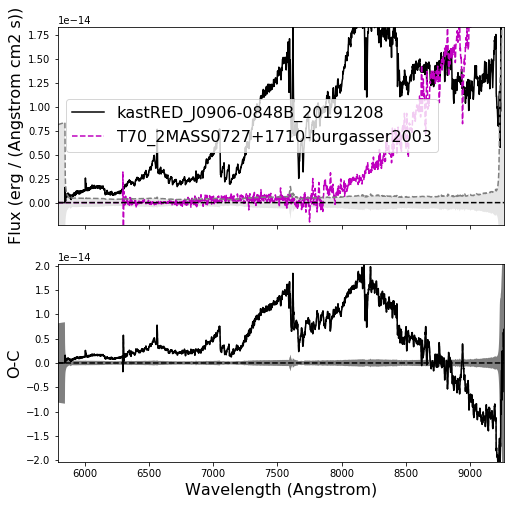

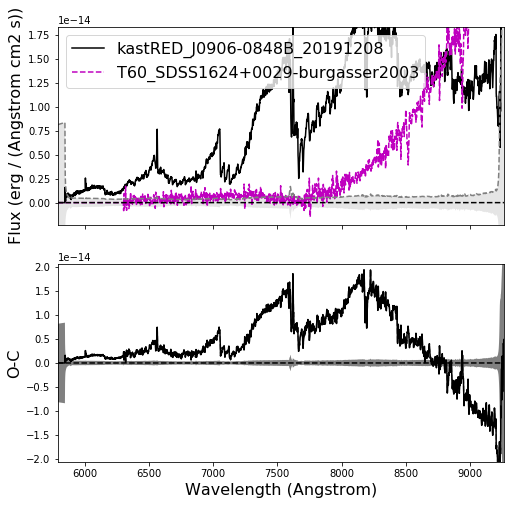

In [17]:
for stand in STANDARDS:
    stat, scale = kastredux.compareSpectra_simple(sp1, stand, plot=True)

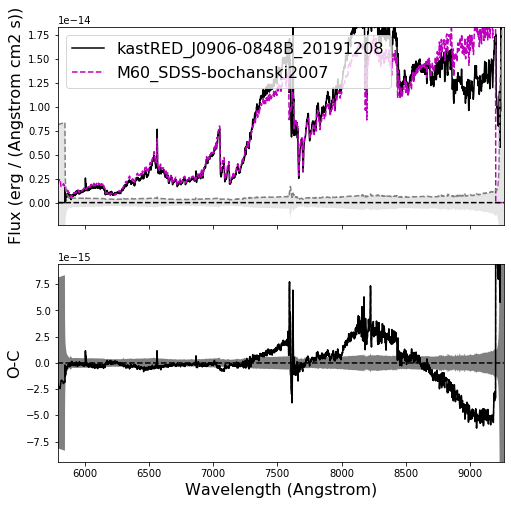

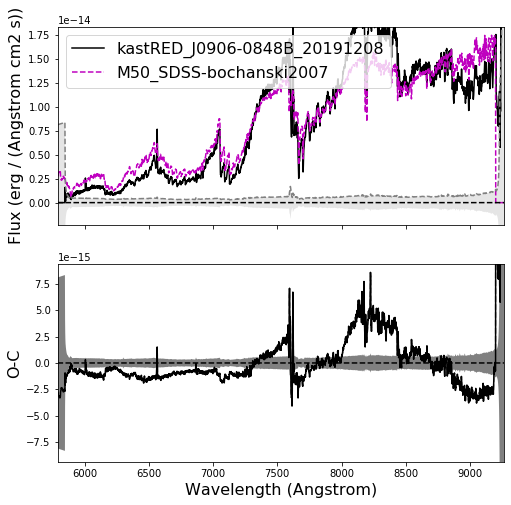

In [18]:
for i in range(len(STATS)):
    if STATS[i] < 30000:
        stat, scale = kastredux.compareSpectra_simple(sp1, STANDARDS[i], plot=True)
        

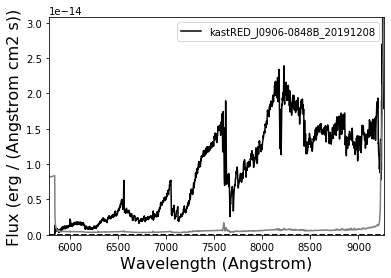

In [5]:
sp1.plot()

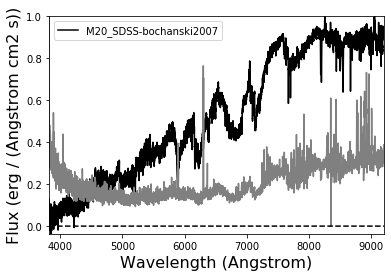

In [9]:
stand1.plot()

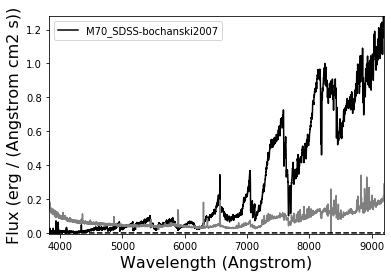

In [10]:
stand2.plot()

0.22978852199690908


(1224.8452906758748, 1.0365752692075261e-14)

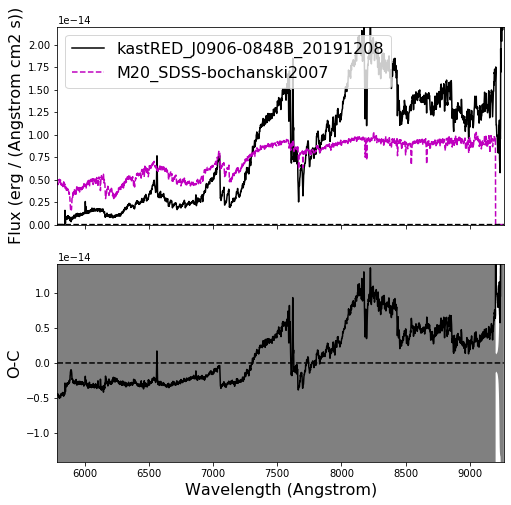

In [10]:
kastredux.compareSpectra(sp1, stand1, plot=True)

0.07665725877536597


(1224.8452906758748, 1.9970201178816747e-14)

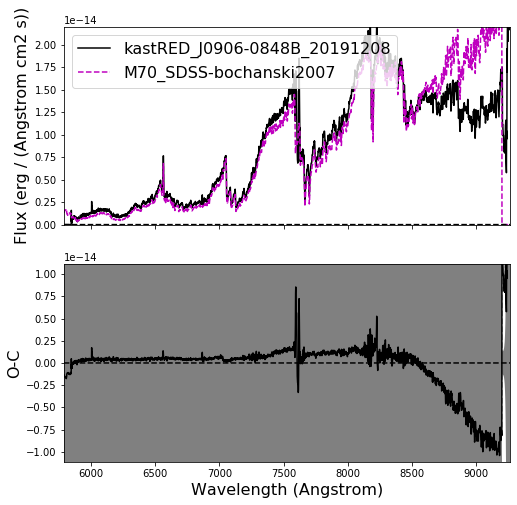

In [11]:
kastredux.compareSpectra(sp1, stand2 ,plot=True)

In [7]:
print('chi2: {}; name: {}'.format(test_compareSpectra(sp1, stand1)[0], stand1.name))
print('chi2: {}; name: {}'.format(test_compareSpectra(sp1, stand2)[0], stand2.name))
print('chi2: {}; name: {}'.format(test_compareSpectra(sp1, stand3)[0], stand3.name))

print(test_compareSpectra(sp1, stand1)[0] == test_compareSpectra(sp1, stand2)[0])

chi2: 1224.8452906758748; name: M20_SDSS-bochanski2007
chi2: 1224.8452906758748; name: M70_SDSS-bochanski2007
chi2: 1224.8452906758748; name: M00_SDSS-bochanski2007
True


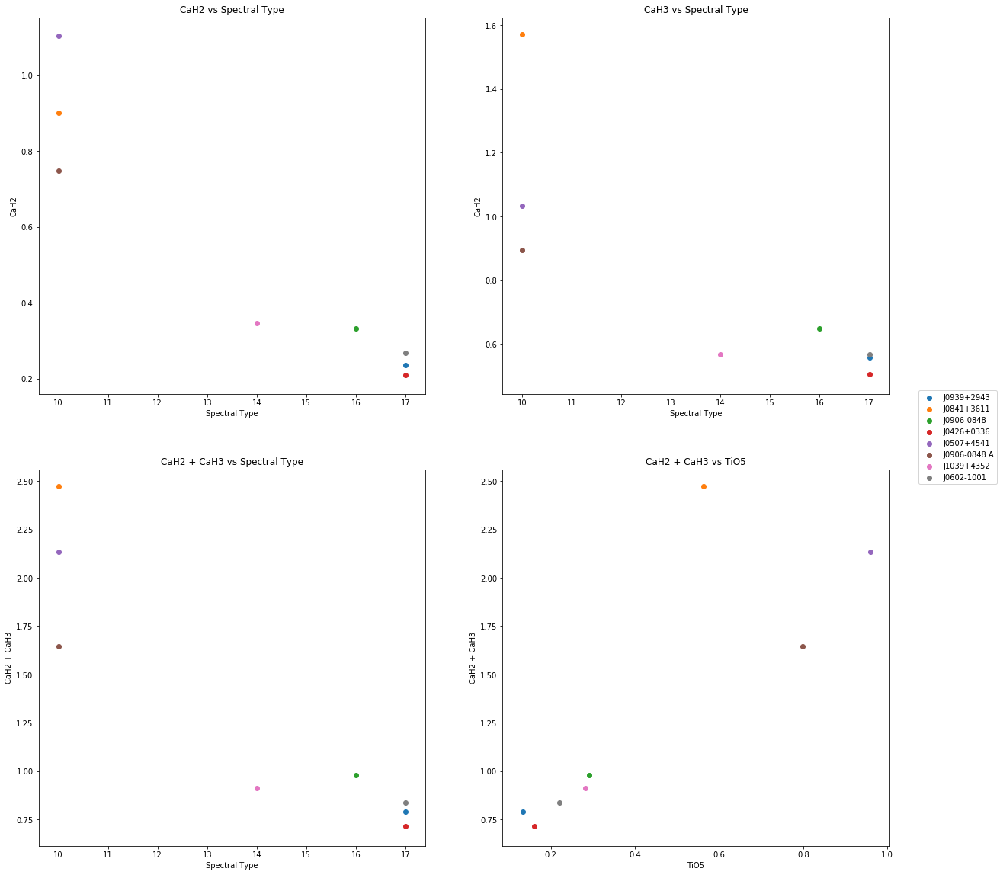

In [17]:
fig, axs = plt.subplots(2, 2, figsize=[20,20])

for spec in SPECTRA:
    spt, minimal_name, minimal_chi2, minimal_scale = classify_by_template(spec)
    
    spt_n = typeToNum(spt)
    
    indices = measure_index_set(spec, ref='lepine2007')
    
    CaH2 = indices['CaH2'][0]
    CaH3 = indices['CaH3'][0]
    
    TiO5 = indices['TiO5'][0]
    
    CaH = CaH2 + CaH3
    
    axs[0,0].scatter(spt_n, CaH2)
    axs[0,1].scatter(spt_n, CaH3)
    axs[1,0].scatter(spt_n, CaH, label=spec.name)
    
    axs[1,1].scatter(TiO5, CaH)
    
axs[0,0].set_title('CaH2 vs Spectral Type')
axs[0,0].set_xlabel('Spectral Type')
axs[0,0].set_ylabel('CaH2')
axs[0,1].set_title('CaH3 vs Spectral Type')
axs[0,1].set_xlabel('Spectral Type')
axs[0,1].set_ylabel('CaH2')
axs[1,0].set_title('CaH2 + CaH3 vs Spectral Type')
axs[1,0].set_xlabel('Spectral Type')
axs[1,0].set_ylabel('CaH2 + CaH3')
axs[1,1].set_title('CaH2 + CaH3 vs TiO5')
axs[1,1].set_xlabel('TiO5')
axs[1,1].set_ylabel('CaH2 + CaH3')
    
fig.legend(loc=7)
    
fig.show()
    

In [8]:
flx1 = sp1.flux.value

wave = sp1.wave.value

var1 = sp1.unc.value
var2 = stand1.unc.value

f2interp = kastredux.interp1d(stand1.wave.value, stand1.flux.value,bounds_error=False,fill_value=0.)
u2interp = kastredux.interp1d(stand1.wave.value,stand1.unc.value,bounds_error=False,fill_value=0.)

flx2 = f2interp(wave)
var2 = u2interp(wave)

vartot = var1**2 + var2**2

scale_fac = np.nansum(flx1*flx2/vartot) / np.nansum((flx2**2)/vartot)

In [9]:
scale_fac

1.0365752692075261e-14

In [10]:
chi2_1 = numpy.nansum((flx1-scale_fac * flx2)**2/vartot)
chi2_1

1224.8452906758748

In [11]:
flx1 = sp1.flux.value

wave = sp1.wave.value

var1 = sp1.unc.value
var3 = stand2.unc.value

f3interp = kastredux.interp1d(stand2.wave.value, stand2.flux.value,bounds_error=False,fill_value=0.)
u3interp = kastredux.interp1d(stand2.wave.value,stand2.unc.value,bounds_error=False,fill_value=0.)

flx3 = f3interp(wave)
var3 = u2interp(wave)

vartot = var1**2 + var3**2

scale_fac = np.nansum(flx1*flx3/vartot) / np.nansum((flx3**2)/vartot)

In [12]:
scale_fac

1.8584930262128095e-14

In [13]:
chi2_2 = numpy.nansum((flx1-scale_fac * flx3)**2/vartot)
chi2_2

1224.8452906758748

In [14]:
flx1 = sp1.flux.value

wave = sp1.wave.value

var1 = sp1.unc.value
var4 = stand3.unc.value

f4interp = kastredux.interp1d(stand3.wave.value, stand3.flux.value,bounds_error=False,fill_value=0.)
u4interp = kastredux.interp1d(stand3.wave.value,stand3.unc.value,bounds_error=False,fill_value=0.)

flx4 = f4interp(wave)
var4 = u4interp(wave)

vartot = var1**2 + var4**2

scale_fac = np.nansum(flx1*flx4/vartot) / np.nansum((flx4**2)/vartot)

In [15]:
scale_fac

1.1443071981611523e-14

In [16]:
chi2_3 = numpy.nansum((flx1-scale_fac * flx4)**2/vartot)
chi2_3

1224.8452906758748

In [94]:
vartot = numpy.nanmax([sp1.variance.value,f4interp(sp1.wave.value)],axis=0)

scale_factor = numpy.nansum(sp1.flux.value*f4interp(sp1.wave.value)/vartot)/numpy.nansum(f4interp(sp1.wave.value)*f4interp(sp1.wave.value)/vartot)

scale_factor

9.675560224619643e-15

In [95]:

vartot = numpy.nanmax([sp1.variance.value,f4interp(sp1.wave.value)*(scale_factor**2)],axis=0)

stat_4 = numpy.nansum((sp1.flux.value-f4interp(sp1.wave.value)*scale_factor)**2/vartot)
stat_4

2191.5843499045973

In [98]:
for stand in STANDARDS:
    if np.all(np.isnan(stand.unc.value)):
        print(stand.name)

T50_2MASS0559-1404-burgasser2003
sdM10_LSPMJ0938+2200-lepine2007
usdM55_LSPMJ1202+1645-lepine2007
T00_SDSS0837-0000-burgasser2003
L30_2MASS1146+2230-kirkpatrick1999
sdM50_LSPMJ1448+6148-lepine2007
sdM20_LSPMJ1014+4354-lepine2007
L50_2MASS1228-1547-kirkpatrick1999
usdM20_LSPMJ0440+1538-lepine2007
esdK70_LSPMJ0448+2206-lepine2007
usdM75_LSPMJ0822+1700-lepine2007
T80_2MASS0415-0935-burgasser2003
T20_SDSS1254-0122-burgasser2003
usdM00_LSPMJ0621+6558-lepine2007
esdM30_LSPMJ1337+3501-lepine2007
L00_2MASS0345+2540-kirkpatrick1999
esdM40_LSPMJ1340+1902-lepine2007
esdM50_LSPMJ0843+0600-lepine2007
L90_2MASS0255-4700-kirkpatrick1999
usdK70_LSPMJ1815+2029-lepine2007
sdM00_LSPMJ0202+0542-lepine2007
L10_2MASS1439+1929-kirkpatrick1999
sdM30_LSPMJ1144+1351-lepine2007
usdM40_LSPMJ0519+6443-lepine2007
L70_2MASS0205-1159-kirkpatrick1999
usdM60_LSPMJ0621+1219-lepine2007
esdM00_LSPMJ2319+5647-lepine2007
esdM65_LSPMJ0830+3612-lepine2007
esdM10_LSPMJ0814+1501-lepine2007
sdM80_LSPMJ1425+7102-lepine2007
esdM20

In [81]:
def generateMask(wv,mask=[],mask_range=[-99.,-99.],mask_telluric=False,mask_standard=False,**kwargs):
    '''
    :Purpose: Generates a mask array based on wavelength vector and optional inputs on what to mask.

    :Output: A mask array, where 0 = OK and 1 = ignore

    :Example:
    '''

# parameter check
    wave = copy.deepcopy(wv)
    if isinstance(wv,kastredux.Spectrum): wave = wv.wave
    if not kastredux.isUnit(wv): wave = wave*DEFAULT_WAVE_UNIT
    if not isinstance(wave.value,list) and not isinstance(wave.value,numpy.ndarray):
        raise ValueError('\nInput parameter should be an array of wavelengths; you passed {}'.format(wv))

# generate initial mask 
    if len(mask) == 0:
        mask = numpy.zeros(len(wave))
    mask = numpy.array(mask)
    if len(mask) != len(wave):
        raise ValueError('\nInitial mask of length {} is not the same as wave array of len {}'.format(len(mask),len(wave)))


    
# a standard masking
    mask_ranges = kwargs.get('mask_ranges',[mask_range])
    '''
    Standard and Telluric masking will have to be different
    for kast; assumes microns, NIR ranges for tellurics,
    and NIR ranges for A star standards
    if mask_standard == True:
        mask_telluric = True
        mask_ranges.append([0.,0.8]*DEFAULT_WAVE_UNIT)        # standard short cut

# mask telluric bands
    if mask_telluric == True:
#        mask_ranges.append([0.,0.65]*DEFAULT_WAVE_UNIT)        # meant to clear out short wavelengths
        mask_ranges.append([1.35,1.42]*DEFAULT_WAVE_UNIT)
        mask_ranges.append([1.8,1.92]*DEFAULT_WAVE_UNIT)
        mask_ranges.append([2.45,99.]*DEFAULT_WAVE_UNIT)        # meant to clear out long wavelengths
        
        
    '''

# make sure quantities are all correct
    mask_ranges_apply = []
    for i,m in enumerate(mask_ranges):
        if not kastredux.isUnit(m): m = m*wave.unit
        m.to(wave.unit)
        mask_ranges_apply.append(m)

# apply to mask
    for m in mask_ranges_apply:
        mask[numpy.where(numpy.logical_and(wave.value >= numpy.nanmin(m.value),wave.value <= numpy.nanmax(m.value)))]= 1

    return mask

In [82]:
def test_compareSpectra(s1, s2, statistic='chisqr',scale=True, novar2=True, plot=False, verbose=False, **kwargs):
    '''
    
    NEED TO MODIFY HEADER COMMENT FOR KAST
    
    
    :Purpose: 

        Compare two spectra against each other using a pre-selected statistic. 
        Returns the value of the desired statistic as well as the optimal scale factor. 

    :Required Parameters: 

        :param sp1: First spectrum class object, which sets the wavelength scale
        :param sp2: Second spectrum class object, interpolated onto the wavelength scale of sp1

    :Optional Parameters: 

        :param: statistic = 'chisqr': string defining which statistic to use in comparison; available options are (also stat):

            - *'chisqr'* or *'chi'*: compare by computing chi squared value (requires spectra with noise values)
            - *'stddev'*: compare by computing standard deviation
            - *'stddev_norm'*: compare by computing normalized standard deviation
            - *'absdev'*: compare by computing absolute deviation

        :param: scale = True: If True, finds the best scale factor to minimize the statistic
        :param: fit_ranges = [range of first spectrum]: 2-element array or nested array of 2-element arrays specifying the wavelength ranges to be used for the fit, assumed to be measured in microns; this is effectively the opposite of mask_ranges (also fit_range, fitrange, fitrng, comprange, comprng)
        :param: mask = numpy.zeros(): Array specifiying which wavelengths to mask; must be an array with length equal to the wavelength scale of ``sp1`` with only 0 (OK) or 1 (mask).
        :param: mask_ranges = None: Multi-vector array setting wavelength boundaries for masking data, assumed to be in microns
        :param: mask_telluric = False: Set to True to mask pre-defined telluric absorption regions
        :param: mask_standard = False: Like ``mask_telluric``, with a slightly tighter cut of 0.80-2.35 micron
        :param: weights = numpy.ones(): Array specifying the weights for individual wavelengths; must be an array with length equal to the wavelength scale of ``sp1``; need not be normalized
        :param: novar2 = True: Set to True to compute statistic without considering variance of ``sp2``
        :param: plot = False: Set to True to plot ``sp1`` with scaled ``sp2`` and difference spectrum overlaid
        :param: verbose = False: Set to True to report things as you're going along

    :Output: 
        statistic and optimal scale factor for the comparison

    :Example:
        >>> import splat
        >>> import numpy
        >>> sp1 = splat.getSpectrum(shortname = '2346-3153')[0]
            Retrieving 1 file
        >>> sp2 = splat.getSpectrum(shortname = '1421+1827')[0]
            Retrieving 1 file
        >>> sp1.normalize()
        >>> sp2.normalize()    
        >>> splat.compareSpectra(sp1, sp2, statistic='chisqr')
            (<Quantity 19927.74527822856>, 0.94360732593223595)
        >>> splat.compareSpectra(sp1, sp2, statistic='stddev')
            (<Quantity 3.0237604611215705 erg2 / (cm4 micron2 s2)>, 0.98180983971456637)
        >>> splat.compareSpectra(sp1, sp2, statistic='absdev')
            (<Quantity 32.99816249949072 erg / (cm2 micron s)>, 0.98155779612333172)
        >>> splat.compareSpectra(sp1, sp2, statistic='chisqr', novar2=False)
            (<Quantity 17071.690727945213>, 0.94029474635786015)
    '''

    sp1 = copy.deepcopy(s1)
    sp2 = copy.deepcopy(s2)
    
# make sure spectra are on the same wavelength and flux unit scales
    if sp1.wave.unit != sp2.wave.unit: sp2.toWaveUnit(sp1.wave.unit)
    if sp1.flux.unit != sp2.flux.unit: sp2.toFluxUnit(sp1.flux.unit)

    fit_ranges = kwargs.get('fit_ranges',[[numpy.nanmin(sp1.wave),numpy.nanmax(sp1.wave)]])
    fit_ranges = kwargs.get('fit_range',fit_ranges)
    fit_ranges = kwargs.get('fitrange',fit_ranges)
    fit_ranges = kwargs.get('fitrng',fit_ranges)
    fit_ranges = kwargs.get('comprange',fit_ranges)
    fit_ranges = kwargs.get('comprng',fit_ranges)
#    mask_ranges = kwargs.get('mask_ranges',[])
#    mask_standard = kwargs.get('mask_standard',False)
#    mask_telluric = kwargs.get('mask_telluric',mask_standard)
    var_flag = novar2
    if numpy.isnan(numpy.max(sp2.variance.value)) == True: var_flag = True
    if numpy.isnan(numpy.max(sp1.variance.value)) == True: var_flag = False
    statistic = kwargs.get('stat',statistic)
    minreturn = 1.e-60
    scale_factor = 1.

# create interpolation function for second spectrum
    f = kastredux.interp1d(sp2.wave.value,sp2.flux.value,bounds_error=False,fill_value=0.)
    if var_flag:
        v = kastredux.interp1d(sp2.wave.value,[numpy.nan for s in sp2.wave],bounds_error=False,fill_value=numpy.nan)
    else:
        v = kastredux.interp1d(sp2.wave.value,sp2.variance.value,bounds_error=False,fill_value=numpy.nan)
# total variance - funny form to cover for nans
    vtot = numpy.nanmax([sp1.variance.value,v(sp1.wave.value)],axis=0)

# manage fit ranges and generate fit mask
    if len(fit_ranges) == 0: fit_ranges = [[numpy.nanmin(sp1.wave),numpy.nanmax(sp1.wave)]]
    if len(fit_ranges) == 2 and not isinstance(fit_ranges[0],list): fit_ranges = [fit_ranges]
    
    '''
    for i,m in enumerate(fit_ranges):
        if not kastredux.isUnit(m):
            fit_ranges[i] = (m*u.micron).to(sp1.wave.unit)
    '''
    fit_mask = kwargs.get('fit_mask',1.-generateMask(sp1.wave,mask_ranges=fit_ranges))
    
# generate masking array and combine with fit mask
#    reject_mask = numpy.array(kwargs.get('mask',generateMask(sp1.wave,**kwargs)))
    reject_mask = numpy.array(kwargs.get('mask',numpy.zeros(len(sp1.wave))))
# mask flux < 0
    reject_mask[numpy.where(numpy.logical_or(sp1.flux < 0,f(sp1.wave) < 0))] = 1
    mask = numpy.clip(fit_mask+reject_mask,0,1)

# set the weights
    weights = kwargs.get('weights',numpy.ones(len(sp1.wave)))
    weights = weights*(1.-mask)

# comparison statistics
# switch to standard deviation if no uncertainty
    if numpy.isnan(numpy.nanmax(vtot)):
        statistic = 'stddev'
        if verbose==True:
            print('No uncertainties provided; using the {} statistic by default'.format(statistic))
    else:
        if verbose==True:
            print('Comparing spectra using the {} statistic'.format(statistic))

# chi^2
    if (statistic == 'chisqr' or statistic == 'chisq' or statistic == 'chi'):
# compute scale factor
        if scale == True:
            scale_factor = numpy.nansum(weights*sp1.flux.value*f(sp1.wave.value)/vtot)/ \
                numpy.nansum(weights*f(sp1.wave.value)*f(sp1.wave.value)/vtot)
# correct variance
        vtot = numpy.nanmax([sp1.variance.value,v(sp1.wave.value)*(scale_factor**2)],axis=0)
        stat = numpy.nansum(weights*(sp1.flux.value-f(sp1.wave.value)*scale_factor)**2/vtot)
        unit = sp1.flux.unit/sp1.flux.unit

# normalized standard deviation
    elif (statistic == 'stddev_norm' or statistic == 'stdev_norm'):
# compute scale factor
        if scale == True:
            scale_factor = numpy.nansum(weights*sp1.flux.value)/ \
                numpy.nansum(weights*f(sp1.wave.value))
# correct variance
        vtot = numpy.nanmax([sp1.variance.value,v(sp1.wave.value)*(scale_factor**2)],axis=0)
        stat = numpy.nansum(weights*(sp1.flux.value-f(sp1.wave.value)*scale_factor)**2)/ \
            numpy.median(sp1.flux.value)**2
        unit = sp1.flux.unit/sp1.flux.unit

# standard deviation
    elif (statistic == 'stddev' or statistic == 'stdev'):
# compute scale factor
        if scale == True:
            scale_factor = numpy.nansum(weights*sp1.flux.value*f(sp1.wave.value))/ \
                numpy.nansum(weights*f(sp1.wave.value)*f(sp1.wave.value))
# correct variance
        vtot = numpy.nanmax([sp1.variance.value,v(sp1.wave.value)*(scale_factor**2)],axis=0)
        stat = numpy.nansum(weights*(sp1.flux.value-f(sp1.wave.value)*scale_factor)**2)
        unit = sp1.flux.unit**2

# absolute deviation
    elif (statistic == 'absdev'):
# compute scale factor
        if scale == True:
            scale_factor = numpy.nansum(weights*sp1.flux.value)/ \
                numpy.nansum(weights*f(sp1.wave.value))
# correct variance
        vtot = numpy.nanmax([sp1.variance.value,v(sp1.wave.value)*(scale_factor**2)],axis=0)
        stat = numpy.nansum(weights*abs(sp1.flux.value-f(sp1.wave.value)*scale_factor))
        unit = sp1.flux.unit

# error
    else:
        print('Error: statistic {} for compareSpectra not available'.format(statistic))
        return numpy.nan, numpy.nan

    
#plotting is from splat, need to retrofit this to work with kastredux
    '''

# plot spectrum compared to best spectrum
    if plot == True:
        spcomp = sp2.copy()
        spcomp.scale(scale_factor)
        kwargs['colors'] = kwargs.get('colors',['k','r','b'])
        kwargs['title'] = kwargs.get('title',sp1.name+' vs '+sp2.name)
        from .plot import plotSpectrum
        plotSpectrum(sp1,spcomp,sp1-spcomp,labels=[sp1.name,sp2.name,'{} = {}'.format(statistic,stat)],**kwargs)
    '''

    return numpy.nanmax([stat,minreturn])*unit, scale_factor

In [ ]:
    


def measure_lepine_indices(spec):
    
    waves = spec.wave.value
    fluxes = spec.flux.value
    fluxinterp = kastredux.interp1d(waves, fluxes, bounds_error=False, fill_value=0.)
    
    minwavelength = 5000
    maxwavelength = 10000
    
    no_divisions = (maxwavelength - minwavelength) * 1000
    
    w = numpy.linspace(minwavelength, maxwavelength, no_divisions)
    
    f = fluxinterp(w)
    
    #CaH3_wave_cont = w[ (w > 7042) & (w < 7046)]
    CaH3_flux_cont = f[ (w > 7042) & (w < 7046)]
    
    #CaH3_wave_feat = w[ (w > 6960) & (w < 6990)]
    CaH3_flux_feat = f[ (w > 6960) & (w < 6990)]
    
    pcontflux = numpy.mean(CaH3_flux_cont)
    featflux = numpy.mean(CaH3_flux_feat)

    CaH3_index = numpy.divide(featflux, pcontflux)
    
    #CaH2_wave_cont = w[ (w > 7042) & (w < 7046)]
    CaH2_flux_cont = f[ (w > 7042) & (w < 7046)]
    
    #CaH2_wave_feat = w[ (w > 6814) & (w < 6846)]
    CaH2_flux_feat = f[ (w > 6814) & (w < 6846)]
    
    pcontflux = numpy.mean(CaH2_flux_cont)
    featflux = numpy.mean(CaH2_flux_feat)

    CaH2_index = numpy.divide(featflux, pcontflux)
    
    #TiO5_wave_cont = w[ (w > 7042) & (w < 7046)]
    TiO5_flux_cont = f[ (w > 7042) & (w < 7046)]

    #TiO5_wave_feat = w[ (w > 7126) & (w < 7135)]
    TiO5_flux_feat = f[ (w > 7126) & (w < 7135)]
    
    pcontflux = numpy.mean(TiO5_flux_cont)
    featflux = numpy.mean(TiO5_flux_feat)

    TiO5_index = numpy.divide(featflux , pcontflux)
    
    return [CaH3_index, CaH2_index, TiO5_index]


def measure_lepine_spt(spec):
    
    indices = measure_lepine_indices(spec)
    
    CaH3 = indices[0]
    CaH2 = indices[1]
    
    CaH = CaH2 + CaH3
    
    spt = 1.4 * CaH**2 - 10. * CaH + 12.4
    
    return spt

def measure_lepine_zeta(spec):
    
    indices = measure_lepine_indices(spec)
    
    CaH3 = indices[0]
    
    CaH2 = indices[1]
    
    TiO5 = indices[2]
    
    CaH = CaH2 + CaH3
    
    solar_TiO5 = -0.164 * CaH ** 3 + 0.670 * CaH ** 2 - 0.118 * CaH - 0.050
    
    zeta = np.divide((1 - TiO5), (1 - solar_TiO5))
    
    return zeta


In [48]:
def generate_mc(waverange, fluxrange, uncrange):
    
    waves = waverange
    fluxes = fluxrange
    uncs = uncrange

    fluxdist = numpy.random.normal(fluxes, uncs)
    
    return fluxdist


def measure_index(spec, waveranges):
    
    no_trials = 1000
    
    no_samples = 1000
    
    index_samples = []
    
    waves = spec.wave.value
    fluxes = spec.flux.value
    uncs = spec.unc.value
    
    for i in range(no_trials):
        
        index_fluxes = []
        
        fluxes_sample = generate_mc(waves, fluxes, uncs)
        
        fluxinterp = interp1d(waves, fluxes_sample, bounds_error=False, fill_value=0.)
    
        for waverange in waveranges:
            
            minwavelength = waverange[0]
            maxwavelength = waverange[1]

            no_divisions = (maxwavelength - minwavelength) * no_samples

            w = numpy.linspace(minwavelength, maxwavelength, no_divisions)

            f = fluxinterp(w)

            feature_flux = f[ (w > minwavelength) & (w < maxwavelength)]

            index_flux = np.mean(feature_flux)

            index_fluxes.append(index_flux)

        index_samples.append( index_fluxes[1] / index_fluxes[0] )
        
    index = np.mean(index_samples)
    index_unc = np.std(index_samples)
    
    return index, index_unc

In [90]:
x = 5
dx = 0.02
y = 7
dy = 0.1

f = x * y
df2 = y**2 * dx**2 + x**2 + dy**2


xsamps = np.random.normal(x, dx,10000)

ysamps = np.random.normal(y, dy,10000)

    
fsamps = xsamps * ysamps

fapprox = np.mean(fsamps)
ferr = np.std(fsamps)

print(f, np.sqrt(df2))

print(fapprox, ferr)

35 5.002959124358304
34.99933577773804 0.5239654019169419


3.877306291270667

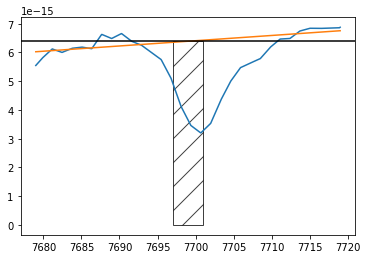

In [134]:
feature_center = 7699

feature_radius = 10
cont_radius = 20

waves = sp1.wave.value
fluxes = sp1.flux.value

feature_waves = np.linspace( feature_center - feature_radius, feature_center + feature_radius, 1000)

finterp = interp1d(waves, fluxes, bounds_error=False, fill_value=0.)

feature_flux = finterp(feature_waves)

cont_waves = np.linspace( feature_center - cont_radius, feature_center + cont_radius, 1000)

cont_f = finterp(cont_waves)

cont_fluxes = cont_f[ (cont_waves <= feature_center - feature_radius) | (cont_waves >= feature_center + feature_radius)]

cont_wv = cont_waves[ (cont_waves <= feature_center - feature_radius) | (cont_waves >= feature_center + feature_radius) ]

cont_fit = np.poly1d( np.polyfit(cont_wv, cont_fluxes, 1) )


center_wv = np.median(cont_waves)

continuum_level = cont_fit(center_wv)

width = trapz( (np.ones(len(feature_flux)) - feature_flux / continuum_level), feature_waves)

from matplotlib import patches

lower_left = feature_center - width/2

fig, ax = plt.subplots(1)
rect = patches.Rectangle( (lower_left, 0), width, continuum_level, fill=False,hatch='/', alpha=0.75)
ax.add_patch(rect)
ax.plot(cont_waves, cont_f)
ax.plot(cont_waves, cont_fit(cont_waves))
ax.axhline(continuum_level, color='k')

width

In [ ]:
def measure_index_set(spec, ref='lepine2007', index_info=None, plot=False, no_trials=1000):
    
    indices_keyword = 'indices'
    continuum_keyword = 'continuum'
    feature_keyword = 'feature'
    method_keyword = 'method'
    sample_keyword = 'sample'
    
    #leipine (2007)
    if 'lepine2007' in ref:
        index_info = {'indices': {\
        'CaH3': {'feature': [[6960,6990]],\
                 'continuum': [[7042,7046]],\
                 'method': 'ratio',\
                 'sample': 'average'},\
        'CaH2': {'feature': [[6814, 6846]],\
                 'continuum': [[7042, 7046]],\
                 'method': 'ratio',\
                 'sample': 'average'},\
        'TiO5': {'feature': [[7126,7135]],\
                 'continuum': [[7042,7046]],\
                 'method': 'ratio',\
                 'sample': 'average'}
        }}
    
    #lepine (2003)
    elif 'lepine2003' in ref:
        index_info = {'indices': {\
        'CaH1': {'feature': [[6380,6390]],\
                 'continuum': [[6410,6420], [6345, 6355]],\
                 'method': 'avdenom',\
                 'sample': 'average'},\
        'CaH2': {'feature': [[6814, 6846]],\
                 'continuum': [[7042, 7046]],\
                 'method': 'ratio',\
                 'sample': 'average'},\
        'CaH3': {'feature': [[6960,6990]],\
                 'continuum': [[7042,7046]],\
                 'method': 'ratio',\
                 'sample': 'average'},\
        'TiO5': {'feature': [[7126,7135]],\
                 'continuum': [[7042,7046]],\
                 'method': 'ratio',\
                 'sample': 'average'},\
        'VO1': {'feature': [[7430, 7470]],\
                 'continuum': [[7550,7570]],\
                 'method': 'ratio',\
                 'sample': 'average'},\
        'TiO6': {'feature': [[7550,7570]],\
                 'continuum': [[7745,7765]],\
                 'method': 'ratio',\
                 'sample': 'average'},\
        'VO2': {'feature': [[7920, 7960]],\
                 'continuum': [[8440, 8470]],\
                 'method': 'ratio',\
                 'sample': 'average'},\
        'TiO7': {'feature': [[8440, 8470]],\
                 'continuum': [[8400, 8420]],\
                 'method': 'ratio',\
                 'sample': 'average'},\
        'Color-M': {'feature': [[8105, 8155]],\
                 'continuum': [[6510, 6560]],\
                 'method': 'ratio',\
                 'sample': 'average'},\
        }}
    
    #gizis (1997)
    elif 'gizis' in ref:
        index_info = {'indices': {\
        'TiO5': {'feature': [[7126, 7135]],\
                 'continuum': [[7042, 7046]],\
                 'method': 'ratio',\
                 'sample': 'average'},\
        'CaH1': {'feature': [[6380, 6390]],\
                 'continuum': [[6345, 6355], [6410, 6420]],\
                 'method': 'avdenom',\
                 'sample': 'average'},\
        'CaH2': {'feature': [[6814, 6846]],\
                 'continuum': [[7042, 7046]],\
                 'method': 'ratio',\
                 'sample': 'average'},\
        'CaH3': {'feature': [[6960, 6990]],\
                 'continuum': [[7042, 7046]],\
                 'method': 'ratio',\
                 'sample': 'average'}
        }}
     
    #reid (1995)
    elif 'reid' in ref:
        index_info = {'indices': {\
        'TiO1': {'feature': [[6718, 6723]],\
                 'continuum': [[6703, 6708]],\
                 'method': 'ratio',\
                 'sample': 'average'},\
        'TiO2': {'feature': [[7058, 7061]],\
                 'continuum': [[7043, 7046]],\
                 'method': 'ratio',\
                 'sample': 'average'},\
        'TiO3': {'feature': [[7092, 7097]],\
                 'continuum': [[7079, 7084]],\
                 'method': 'ratio',\
                 'sample': 'average'},\
        'TiO4': {'feature': [[7130, 7135]],\
                 'continuum': [[7115, 7120]],\
                 'method': 'ratio',
                 'sample': 'average'},\
        'TiO5': {'feature': [[7126, 7135]],\
                 'continuum': [[7042, 7046]],\
                 'method': 'ratio',\
                 'sample': 'average'},\
        'CaH1': {'feature': [[6380, 6390]],\
                 'continuum': [[6345, 6355], [6410, 6420]],\
                 'method': 'avdenom',
                 'sample': 'average'},\
        'CaH2': {'feature': [[6814, 6846]],\
                 'continuum': [[7042, 7046]],\
                 'method': 'ratio',\
                 'sample': 'average'},\
        'CaH3': {'feature': [[6960, 6990]],\
                 'continuum': [[7042, 7046]],\
                 'method': 'ratio',\
                 'sample': 'average'},\
        'CaOH': {'feature': [[6230, 6240]],\
                 'continuum': [[6345, 6354]],\
                 'method': 'ratio',\
                 'sample': 'average'},\
        
        }}
        
    #kirkpatrick (1999)
    elif 'kirkpatrick' in ref:
        index_info = {'indices': {\
        'Rb-a': {'feature': [[7775.2, 7785.2], [7815.2, 7825.2]],\
                 'continuum': [[7795.2, 7805.2]],\
                 'method': 'avnum',\
                 'sample': 'integrate'},\
        'Rb-b': {'feature': [[7922.6, 7932.6], [7962.6, 7972.6]],\
                 'continuum': [[7942.6, 7952.6]],\
                 'method': 'avnum',\
                 'sample': 'integrate'},\
        'Na-a': {'feature': [[8153.3, 8163.3]],\
                 'continuum': [[8178.3, 8188.3]],\
                 'method': 'ratio',\
                 'sample': 'integrate'},\
        'Na-b': {'feature': [[8153.3, 8183.3]],\
                 'continuum': [[8189.8, 8199.8]],\
                 'method': 'ratio',\
                 'sample': 'integrate'},\
        'Cs-a': {'feature': [[8496.1, 8506.1], [8536.1, 8546.1]],\
                 'continuum': [[8516.1, 8526.1]],\
                 'method': 'avnum',\
                 'sample': 'integrate'},\
        'Cs-b': {'feature': [[8918.5, 8928.5], [8958.3, 8968.3]],\
                 'continuum': [[8938.5, 8948.3]],\
                 'method': 'avnum',\
                 'sample': 'integrate'},\
        'TiO-a': {'feature': [[7033.0, 7048.0]],\
                 'continuum': [[7958.0, 7973.0]],\
                 'method': 'ratio',\
                 'sample': 'integrate'},\
        'TiO-b': {'feature': [[8400.0, 8415.0]],\
                 'continuum': [[8435.0, 8470.0]],\
                 'method': 'ratio',\
                 'sample': 'integrate'},\
        'VO-a': {'feature': [[7350.0, 7370.0], [7550.0, 7570.0]],\
                 'continuum': [[7430.0, 7470.0]],\
                 'method': 'sumnum',\
                 'sample': 'integrate'},\
        'VO-b': {'feature': [[7860.0, 7880.0], [8080.0, 8100.0]],\
                 'continuum': [[7960.0, 8000.0]],\
                 'method': 'sumnum',\
                 'sample': 'integrate'},\
        'CrH-a': {'feature': [[8580.0, 8600.0]],\
                 'continuum': [[8621.0, 8641.0]],\
                 'method': 'ratio',\
                 'sample': 'integrate'},\
        'CrH-b': {'feature': [[9940.0, 9960.0]],\
                 'continuum': [[9970.0, 9990.0]],\
                 'method': 'ratio',\
                 'sample': 'integrate'},\
        'FeH-a': {'feature': [[8660.0, 8680.0]],\
                 'continuum': [[8700.0, 8720.0]],\
                 'method': 'ratio',\
                 'sample': 'integrate'},\
        'FeH-b': {'feature': [[9863.0, 9883.0]],\
                 'continuum': [[9908.0, 9928.0]],\
                 'method': 'ratio',\
                 'sample': 'integrate'},\
        'Color-a': {'feature': [[9800.0, 9850.0]],\
                 'continuum': [[7300.0, 7350.0]],\
                 'method': 'ratio',\
                 'sample': 'integrate'},\
        'Color-b': {'feature': [[9800.0, 9850.0]],\
                 'continuum': [[7000.0, 7050.0]],\
                 'method': 'ratio',\
                 'sample': 'integrate'},\
        'Color-c': {'feature': [[9800.0, 9850.0]],\
                 'continuum': [[8100.0, 8150.0]],\
                 'method': 'ratio',\
                 'sample': 'integrate'},\
        'Color-d': {'feature': [[9675.0, 9875.0]],\
                 'continuum': [[7350.0, 7550.0]],\
                 'method': 'ratio',\
                 'sample': 'integrate'},\
        
        }}
        
    #burgasser (2003)
    elif 'burgasser' in ref:
        index_info = {'indices': {\
        'CsI(A)': {'feature': [[8496.1, 8506.1], [8536.1, 8546.1]],\
                 'continuum': [[8516.1, 8626.1]],\
                 'method': 'sumnum_twicedenom',\
                 'sample': 'average'},\
        'CsI(B)': {'feature': [[8918.5, 8928.5], [8958.3, 8968.3]],\
                 'continuum': [[8938.5, 8948.3]],\
                 'method': 'sumnum_twicedenom',\
                 'sample': 'average'},\
        'H2O': {'feature': [[9220, 9240]],\
                 'continuum': [[9280, 9300]],\
                 'method': 'ratio',\
                 'sample': 'integrate'},\
        'CrH(A)': {'feature': [[8560, 8600]],\
                 'continuum': [[8610, 8650]],\
                 'method': 'ratio',\
                 'sample': 'integrate'},\
        'CrH(B)': {'feature': [[9855, 9885]],\
                 'continuum': [[9970, 10000]],\
                 'method': 'ratio',\
                 'sample': 'integrate'},\
        'FeH(A)': {'feature': [[8560, 8600]],\
                 'continuum': [[8685, 8725]],\
                 'method': 'ratio',\
                 'sample': 'integrate'},\
        'FeH(B)': {'feature': [[9855, 9885]],\
                 'continuum': [[9905, 9935]],\
                 'method': 'ratio',\
                 'sample': 'integrate'},\
        'Color-e': {'feature': [[9140, 9240]],\
                 'continuum': [[8400, 8500]],\
                 'method': 'ratio',\
                 'sample': 'average'},\
        }}
        
    #martin (1999)
    elif 'martin' in ref:
                index_info = {'indices': {\
        'PC3': {'feature': [[8230, 8270]],\
                 'continuum': [[7540, 7580]],\
                 'method': 'ratio',\
                 'sample': 'integrate'},\
        'PC6': {'feature': [[9090, 9130]],\
                 'continuum': [[6500, 6540]],\
                 'method': 'ratio',\
                 'sample': 'integrate'},\
        'CrH1': {'feature': [[8560, 8600]],\
                 'continuum': [[8610, 8650]],\
                 'method': 'ratio',\
                 'sample': 'integrate'},\
        'CrH2': {'feature': [[9840, 9880]],\
                 'continuum': [[9970, 10010]],\
                 'method': 'ratio',\
                 'sample': 'integrate'},\
        'FeH1': {'feature': [[8560, 8600]],\
                 'continuum': [[8685, 8725]],\
                 'method': 'ratio',\
                 'sample': 'integrate'},\
        'FeH2': {'feature': [[9840, 9880]],\
                 'continuum': [[9900, 9940]],\
                 'method': 'ratio',\
                 'sample': 'integrate'},\
        'H2O1': {'feature': [[9190, 9230]],\
                 'continuum': [[9280, 9320]],\
                 'method': 'ratio',\
                 'sample': 'integrate'},\
        'TiO1': {'feature': [[7000, 7040]],\
                 'continuum': [[7060, 7100]],\
                 'method': 'ratio',\
                 'sample': 'integrate'},\
        'TiO2': {'feature': [[8380, 8420]],\
                 'continuum': [[8440, 8480]],\
                 'method': 'ratio',\
                 'sample': 'integrate'},\
        'VO1': {'feature': [[7540, 7580]],\
                 'continuum': [[7420, 7460]],\
                 'method': 'ratio',\
                 'sample': 'integrate'},\
        'VO2': {'feature': [[7990, 8030]],\
                 'continuum': [[7900, 7940]],\
                 'method': 'ratio',\
                 'sample': 'integrate'},\
        }}
        
    names = list(index_info[indices_keyword])
    
    result = {}
    for n in names:
        
        waves = spec.wave.value
        flx = spec.flux.value
        unc = spec.unc.value
        
        #measuring the value here
        
        index = measure_index(waves, flx,\
         index_info[indices_keyword][n][continuum_keyword],\
         index_info[indices_keyword][n][feature_keyword],\
         index_info[indices_keyword][n][method_keyword],\
         index_info[indices_keyword][n][sample_keyword], plot, name=n)
        
        #doing MC here for error
        
        index_samples = []
        
        
        for i in range(no_trials):
            flxdist = np.random.normal(flx, unc)
            
            index_sample = measure_index(waves, flxdist,\
             index_info[indices_keyword][n][continuum_keyword],\
             index_info[indices_keyword][n][feature_keyword],\
             index_info[indices_keyword][n][method_keyword],\
             index_info[indices_keyword][n][sample_keyword])
            
            index_samples.append(index_sample)
            

        err = np.std(index_samples)
        
        result[n] = (index, err)
        
    return result